In [1]:
#mount drive
from google.colab import drive
drive.mount('/content/MyDrive')

Mounted at /content/MyDrive


In [2]:
import os
import torch
import joblib
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from scipy.io import wavfile
from sklearn.metrics import mean_squared_error
import statistics
from scipy.signal import savgol_filter, butter, filtfilt

class Config:
    def __init__(self, **kwargs):
        self.batch_size = kwargs.get('batch_size', 16)
        self.epochs = kwargs.get('epochs', 10)
        self.lr = kwargs.get('lr', 0.001)
        self.channels_imu_acc = kwargs.get('channels_imu_acc', [])
        self.channels_imu_acc_test = kwargs.get('channels_imu_acc_test', [])
        self.channels_imu_gyr_test = kwargs.get('channels_imu_gyr_test', [])
        self.channels_imu_gyr = kwargs.get('channels_imu_gyr', [])
        self.channels_joints = kwargs.get('channels_joints', [])
        self.channels_emg = kwargs.get('channels_emg', [])
        self.seed = kwargs.get('seed', 42)
        self.data_folder_name = kwargs.get('data_folder_name', 'default_data_folder_name')
        self.dataset_root = kwargs.get('dataset_root', 'default_dataset_root')
        self.dataset_train_name = kwargs.get('dataset_train_name', 'train')
        self.dataset_test_name = kwargs.get('dataset_test_name', 'test')
        self.window_length = kwargs.get('window_length', 100)
        self.window_overlap = kwargs.get('window_overlap', 0)
        self.imu_transforms = kwargs.get('imu_transforms', [])
        self.joint_transforms = kwargs.get('joint_transforms', [])
        self.emg_transforms = kwargs.get('emg_transforms', [])
        self.hidden_size = kwargs.get('hidden_size', 256)
        self.num_layers = kwargs.get('num_layers', 6)
        self.input_size = kwargs.get('input_size', 3)
        self.output_size = kwargs.get('output_size', 3)
        self.sample_rate = kwargs.get('sample_rate', 100)
        self.input_format = kwargs.get('input_format', 'csv')
        self.train_subjects = kwargs.get('train_subjects', [])
        self.test_subjects = kwargs.get('test_subjects', [])

        self.dataset_name = self.generate_dataset_name()

    def generate_dataset_name(self):
        name = f"dataset_wl{self.window_length}_ol{self.window_overlap}_train{self.train_subjects}_test{self.test_subjects}"
        return name

In [3]:
class DataSharder:
    def __init__(self, config, save_h5=False):
        self.config = config
        self.sample_rate = config.sample_rate
        self.input_format = config.input_format
        self.data_folder_path = config.data_folder_name
        self.window_length = int(config.window_length)
        self.window_overlap = int(config.window_overlap)
        self.save_h5 = save_h5

    def load_data(self):
        print(f"Training subjects: {self.config.train_subjects}")
        print(f"Testing subjects: {self.config.test_subjects}")

        if self.input_format == 'wav':
            self._process_and_save_patients_wav(self.config.train_subjects, "train")
            self._process_and_save_patients_wav(self.config.test_subjects, "test")
        elif self.input_format == 'csv':
            self._process_and_save_patients_csv(self.config.train_subjects, "train")
            self._process_and_save_patients_csv(self.config.test_subjects, "test")
        else:
            raise ValueError(f"Unsupported input format: {self.input_format}")

    def _process_and_save_patients_wav(self, patient_id_list, split):
        total_data = []
        for patient_id in tqdm(patient_id_list, desc=f"Processing {split} patients"):
            for session_index in tqdm(range(len(self.config.train_subjects)), desc=f"Processing sessions for {patient_id}", leave=False):
                imu_data, imu_sample_rate = self._load_wav_file(patient_id, session_index, "IMU")
                joints_data, joints_sample_rate = self._load_wav_file(patient_id, session_index, "JOINTS")
                emg_data, emg_sample_rate = self._load_wav_file(patient_id, session_index, "EMG")

                imu_data = self._resample_data(imu_data, imu_sample_rate)
                joints_data = self._resample_data(joints_data, joints_sample_rate)
                emg_data = self._resample_data(emg_data, emg_sample_rate)

                combined_data = torch.cat((imu_data, joints_data, emg_data), dim=1)
                total_data.append(combined_data.cpu().numpy())

        if self.save_h5:
            self._save_to_h5(total_data, split)
        else:
            for combined_data in total_data:
                self._save_windowed_data(combined_data, patient_id, session_index, split)

    def _load_wav_file(self, patient_id, session_index, file_type):
        file_path = os.path.join(self.data_folder_path, patient_id, f"run{session_index}_{file_type}.wav")
        data, sample_rate = get_data_from_wav_file(file_path)
        return torch.tensor(data, dtype=torch.float32), sample_rate

    def _resample_data(self, data, sample_rate):
        if sample_rate != self.sample_rate:
            data = torch.nn.functional.interpolate(data.unsqueeze(0), size=self.sample_rate, mode='linear').squeeze(0)
        return data

    def _process_and_save_patients_csv(self, patient_id_list, split):
        column_names = None
        for patient_id in tqdm(patient_id_list, desc=f"Processing {split} patients"):
            combined_path = os.path.join(self.data_folder_path, patient_id, "combined")
            if not os.path.exists(combined_path):
                print(f"Directory {combined_path} does not exist. Skipping patient {patient_id}.")
                continue

            patient_files = os.listdir(combined_path)
            for session_file in tqdm(patient_files, desc=f"Processing sessions for {patient_id}", leave=False):
                data = pd.read_csv(os.path.join(combined_path, session_file))
                if column_names is None:
                    column_names = data.columns.tolist()  # Convert Index to list
                data_np = data.to_numpy()
                # Pad array to fit columns if necessary
                if data_np.shape[1] < len(column_names):
                    data_np = np.pad(data_np, ((0, 0), (0, len(column_names) - data_np.shape[1])), mode='constant')
                elif data_np.shape[1] > len(column_names):
                    # Extend column names to match the data shape
                    extra_columns = [f"extra_{i}" for i in range(data_np.shape[1] - len(column_names))]
                    column_names.extend(extra_columns)

                self._save_windowed_data(pd.DataFrame(data_np, columns=column_names), patient_id, session_file.split('.')[0], split, is_csv=True)

    def _save_windowed_data(self, data, patient_id, session_id, split, is_csv=False):
        dataset_folder = os.path.join(self.config.dataset_root, self.config.dataset_name, self.config.dataset_train_name if split == "train" else self.config.dataset_test_name)
        os.makedirs(dataset_folder, exist_ok=True)

        window_size = self.window_length
        overlap = self.window_overlap
        step_size = window_size - overlap

        data_info_list = []

        for i in tqdm(range(0, len(data) - window_size + 1, step_size), desc=f"Windowing data for {patient_id}_{session_id}", leave=False):
            windowed_data = data.iloc[i:i+window_size] if is_csv else data[i:i+window_size]
            if windowed_data.shape[0] < window_size:
                continue

            windowed_data_np = windowed_data.to_numpy() if is_csv else windowed_data.cpu().numpy()

            file_name = f"{patient_id}_session_{session_id}_window_{i}_ws{window_size}_ol{overlap}.csv"
            file_path = os.path.join(dataset_folder, file_name)
            pd.DataFrame(windowed_data_np, columns=data.columns if is_csv else None).to_csv(file_path, index=False)
            data_info_list.append({"file_name": file_name, "file_path": file_path})

        data_info_df = pd.DataFrame(data_info_list)
        data_info_df.to_csv(os.path.join(self.config.dataset_root, self.config.dataset_name, f"{split}_info.csv"), index=False, mode='a', header=not os.path.exists(os.path.join(self.config.dataset_root, self.config.dataset_name, f"{split}_info.csv")))


In [4]:
class ImuJointPairDataset(Dataset):
    def __init__(self, config, split='train'):
        self.config = config
        self.split = split
        self.input_format = config.input_format
        self.channels_imu_acc = config.channels_imu_acc
        self.channels_imu_acc_test = config.channels_imu_acc_test
        self.channels_imu_gyr = config.channels_imu_gyr
        self.channels_imu_gyr_test = config.channels_imu_gyr_test
        self.channels_joints = config.channels_joints
        self.channels_emg = config.channels_emg

        dataset_name = self.config.dataset_name
        self.root_dir_train = os.path.join(self.config.dataset_root, dataset_name, self.config.dataset_train_name)
        self.root_dir_test = os.path.join(self.config.dataset_root, dataset_name, self.config.dataset_test_name)

        train_info_path = os.path.join(self.config.dataset_root, dataset_name, "train_info.csv")
        test_info_path = os.path.join(self.config.dataset_root, dataset_name, "test_info.csv")
        self.data = pd.read_csv(train_info_path) if split == 'train' else pd.read_csv(test_info_path)

        self.scaler_save_path = os.path.join(self.config.dataset_root, dataset_name, "scaler.pkl")
        self.scaler = joblib.load(self.scaler_save_path) if os.path.exists(self.scaler_save_path) else None

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        if self.split == "train":
            file_path = os.path.join(self.root_dir_train, self.data.iloc[idx, 0])
        else:
            file_path = os.path.join(self.root_dir_test, self.data.iloc[idx, 0])

        if self.input_format == "wav":
            combined_data, _ = get_data_from_wav_file(file_path)
        elif self.input_format == "csv":
            combined_data = pd.read_csv(file_path)
        else:
            raise ValueError("Unsupported input format: {}".format(self.input_format))

        imu_data_acc, imu_data_gyr, joint_data, emg_data = self._extract_and_transform(combined_data)
        windows = self._apply_windowing(imu_data_acc, imu_data_gyr, joint_data, emg_data, self.config.window_length, self.config.window_overlap)

        acc_concat = np.concatenate([w[0] for w in windows], axis=0)
        gyr_concat = np.concatenate([w[1] for w in windows], axis=0)
        joint_concat = np.concatenate([w[2] for w in windows], axis=0)
        emg_concat = np.concatenate([w[3] for w in windows], axis=0)

        return acc_concat, gyr_concat, joint_concat, emg_concat

    def _extract_and_transform(self, combined_data):
        imu_data_acc = self._extract_channels(combined_data, self.channels_imu_acc)
        imu_data_gyr = self._extract_channels(combined_data, self.channels_imu_gyr)
        joint_data = self._extract_channels(combined_data, self.channels_joints)
        emg_data = self._extract_channels(combined_data, self.channels_emg)

        combined_data = np.concatenate([imu_data_acc, imu_data_gyr, joint_data, emg_data], axis=1)
        scaled_data = combined_data

        imu_data_acc = scaled_data[:, :imu_data_acc.shape[1]]
        imu_data_gyr = scaled_data[:, imu_data_acc.shape[1]:imu_data_acc.shape[1] + imu_data_gyr.shape[1]]
        joint_data = scaled_data[:, imu_data_acc.shape[1] + imu_data_gyr.shape[1]:imu_data_acc.shape[1] + imu_data_gyr.shape[1] + joint_data.shape[1]]
        emg_data = scaled_data[:, imu_data_acc.shape[1] + imu_data_gyr.shape[1] + joint_data.shape[1]:]

        imu_data_acc = self.apply_transforms(imu_data_acc, self.config.imu_transforms)
        imu_data_gyr = self.apply_transforms(imu_data_gyr, self.config.imu_transforms)
        joint_data = self.apply_transforms(joint_data, self.config.joint_transforms)
        emg_data = self.apply_transforms(emg_data, self.config.emg_transforms)

        return imu_data_acc, imu_data_gyr, joint_data, emg_data

    def _extract_channels(self, combined_data, channels):
        if isinstance(channels, slice):
            return combined_data.iloc[:, channels].values if self.input_format == "csv" else combined_data[:, channels]
        else:
            return combined_data[channels].values if self.input_format == "csv" else combined_data[:, channels]

    def _apply_windowing(self, imu_data_acc, imu_data_gyr, joint_data, emg_data, window_length, window_overlap):
        num_samples = imu_data_acc.shape[0]
        step = window_length - window_overlap
        windows = []

        for start in range(0, num_samples - window_length + 1, step):
            end = start + window_length
            window = (
                imu_data_acc[start:end],
                imu_data_gyr[start:end],
                joint_data[start:end],
                emg_data[start:end]
            )
            windows.append(window)

        return windows

    def apply_transforms(self, data, transforms):
        for transform in transforms:
            data = transform(data)
        data = torch.tensor(data, dtype=torch.float32)
        return data


In [5]:
#prediction function
def RMSE_prediction(yhat_4,test_y, output_dim):

  s1=yhat_4.shape[0]*yhat_4.shape[1]

  test_o=test_y.reshape((s1,output_dim))
  yhat=yhat_4.reshape((s1,output_dim))




  y_1_no=yhat[:,0]
  y_2_no=yhat[:,1]
  y_3_no=yhat[:,2]
  #y_4_no=yhat[:,3]
  #y_5_no=yhat[:,4]
  #y_6_no=yhat[:,5]
  #y_7_no=yhat[:,6]
  #y_8_no=yhat[:,7]
  #y_9_no=yhat[:,8]
  #y_10_no=yhat[:,9]


  y_1=y_1_no
  y_2=y_2_no
  y_3=y_3_no
  #y_4=y_4_no
  #y_5=y_5_no
  #y_6=y_6_no
  #y_7=y_7_no



  y_test_1=test_o[:,0]
  y_test_2=test_o[:,1]
  y_test_3=test_o[:,2]
  #y_test_4=test_o[:,3]
  #y_test_5=test_o[:,4]
  #y_test_6=test_o[:,5]
  #y_test_7=test_o[:,6]
  #y_test_8=test_o[:,7]
  #y_test_9=test_o[:,8]
  #y_test_10=test_o[:,9]





  #print(y_1.shape,y_test_1.shape)


  cutoff=6
  fs=200
  order=4

  nyq = 0.5 * fs
  ## filtering data ##
  def butter_lowpass_filter(data, cutoff, fs, order):
      normal_cutoff = cutoff / nyq
      # Get the filter coefficients
      b, a = butter(order, normal_cutoff, btype='low', analog=False)
      y = filtfilt(b, a, data)
      return y



  # y_1=butter_lowpass_filter(y_1_no, cutoff, fs, order)
  # y_2=butter_lowpass_filter(y_2_no, cutoff, fs, order)
  # y_3=butter_lowpass_filter(y_3_no, cutoff, fs, order)
  # y_4=butter_lowpass_filter(y_4_no, cutoff, fs, order)
  # y_5=butter_lowpass_filter(y_5_no, cutoff, fs, order)
  # y_6=butter_lowpass_filter(y_6_no, cutoff, fs, order)
  # y_7=butter_lowpass_filter(y_7_no, cutoff, fs, order)
  #y_8=butter_lowpass_filter(y_8_no, cutoff, fs, order)
  #y_9=butter_lowpass_filter(y_9_no, cutoff, fs, order)
  #y_10=butter_lowpass_filter(y_10_no, cutoff, fs, order)




  Z_1=y_1
  Z_2=y_2
  Z_3=y_3
  #Z_4=y_4
  #Z_5=y_5
  #Z_6=y_6
  #Z_7=y_7
  #Z_8=y_8
  #Z_9=y_9
  #Z_10=y_10



  ###calculate RMSE

  rmse_1 =((np.sqrt(mean_squared_error(y_test_1,y_1))))
  rmse_2 =((np.sqrt(mean_squared_error(y_test_2,y_2))))
  rmse_3 =((np.sqrt(mean_squared_error(y_test_3,y_3))))
  #rmse_4 =((np.sqrt(mean_squared_error(y_test_4,y_4)))/(max(y_test_4)-min(y_test_4)))*100
  #rmse_5 =((np.sqrt(mean_squared_error(y_test_5,y_5)))/(max(y_test_5)-min(y_test_5)))*100
  #rmse_6 =((np.sqrt(mean_squared_error(y_test_6,y_6)))/(max(y_test_6)-min(y_test_6)))*100
  #rmse_7 =((np.sqrt(mean_squared_error(y_test_7,y_7)))/(max(y_test_7)-min(y_test_7)))*100
  #rmse_8 =((np.sqrt(mean_squared_error(y_test_8,y_8)))/(max(y_test_8)-min(y_test_8)))*100
  #rmse_9 =((np.sqrt(mean_squared_error(y_test_9,y_9)))/(max(y_test_9)-min(y_test_9)))*100
  #rmse_10 =((np.sqrt(mean_squared_error(y_test_10,y_10)))/(max(y_test_10)-min(y_test_10)))*100


  print(rmse_1)
  print(rmse_2)
  print(rmse_3)
  #print(rmse_4)
  #print(rmse_5)
  #print(rmse_6)
  #print(rmse_7)
  #print(rmse_8)
  #print(rmse_9)
  #print(rmse_10)


  p_1=np.corrcoef(y_1, y_test_1)[0, 1]
  p_2=np.corrcoef(y_2, y_test_2)[0, 1]
  p_3=np.corrcoef(y_3, y_test_3)[0, 1]
  #p_4=np.corrcoef(y_4, y_test_4)[0, 1]
  #p_5=np.corrcoef(y_5, y_test_5)[0, 1]
  #p_6=np.corrcoef(y_6, y_test_6)[0, 1]
  #p_7=np.corrcoef(y_7, y_test_7)[0, 1]
  #p_8=np.corrcoef(y_8, y_test_8)[0, 1]
  #p_9=np.corrcoef(y_9, y_test_9)[0, 1]
  #p_10=np.corrcoef(y_10, y_test_10)[0, 1]


  print("\n")
  print(p_1)
  print(p_2)
  print(p_3)
  #print(p_4)
  #print(p_5)
  #print(p_6)
  #print(p_7)
  #print(p_8)
  #print(p_9)
  #print(p_10)


              ### Correlation ###
  p=np.array([p_1,p_2,p_3])
  #,p_4,p_5,p_6,p_7])




      #### Mean and standard deviation ####

  rmse=np.array([rmse_1,rmse_2,rmse_3])
  #,rmse_4,rmse_5,rmse_6,rmse_7])

      #### Mean and standard deviation ####
  m=statistics.mean(rmse)
  SD=statistics.stdev(rmse)
  print('Mean: %.3f' % m,'+/- %.3f' %SD)

  m_c=statistics.mean(p)
  SD_c=statistics.stdev(p)
  print('Mean: %.3f' % m_c,'+/- %.3f' %SD_c)



  return rmse, p, Z_1,Z_2,Z_3
  #,Z_4,Z_5,Z_6,Z_7



############################################################################################################################################################################################################################################################################################################################################################################################################################################################################


In [6]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import time
class Encoder_1(nn.Module):
    def __init__(self, input_dim, dropout):
        super(Encoder_1, self).__init__()
        self.lstm_1 = nn.LSTM(input_dim, 128, bidirectional=True, batch_first=True, dropout=0.0)
        self.lstm_2 = nn.LSTM(256, 64, bidirectional=True, batch_first=True, dropout=0.0)
        self.flatten=nn.Flatten()
        self.fc = nn.Linear(128, 32)
        self.dropout_1=nn.Dropout(dropout)
        self.dropout_2=nn.Dropout(dropout)


    def forward(self, x):
        out_1, _ = self.lstm_1(x)
        out_1=self.dropout_1(out_1)
        out_2, _ = self.lstm_2(out_1)
        out_2=self.dropout_2(out_2)

        return out_2




class Encoder_2(nn.Module):
    def __init__(self, input_dim, dropout):
        super(Encoder_2, self).__init__()
        self.lstm_1 = nn.GRU(input_dim, 128, bidirectional=True, batch_first=True, dropout=0.0)
        self.lstm_2 = nn.GRU(256, 64, bidirectional=True, batch_first=True, dropout=0.0)
        self.flatten=nn.Flatten()
        self.fc = nn.Linear(128, 32)
        self.dropout_1=nn.Dropout(dropout)
        self.dropout_2=nn.Dropout(dropout)


    def forward(self, x):
        out_1, _ = self.lstm_1(x)
        out_1=self.dropout_1(out_1)
        out_2, _ = self.lstm_2(out_1)
        out_2=self.dropout_2(out_2)

        return out_2


class GatingModule(nn.Module):
    def __init__(self, input_size):
        super(GatingModule, self).__init__()
        self.gate = nn.Sequential(
            nn.Linear(2*input_size, input_size),
            nn.Sigmoid()
        )

    def forward(self, input1, input2):
        # Apply gating mechanism
        gate_output = self.gate(torch.cat((input1,input2),dim=-1))

        # Scale the inputs based on the gate output
        gated_input1 = input1 * gate_output
        gated_input2 = input2 * (1 - gate_output)

        # Combine the gated inputs
        output = gated_input1 + gated_input2
        return output
#variable w needs to be checked for correct value, stand-in value used
class teacher(nn.Module):
    def __init__(self, input_acc, input_gyr, input_emg, drop_prob=0.25, w=100):
        super(teacher, self).__init__()

        self.w=w
        self.encoder_1_acc=Encoder_1(input_acc, drop_prob)
        self.encoder_1_gyr=Encoder_1(input_gyr, drop_prob)
        self.encoder_1_emg=Encoder_1(input_emg, drop_prob)

        self.encoder_2_acc=Encoder_2(input_acc, drop_prob)
        self.encoder_2_gyr=Encoder_2(input_gyr, drop_prob)
        self.encoder_2_emg=Encoder_2(input_emg, drop_prob)

        self.BN_acc= nn.BatchNorm1d(input_acc, affine=False)
        self.BN_gyr= nn.BatchNorm1d(input_gyr, affine=False)
        self.BN_emg= nn.BatchNorm1d(input_emg, affine=False)


        self.fc = nn.Linear(2*3*128+128,3)
        self.dropout=nn.Dropout(p=0.05)

        self.gate_1=GatingModule(128)
        self.gate_2=GatingModule(128)
        self.gate_3=GatingModule(128)

        self.fc_kd = nn.Linear(3*128, 2*128)

               # Define the gating network
        self.weighted_feat = nn.Sequential(
            nn.Linear(128, 1),
            nn.Sigmoid())

        self.attention=nn.MultiheadAttention(3*128,4,batch_first=True)
        self.gating_net = nn.Sequential(nn.Linear(128*3, 3*128), nn.Sigmoid())
        self.gating_net_1 = nn.Sequential(nn.Linear(2*3*128+128, 2*3*128+128), nn.Sigmoid())

        self.pool = nn.MaxPool1d(kernel_size=2)


    def forward(self, x_acc, x_gyr, x_emg):

        x_acc_1=x_acc.view(x_acc.size(0)*x_acc.size(1),x_acc.size(-1))
        x_gyr_1=x_gyr.view(x_gyr.size(0)*x_gyr.size(1),x_gyr.size(-1))
        x_emg_1=x_emg.view(x_emg.size(0)*x_emg.size(1),x_emg.size(-1))

        x_acc_1=self.BN_acc(x_acc_1)
        x_gyr_1=self.BN_gyr(x_gyr_1)
        x_emg_1=self.BN_emg(x_emg_1)

        x_acc_2=x_acc_1.view(-1, self.w, x_acc_1.size(-1))
        x_gyr_2=x_gyr_1.view(-1, self.w, x_gyr_1.size(-1))
        x_emg_2=x_emg_1.view(-1, self.w, x_emg_1.size(-1))

        x_acc_1=self.encoder_1_acc(x_acc_2)
        x_gyr_1=self.encoder_1_gyr(x_gyr_2)
        x_emg_1=self.encoder_1_emg(x_emg_2)

        x_acc_2=self.encoder_2_acc(x_acc_2)
        x_gyr_2=self.encoder_2_gyr(x_gyr_2)
        x_emg_2=self.encoder_2_emg(x_emg_2)

        # x_acc=torch.cat((x_acc_1,x_acc_2),dim=-1)
        # x_gyr=torch.cat((x_gyr_1,x_gyr_2),dim=-1)
        # x_emg=torch.cat((x_emg_1,x_emg_2),dim=-1)

        x_acc=self.gate_1(x_acc_1,x_acc_2)
        x_gyr=self.gate_2(x_gyr_1,x_gyr_2)
        x_emg=self.gate_3(x_emg_1,x_emg_2)

        x=torch.cat((x_acc,x_gyr,x_emg),dim=-1)
        x_kd=self.fc_kd(x)


        out_1, attn_output_weights=self.attention(x,x,x)

        gating_weights = self.gating_net(x)
        out_2=gating_weights*x

        weights_1 = self.weighted_feat(x[:,:,0:128])
        weights_2 = self.weighted_feat(x[:,:,128:2*128])
        weights_3 = self.weighted_feat(x[:,:,2*128:3*128])
        x_1=weights_1*x[:,:,0:128]
        x_2=weights_2*x[:,:,128:2*128]
        x_3=weights_3*x[:,:,2*128:3*128]
        out_3=x_1+x_2+x_3

        out=torch.cat((out_1,out_2,out_3),dim=-1)

        gating_weights_1 = self.gating_net_1(out)
        out=gating_weights_1*out

        out=self.fc(out)

        #print(out.shape)
        return out,x_kd


class RMSELoss(nn.Module):
    def __init__(self):
        super(RMSELoss, self).__init__()
    def forward(self, output, target):
        loss = torch.sqrt(torch.mean((output - target) ** 2))
        return loss




In [7]:
def train_teacher(device, train_loader, val_loader, learn_rate, epochs, model, filename):
    if torch.cuda.is_available():
        model.cuda()

    criterion = RMSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=learn_rate)

    train_losses = []
    val_losses = []

    start_time = time.time()
    best_val_loss = float('inf')
    patience = 10
    patience_counter = 0

    for epoch in range(epochs):
        epoch_start_time = time.time()
        model.train()
        epoch_train_loss = np.zeros(len(config.channels_joints))
        epoch_val_loss = np.zeros(len(config.channels_joints))

        for data_acc, data_gyr, target, data_EMG in train_loader:
            optimizer.zero_grad()
            output, _ = model(data_acc.to(device).float(), data_gyr.to(device).float(), data_EMG.to(device).float())
            loss = criterion(output, target.to(device).float())
            loss.backward()
            optimizer.step()

            batch_loss = np.mean((output.detach().cpu().numpy() - target.detach().cpu().numpy())**2, axis=(0, 1))
            epoch_train_loss += batch_loss

        train_losses.append(epoch_train_loss / len(train_loader))

        model.eval()
        with torch.no_grad():
            for data_acc, data_gyr, target, data_EMG in val_loader:
                output, _ = model(data_acc.to(device).float(), data_gyr.to(device).float(), data_EMG.to(device).float())
                batch_loss = np.mean((output.detach().cpu().numpy() - target.detach().cpu().numpy())**2, axis=(0, 1))
                epoch_val_loss += batch_loss

        val_losses.append(epoch_val_loss / len(val_loader))

        epoch_end_time = time.time()
        epoch_training_time = epoch_end_time - epoch_start_time

        print(f"Epoch: {epoch + 1}, time: {epoch_training_time:.4f}, Training Loss: {train_losses[-1].mean():.4f}, Validation Loss: {val_losses[-1].mean():.4f}")

        if val_losses[-1].mean() < best_val_loss:
            best_val_loss = val_losses[-1].mean()
            torch.save(model.state_dict(), filename)
            patience_counter = 0
        else:
            patience_counter += 1

        if patience_counter >= patience:
            print(f"Stopping early after {epoch + 1} epochs")
            break

    end_time = time.time()
    training_time = end_time - start_time
    print(f"Training time: {training_time} seconds")

    return model, train_losses, val_losses


In [8]:
def evaluate_model(model, loader, output_dim=3):
    model.eval()
    yhat_5 = []
    test_target = []

    with torch.no_grad():
        for i, (data_acc, data_gyr, target, data_EMG) in enumerate(loader):
            output, _ = model(data_acc.to(device).float(), data_gyr.to(device).float(), data_EMG.to(device).float())
            yhat_5.append(output)
            test_target.append(target)

            # clear memory
            del data_acc, data_gyr, target, data_EMG, output
            torch.cuda.empty_cache()

    yhat_4 = torch.cat(yhat_5, dim=0).detach().cpu().numpy()
    test_target = torch.cat(test_target, dim=0).detach().cpu().numpy()
    print(yhat_4.shape)

    rmse, p, Z_1, Z_2, Z_3 = RMSE_prediction(yhat_4, test_target, output_dim=output_dim)
    return np.hstack([rmse, p])


In [9]:
def process_file(file_path, teacher_model):
    df = pd.read_csv(file_path)
    print("processing file {}".format(file_path))

    columns_imu_acc = config.channels_imu_acc
    columns_imu_gyr = config.channels_imu_gyr
    columns_joints = config.channels_joints

    input_acc = df[columns_imu_acc].values
    input_gyr = df[columns_imu_gyr].values
    input_emg = df[config.channels_emg].values
    target_data = df[columns_joints].values

    acc_tensor = torch.tensor(input_acc, dtype=torch.float32).unsqueeze(0)
    gyr_tensor = torch.tensor(input_gyr, dtype=torch.float32).unsqueeze(0)
    emg_tensor = torch.tensor(input_emg, dtype=torch.float32).unsqueeze(0)
    target_tensor = torch.tensor(target_data, dtype=torch.float32).unsqueeze(0)

    window_size = 100
    predictions_teacher = []

    with torch.no_grad():
        for i in range(0, acc_tensor.shape[1] - window_size + 1, window_size):
            acc_window = acc_tensor[:, i:i + window_size, :].to(device)
            gyr_window = gyr_tensor[:, i:i + window_size, :].to(device)
            emg_window = emg_tensor[:, i:i + window_size, :].to(device)

            output, _ = teacher_model(acc_window, gyr_window, emg_window)
            predictions_teacher.append(output.cpu().numpy())

    predictions_teacher = np.concatenate(predictions_teacher, axis=1)
    predictions_teacher = predictions_teacher.reshape(-1, predictions_teacher.shape[-1])
    target_tensor_np = target_tensor.cpu().numpy().squeeze(0)[:predictions_teacher.shape[0]]

    # Plot predictions vs ground truth for each channel
    num_channels = predictions_teacher.shape[1]

    fig, axes = plt.subplots(1, num_channels, figsize=(5 * num_channels, 5))

    for channel in range(num_channels):
        ax = axes[channel]
        ax.plot(target_tensor_np[:1000, channel], label='Ground Truth')
        ax.plot(predictions_teacher[:1000, channel], label='Teacher Predicted')
        ax.set_title(f'{os.path.basename(file_path)} - Channel {channel + 1}')
        ax.set_xlabel('Samples')
        ax.set_ylabel('Value')
        ax.set_ylim(-180, 180)
        ax.legend()

    plt.tight_layout()
    plt.show()

In [10]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

config = Config(
    data_folder_name='/content/MyDrive/MyDrive/sd_datacollection_v2',
    dataset_root='/content/MyDrive/MyDrive/datasets_v2',
    dataset_train_name='train',
    dataset_test_name='test',
    batch_size=64,
    epochs=10,
    lr=0.001,
    window_length=100,
    window_overlap=75,
    input_format="csv",
    channels_imu_acc=['ACCX1', 'ACCY1', 'ACCZ1', 'ACCX2', 'ACCY2', 'ACCZ2', 'ACCX3', 'ACCY3', 'ACCZ3', 'ACCX4', 'ACCY4', 'ACCZ4', 'ACCX5', 'ACCY5', 'ACCZ5', 'ACCX6', 'ACCY6', 'ACCZ6'],
    channels_imu_acc_test=['ACCX1', 'ACCY1', 'ACCZ1', 'ACCX2', 'ACCY2', 'ACCZ2', 'ACCX3', 'ACCY3', 'ACCZ3', 'ACCX4', 'ACCY4', 'ACCZ4', 'ACCX5', 'ACCY5', 'ACCZ5', 'ACCX6', 'ACCY6', 'ACCZ6'],
    channels_imu_gyr=['GYROX1', 'GYROY1', 'GYROZ1', 'GYROX2', 'GYROY2', 'GYROZ2', 'GYROX3', 'GYROY3', 'GYROZ3', 'GYROX4', 'GYROY4', 'GYROZ4', 'GYROX5', 'GYROY5', 'GYROZ5', 'GYROX6', 'GYROY6', 'GYROZ6'],
    channels_imu_gyr_test=['GYROX1', 'GYROY1', 'GYROZ1', 'GYROX2', 'GYROY2', 'GYROZ2', 'GYROX3', 'GYROY3', 'GYROZ3', 'GYROX4', 'GYROY4', 'GYROZ4', 'GYROX5', 'GYROY5', 'GYROZ5', 'GYROX6', 'GYROY6', 'GYROZ6'],
    channels_joints=['elbow_flex_r', 'arm_flex_r', 'arm_add_r'],
    channels_emg=['IM EMG4', 'IM EMG5', 'IM EMG6'],
    train_subjects=['subject_1', 'subject_2'],
    test_subjects=['subject_3']
)
subjects = ['subject_1', 'subject_2', 'subject_3','subject_6', 'subject_7', 'subject_9']



Training subjects: ['subject_1']
Testing subject: subject_2
Dataset name: dataset_wl100_ol75_train['subject_1']_test['subject_2']
Training subjects: ['subject_1']
Testing subjects: ['subject_2']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_1:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_fast_combined:   0%|          | 0/130 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_slow_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_normal_combined:   0%|          | 0/127 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_normal_combined:   0%|          | 0/131 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_fast_combined:   0%|          | 0/126 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_slow_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_veryfast_combined:   0%|          | 0/123 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_slow_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_2:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_normal_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_veryfast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Epoch: 1, time: 2.5169, Training Loss: 2653.6141, Validation Loss: 1067.4266
Epoch: 2, time: 1.2456, Training Loss: 744.1488, Validation Loss: 451.0880
Epoch: 3, time: 1.2382, Training Loss: 245.0190, Validation Loss: 141.8566
Epoch: 4, time: 1.2272, Training Loss: 110.9497, Validation Loss: 85.9249
Epoch: 5, time: 1.2290, Training Loss: 66.9585, Validation Loss: 44.6673
Epoch: 6, time: 1.2367, Training Loss: 51.7862, Validation Loss: 38.3444
Epoch: 7, time: 1.2389, Training Loss: 39.5079, Validation Loss: 30.4780
Epoch: 8, time: 1.2357, Training Loss: 40.9523, Validation Loss: 42.1593
Epoch: 9, time: 1.2400, Training Loss: 35.5292, Validation Loss: 26.2487
Epoch: 10, time: 1.2449, Training Loss: 29.5143, Validation Loss: 33.9690
Training time: 14.16070818901062 seconds
________________________________
Training set metrics
RMSE per channel: [5.69943142 4.90109682 4.71719599]
5.6994314
4.9010963
4.717196


0.9856605450362267
0.9968556436828601
0.9129233985717604
Mean: 5.106 +/- 0.522
Me

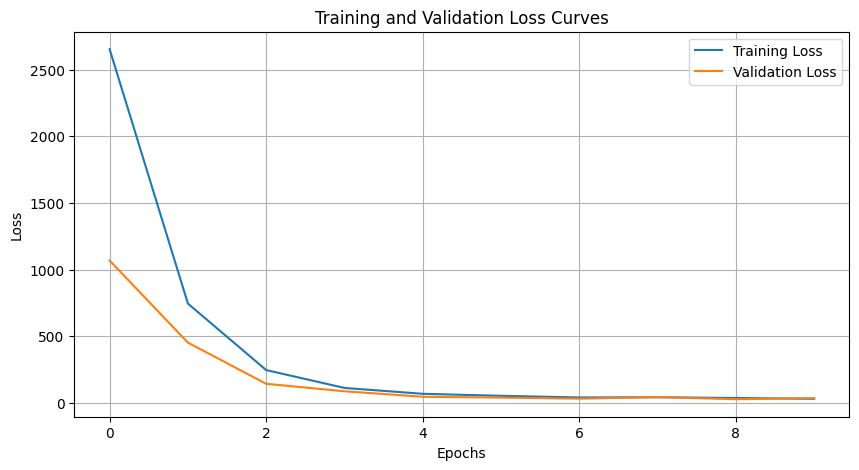

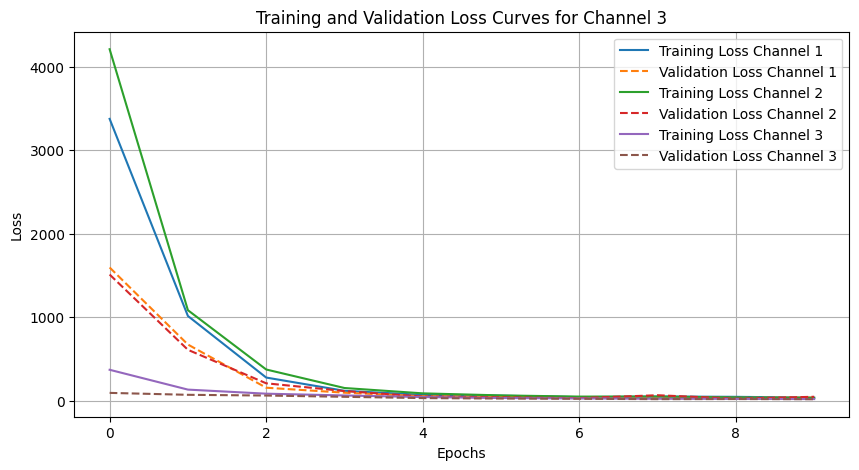

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_slow_combined.csv


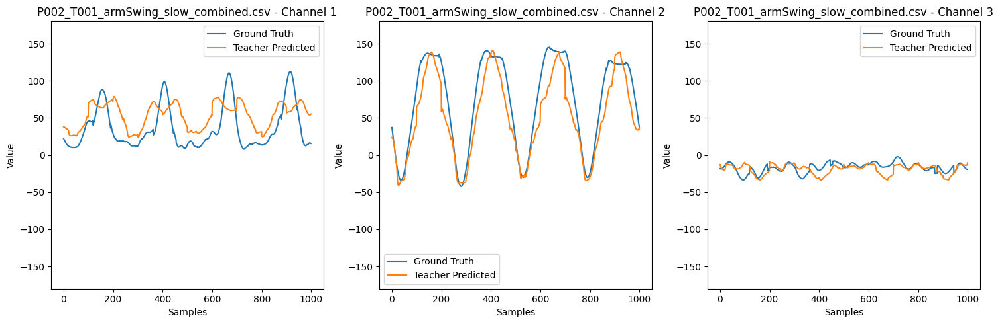

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_normal_combined.csv


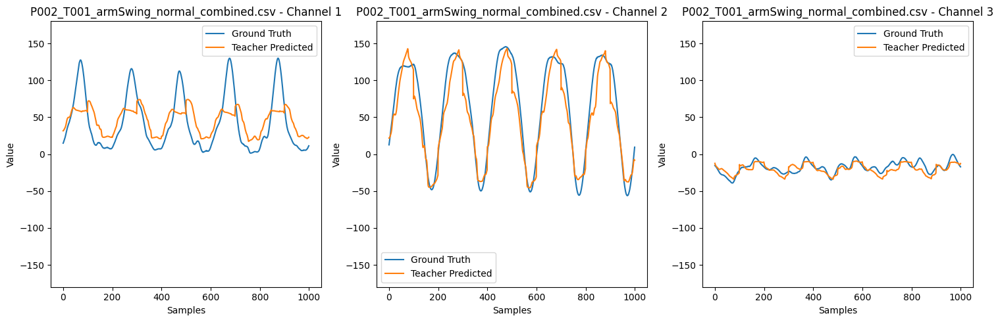

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_fast_combined.csv


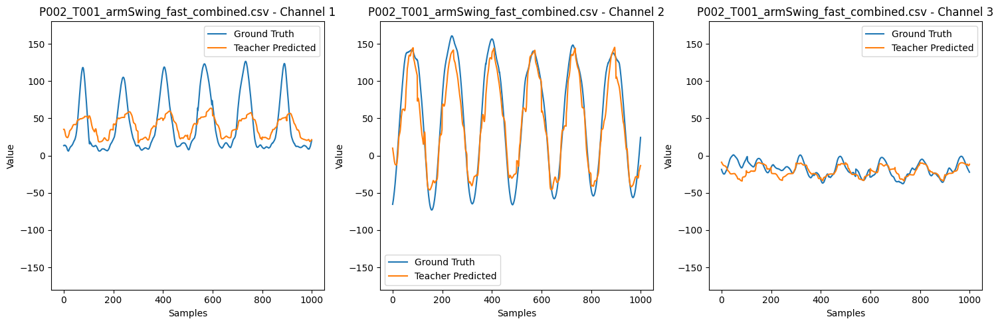

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_veryfast_combined.csv


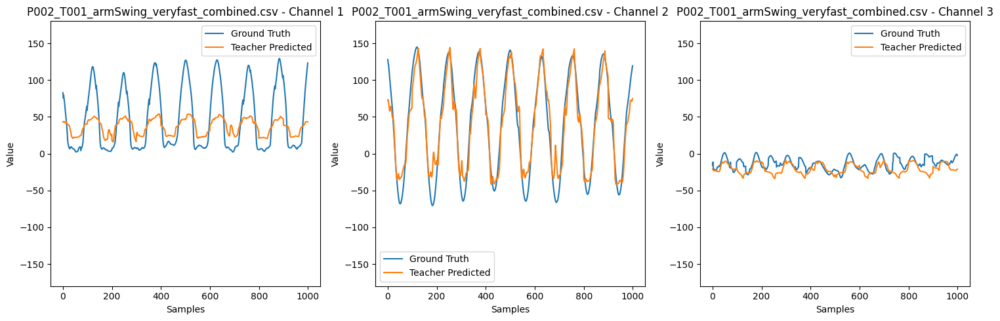

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_slow_combined.csv


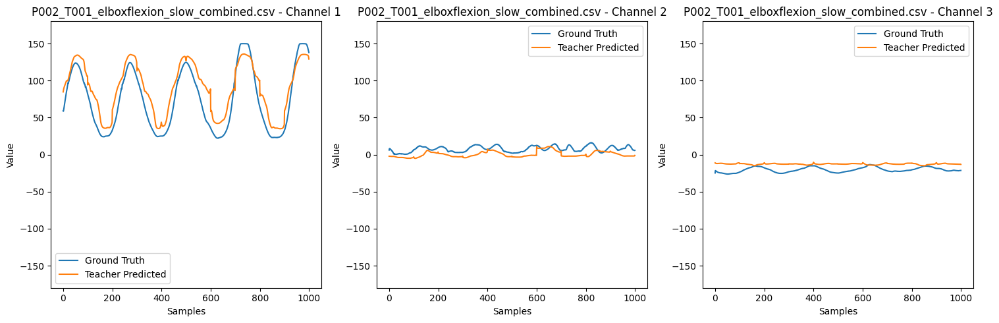

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_normal_combined.csv


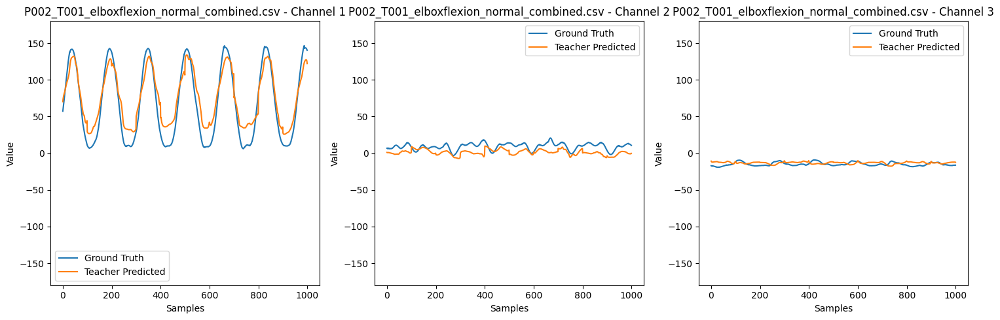

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_fast_combined.csv


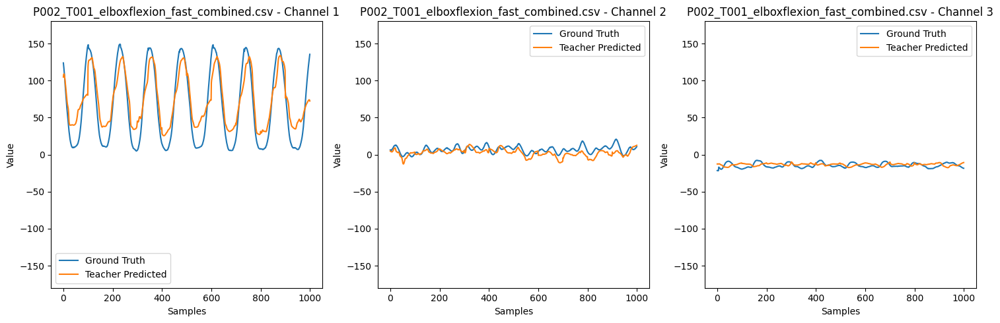

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_slow_combined.csv


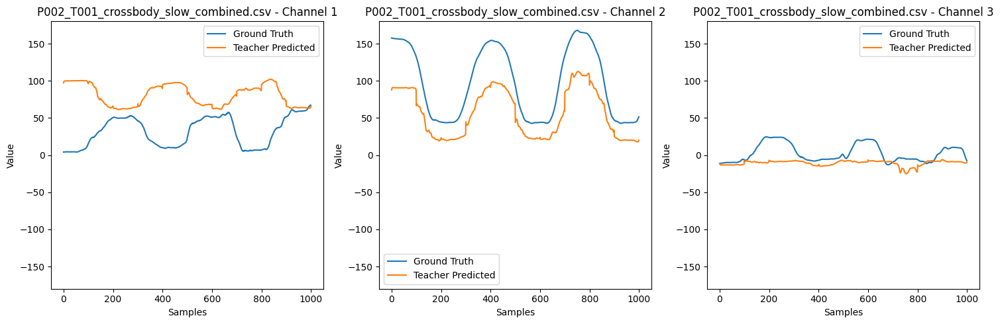

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_normal_combined.csv


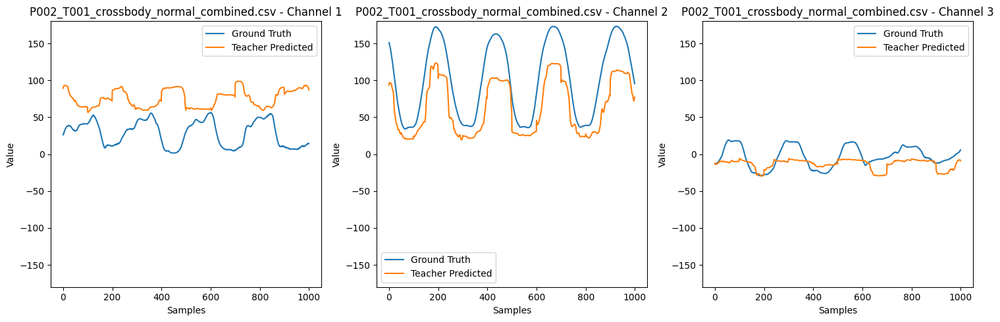

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_fast_combined.csv


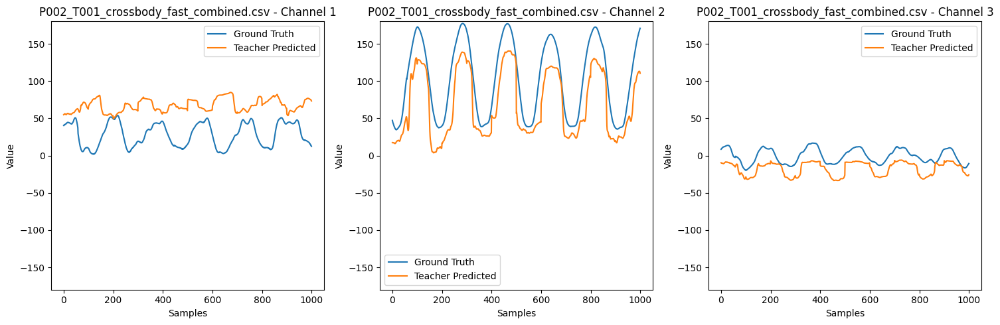

End of iteration
_________________________________________________________
Training subjects: ['subject_1']
Testing subject: subject_3
Dataset name: dataset_wl100_ol75_train['subject_1']_test['subject_3']
Training subjects: ['subject_1']
Testing subjects: ['subject_3']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_1:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_fast_combined:   0%|          | 0/130 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_slow_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_normal_combined:   0%|          | 0/127 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_normal_combined:   0%|          | 0/131 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_fast_combined:   0%|          | 0/126 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_slow_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_veryfast_combined:   0%|          | 0/123 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_slow_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_3:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_normal_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_fast_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T003_armswing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_veryfast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_slow_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_slow_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_fast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Epoch: 1, time: 1.3544, Training Loss: 2618.0615, Validation Loss: 1009.7255
Epoch: 2, time: 1.2721, Training Loss: 666.6095, Validation Loss: 363.0540
Epoch: 3, time: 1.3001, Training Loss: 207.6351, Validation Loss: 102.9046
Epoch: 4, time: 1.2894, Training Loss: 101.7051, Validation Loss: 69.1094
Epoch: 5, time: 1.2827, Training Loss: 62.7552, Validation Loss: 50.8575
Epoch: 6, time: 1.2940, Training Loss: 46.8043, Validation Loss: 39.3804
Epoch: 7, time: 1.2943, Training Loss: 45.3219, Validation Loss: 33.7125
Epoch: 8, time: 1.3145, Training Loss: 40.0530, Validation Loss: 30.6476
Epoch: 9, time: 1.3189, Training Loss: 29.4953, Validation Loss: 23.2027
Epoch: 10, time: 1.3879, Training Loss: 28.1489, Validation Loss: 20.3810
Training time: 13.740385293960571 seconds
________________________________
Training set metrics
RMSE per channel: [4.24790716 4.85486603 3.98288703]
4.2479067
4.854866
3.982887


0.9920197543932431
0.9980064893334327
0.9282126305250681
Mean: 4.362 +/- 0.447
Me

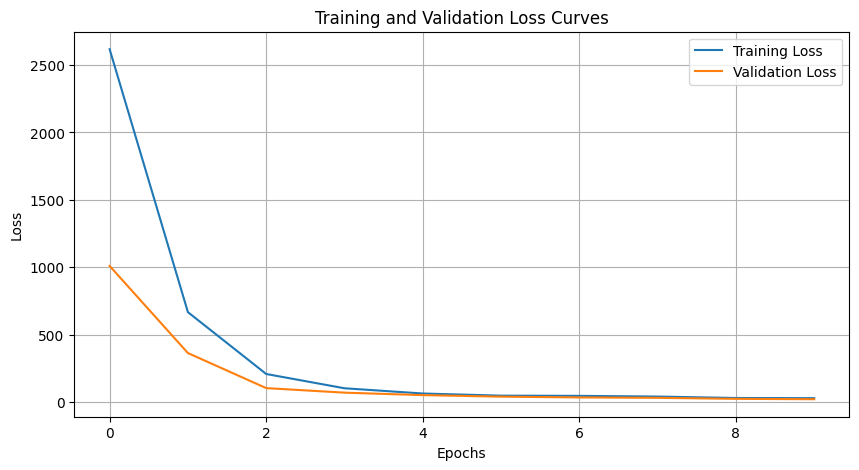

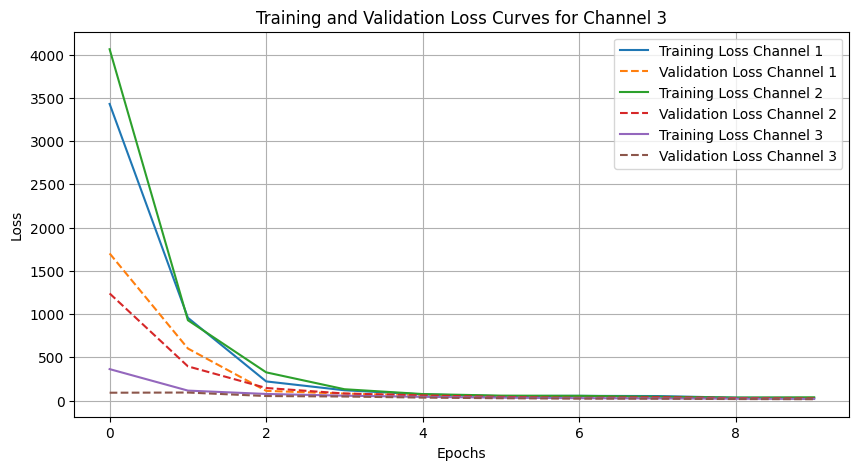

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_normal_combined.csv


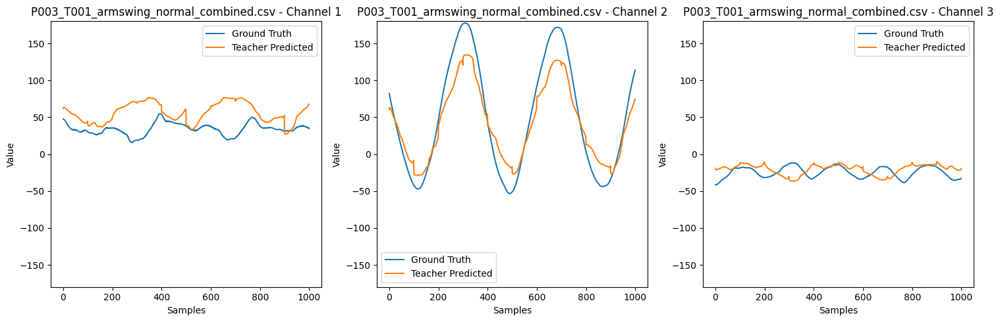

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_fast_combined.csv


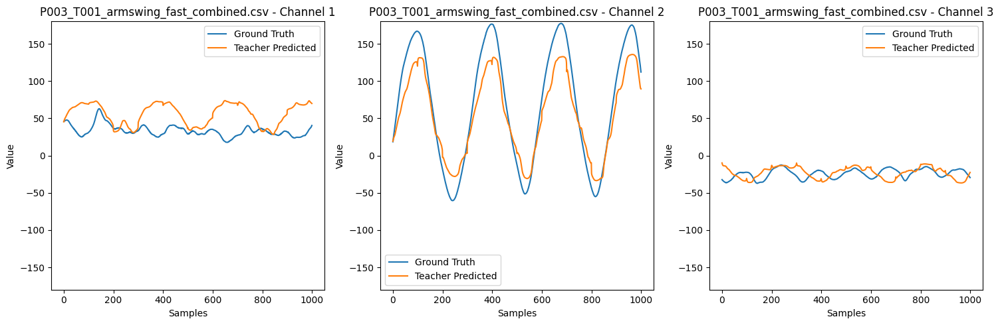

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T003_armswing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T003_armswing_slow_combined.csv


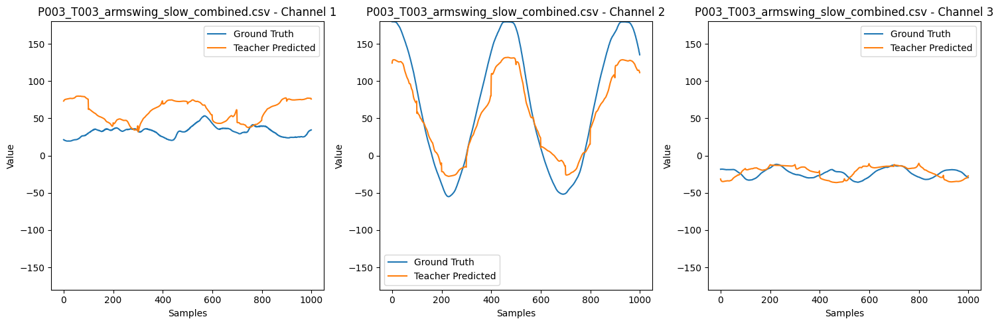

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_veryfast_combined.csv


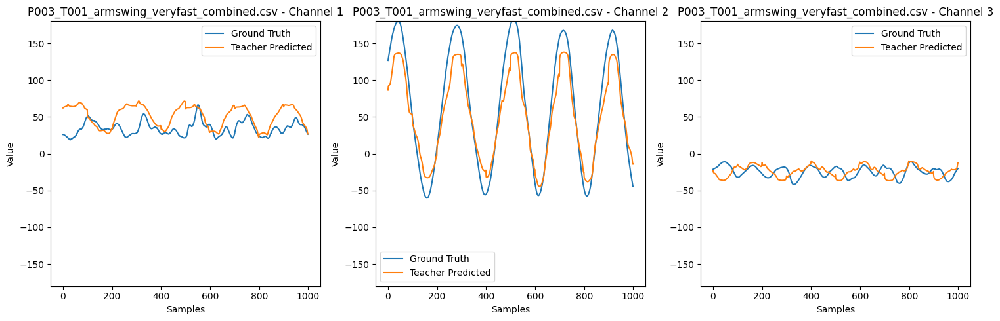

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_slow_combined.csv


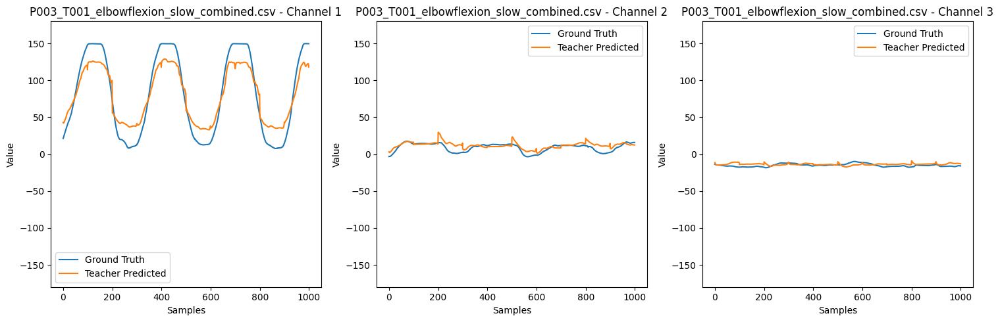

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_normal_combined.csv


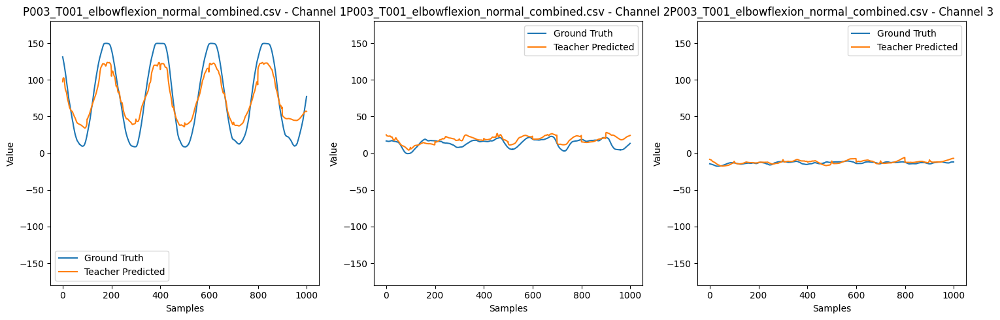

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_fast_combined.csv


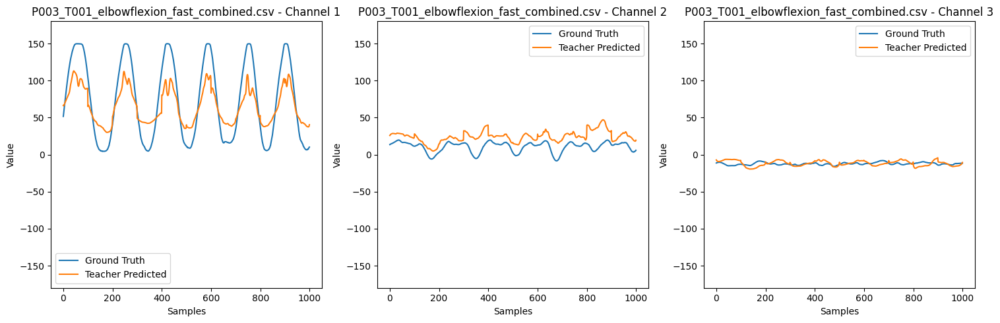

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_slow_combined.csv


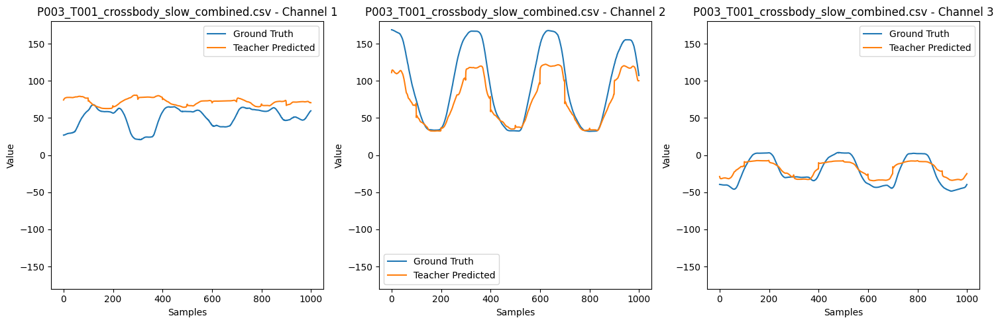

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_normal_combined.csv


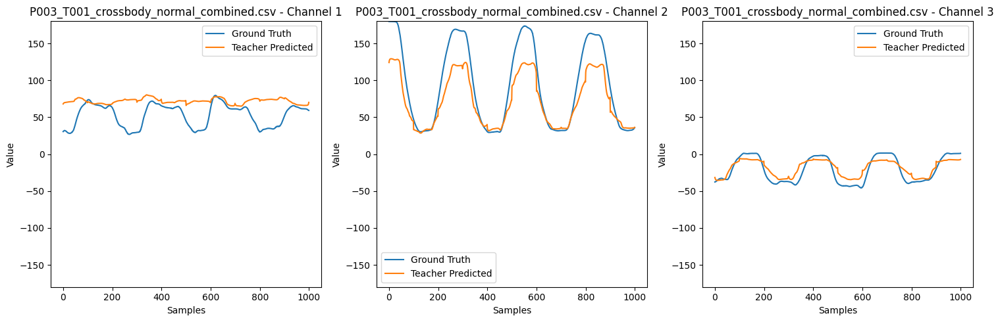

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_fast_combined.csv


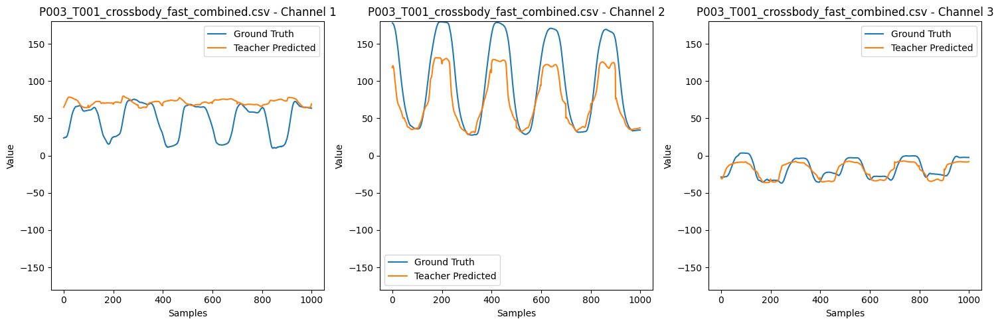

End of iteration
_________________________________________________________
Training subjects: ['subject_1']
Testing subject: subject_6
Dataset name: dataset_wl100_ol75_train['subject_1']_test['subject_6']
Training subjects: ['subject_1']
Testing subjects: ['subject_6']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_1:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_fast_combined:   0%|          | 0/130 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_slow_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_normal_combined:   0%|          | 0/127 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_normal_combined:   0%|          | 0/131 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_fast_combined:   0%|          | 0/126 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_slow_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_veryfast_combined:   0%|          | 0/123 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_slow_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_6:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_slow_combined:   0%|          | 0/112 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_veryfast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_slow_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Epoch: 1, time: 1.4198, Training Loss: 2698.2917, Validation Loss: 946.8742
Epoch: 2, time: 1.3228, Training Loss: 628.5163, Validation Loss: 279.9445
Epoch: 3, time: 1.3318, Training Loss: 198.5650, Validation Loss: 109.4602
Epoch: 4, time: 1.3476, Training Loss: 101.0282, Validation Loss: 66.7912
Epoch: 5, time: 1.3539, Training Loss: 85.1712, Validation Loss: 99.1326
Epoch: 6, time: 1.3551, Training Loss: 71.0868, Validation Loss: 51.2724
Epoch: 7, time: 1.3482, Training Loss: 49.0852, Validation Loss: 30.0568
Epoch: 8, time: 1.3708, Training Loss: 38.8331, Validation Loss: 23.0194
Epoch: 9, time: 1.3800, Training Loss: 32.0504, Validation Loss: 23.0999
Epoch: 10, time: 1.3978, Training Loss: 28.6715, Validation Loss: 36.1823
Training time: 14.083262920379639 seconds
________________________________
Training set metrics
RMSE per channel: [4.95972824 4.76827765 4.76857519]
4.9597282
4.768278
4.768575


0.9887012303698198
0.996949252011137
0.890922855010825
Mean: 4.832 +/- 0.110
Mean:

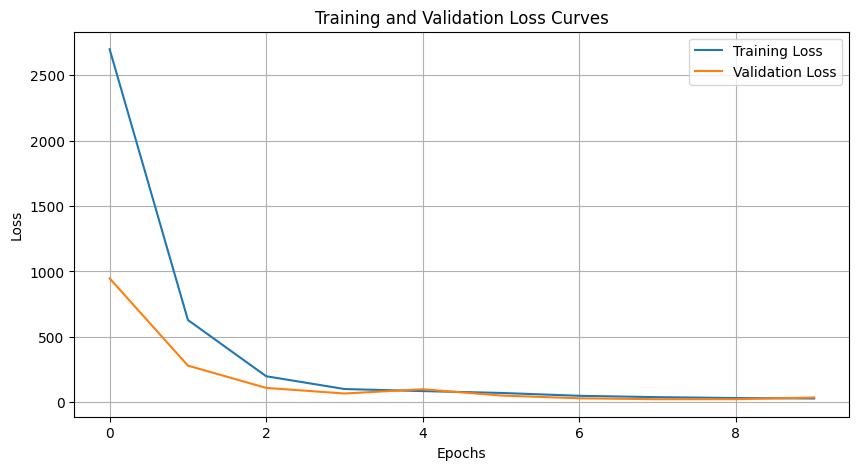

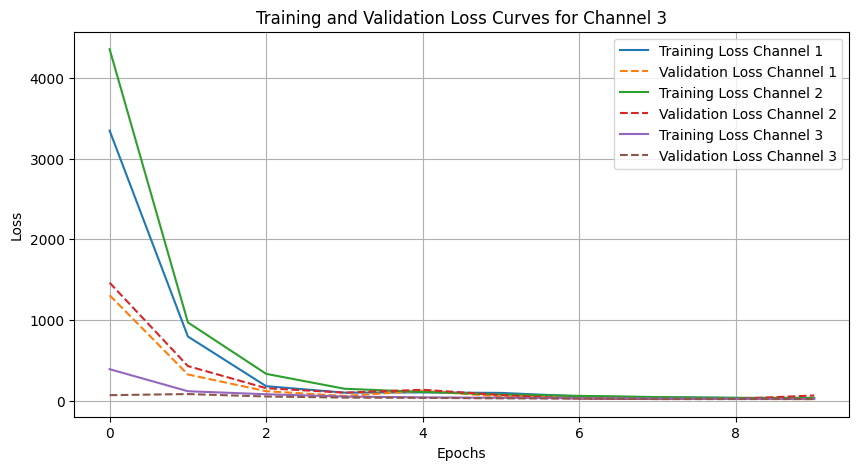

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_slow_combined.csv


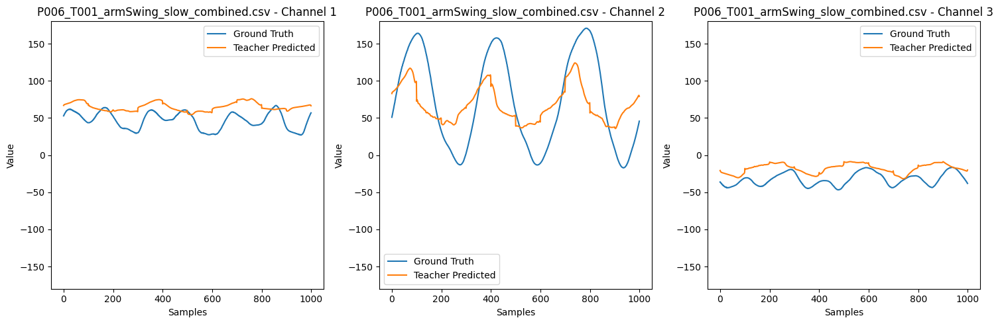

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_normal_combined.csv


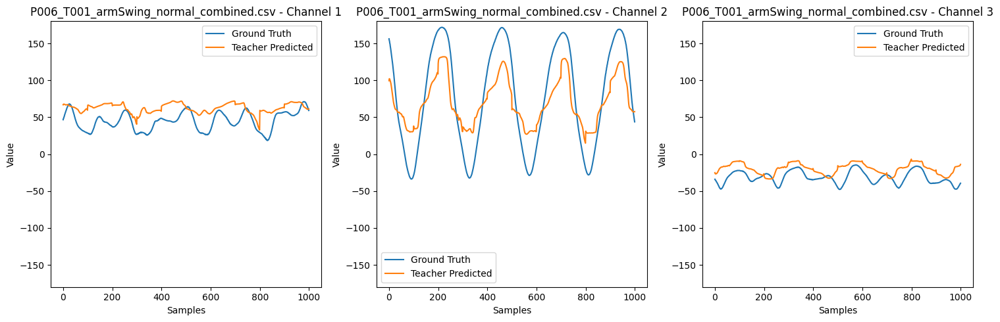

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_veryfast_combined.csv


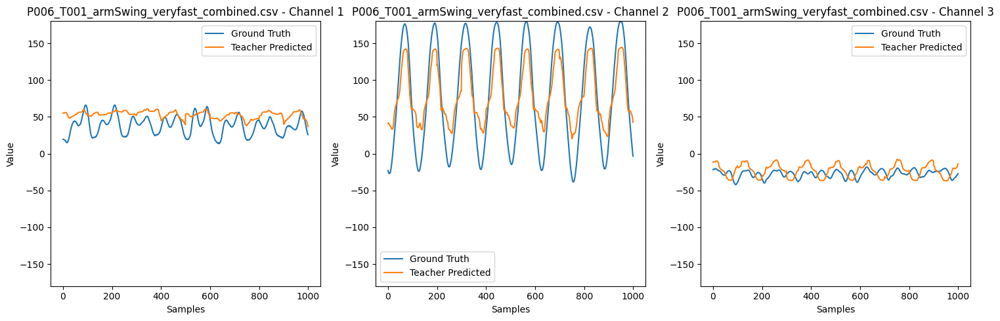

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_fast_combined.csv


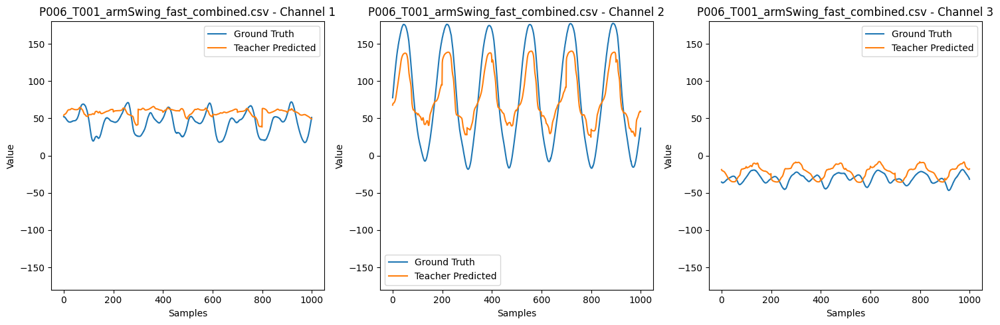

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_slow_combined.csv


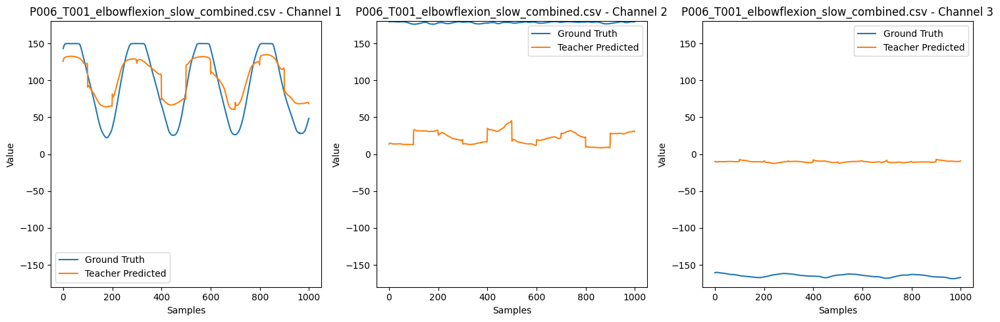

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_normal_combined.csv


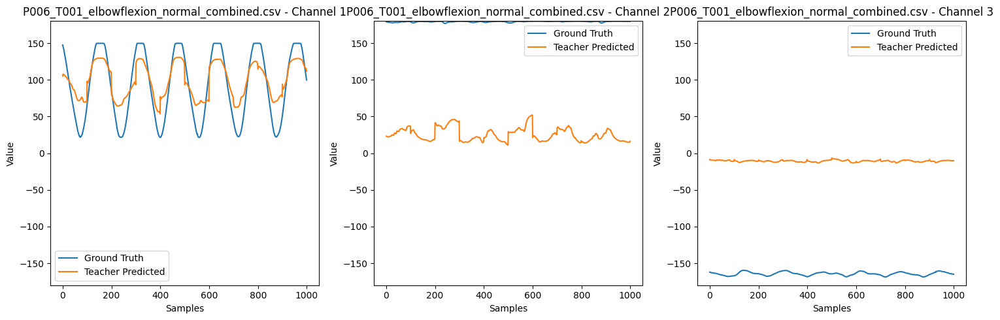

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_fast_combined.csv


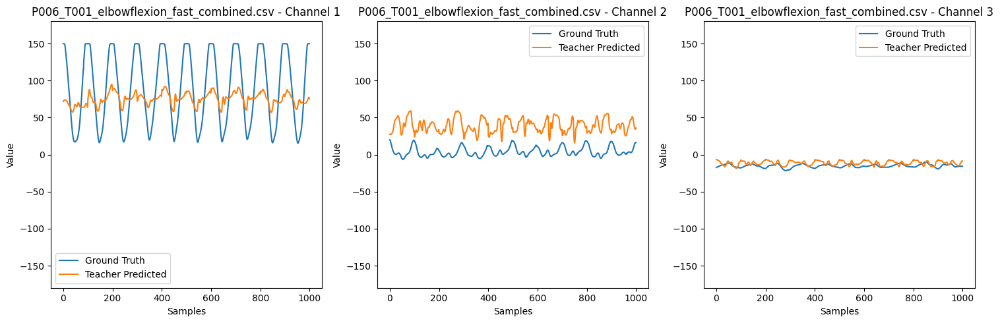

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_slow_combined.csv


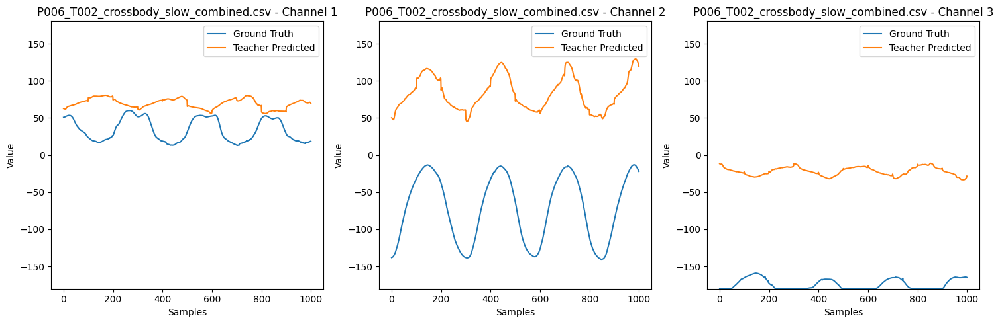

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_normal_combined.csv


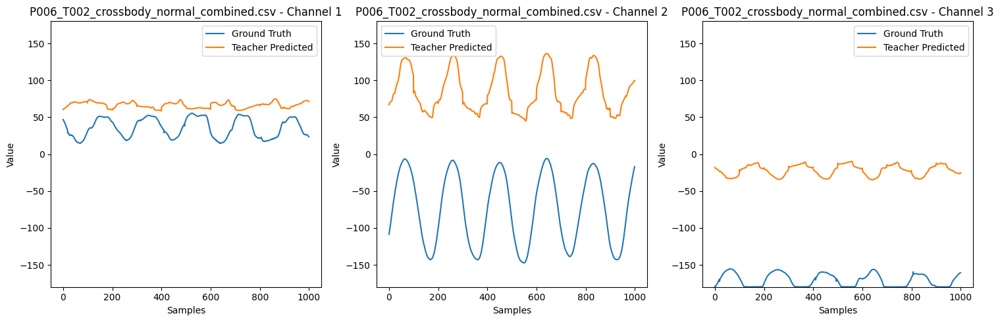

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_fast_combined.csv


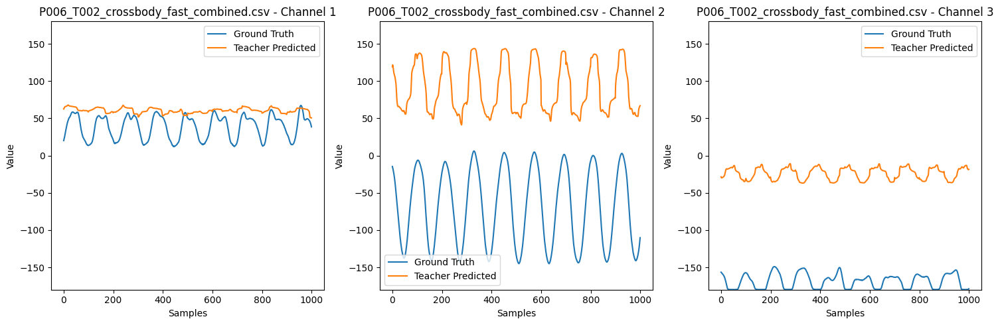

End of iteration
_________________________________________________________
Training subjects: ['subject_1']
Testing subject: subject_7
Dataset name: dataset_wl100_ol75_train['subject_1']_test['subject_7']
Training subjects: ['subject_1']
Testing subjects: ['subject_7']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_1:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_fast_combined:   0%|          | 0/130 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_slow_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_normal_combined:   0%|          | 0/127 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_normal_combined:   0%|          | 0/131 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_fast_combined:   0%|          | 0/126 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_slow_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_veryfast_combined:   0%|          | 0/123 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_slow_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_7:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T002_armSwing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_normal_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_veryfast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_slow_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Epoch: 1, time: 1.4153, Training Loss: 2592.3912, Validation Loss: 978.7134
Epoch: 2, time: 1.3379, Training Loss: 666.4522, Validation Loss: 344.8460
Epoch: 3, time: 1.3763, Training Loss: 233.2788, Validation Loss: 137.8937
Epoch: 4, time: 1.3604, Training Loss: 104.1524, Validation Loss: 66.5572
Epoch: 5, time: 1.3665, Training Loss: 67.4655, Validation Loss: 46.6901
Epoch: 6, time: 1.3509, Training Loss: 44.8309, Validation Loss: 33.6188
Epoch: 7, time: 1.3436, Training Loss: 39.5559, Validation Loss: 35.6537
Epoch: 8, time: 1.3639, Training Loss: 35.8031, Validation Loss: 34.3805
Epoch: 9, time: 1.3673, Training Loss: 37.4569, Validation Loss: 26.7297
Epoch: 10, time: 1.3862, Training Loss: 31.3140, Validation Loss: 18.3134
Training time: 14.262644052505493 seconds
________________________________
Training set metrics
RMSE per channel: [4.32611609 4.55073738 4.11602926]
4.326116
4.550737
4.1160293


0.9924545357821007
0.9973942839260808
0.9214326674939579
Mean: 4.331 +/- 0.217
Mea

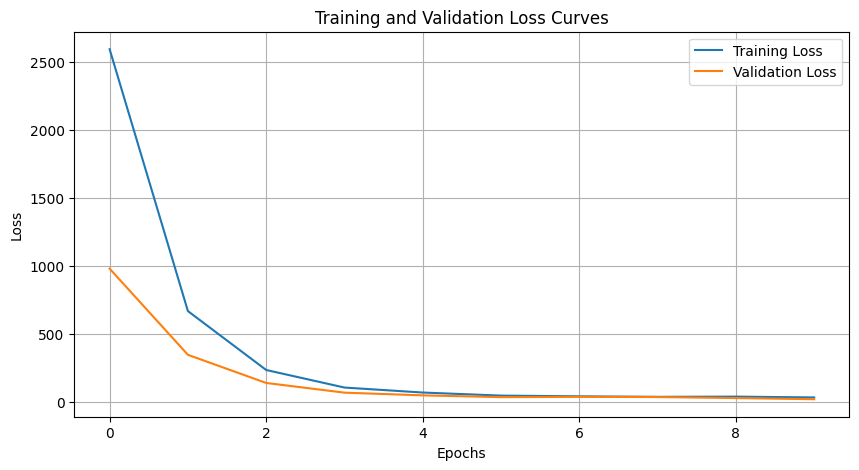

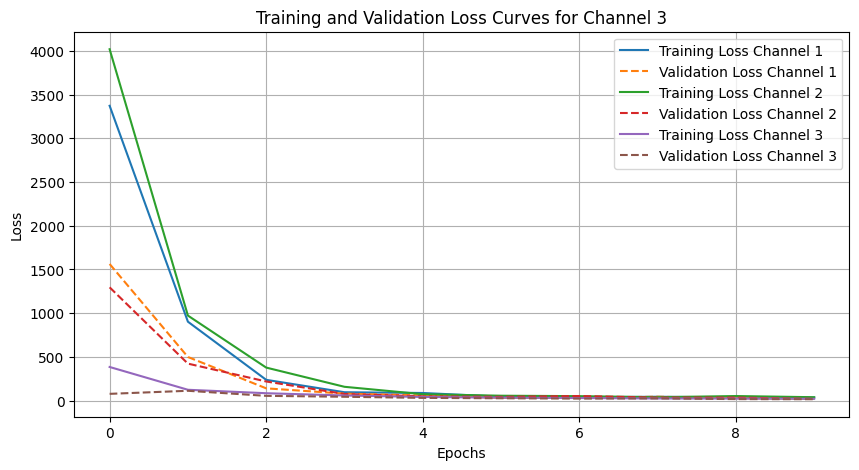

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T002_armSwing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T002_armSwing_slow_combined.csv


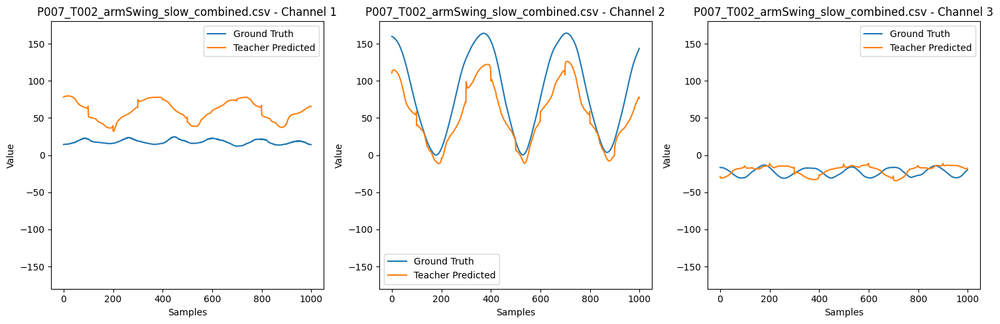

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_normal_combined.csv


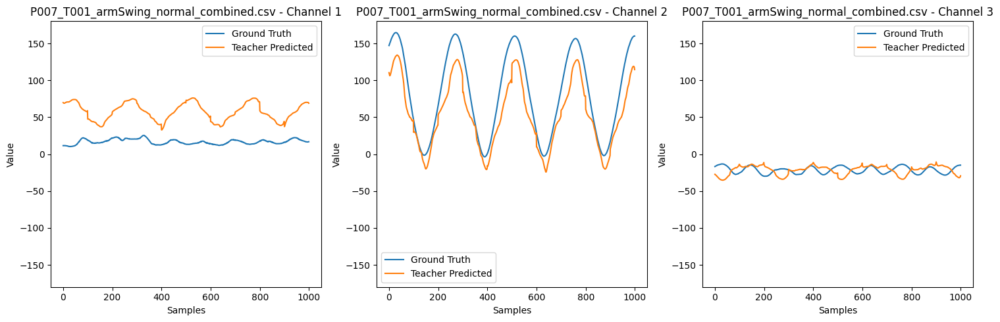

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_fast_combined.csv


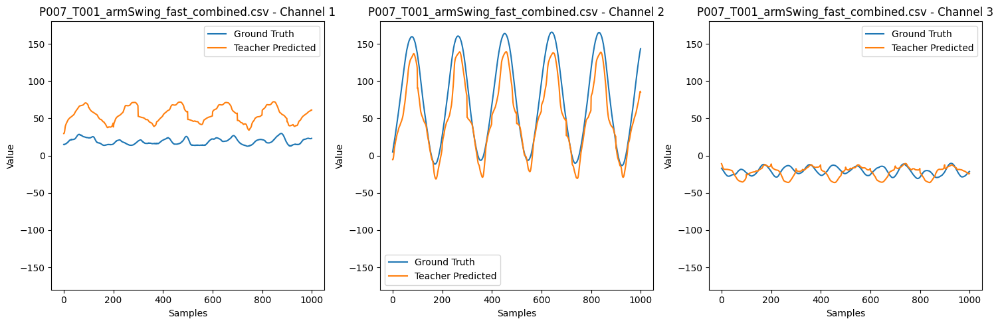

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_veryfast_combined.csv


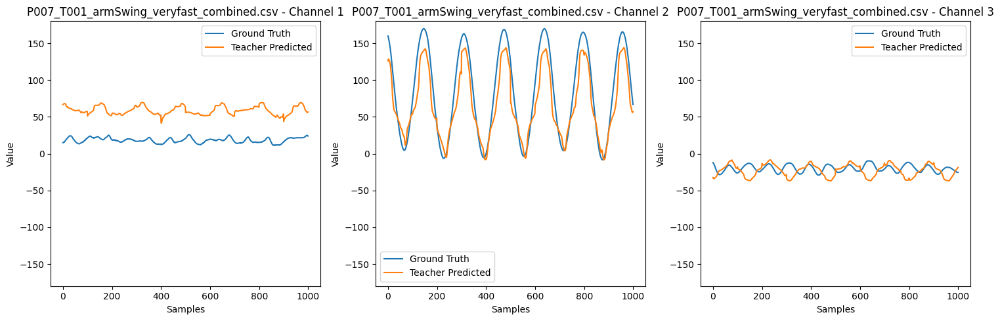

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_slow_combined.csv


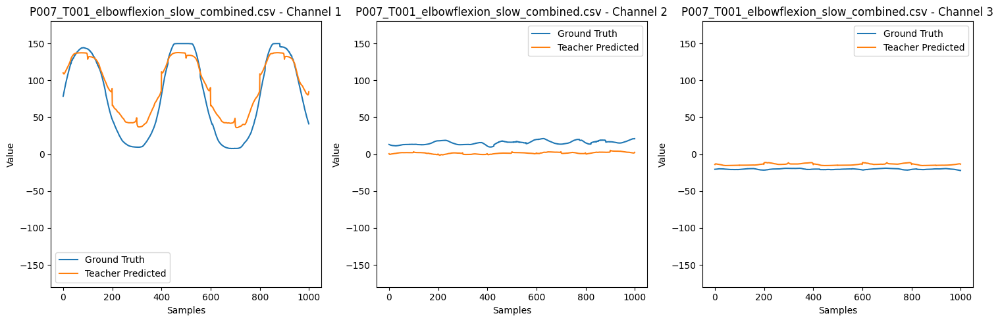

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_normal_combined.csv


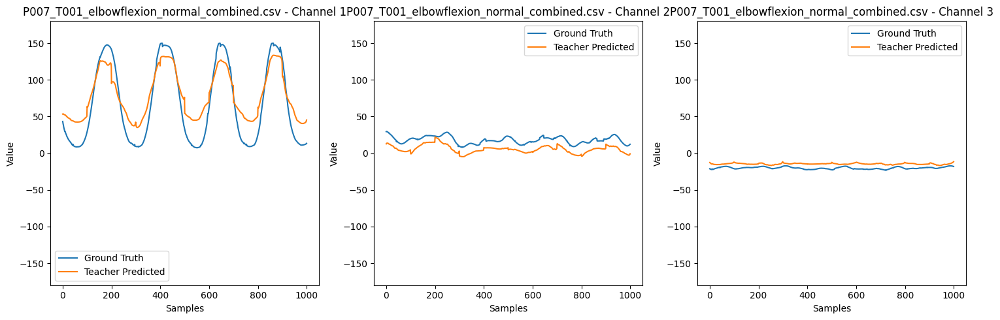

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_fast_combined.csv


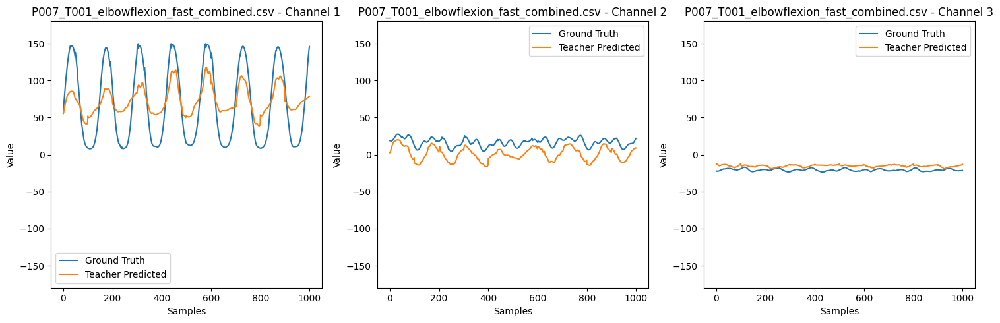

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_slow_combined.csv


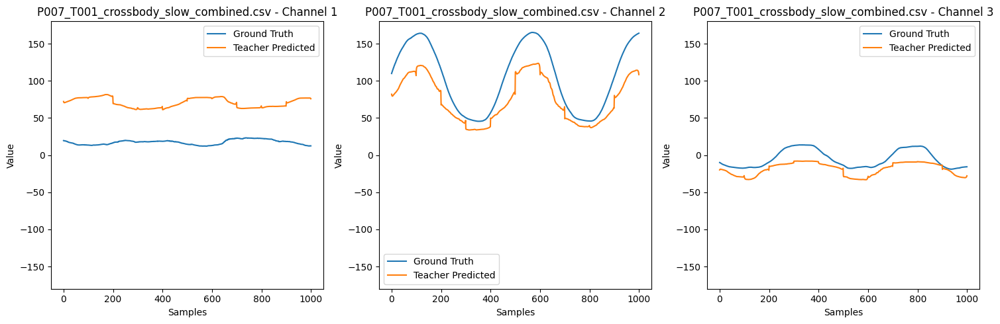

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_fast_combined.csv


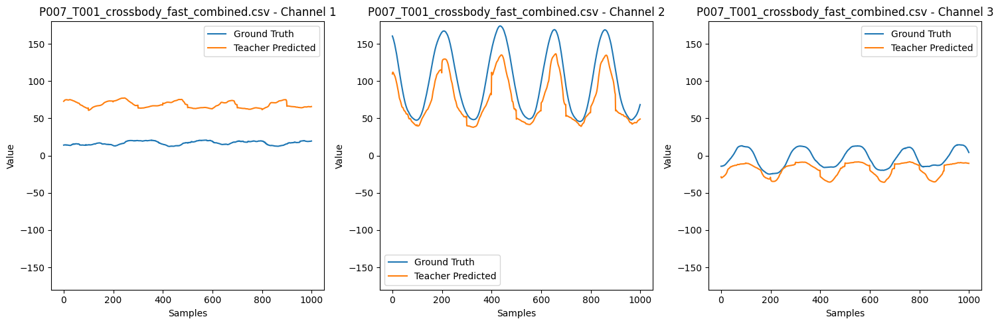

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_normal_combined.csv


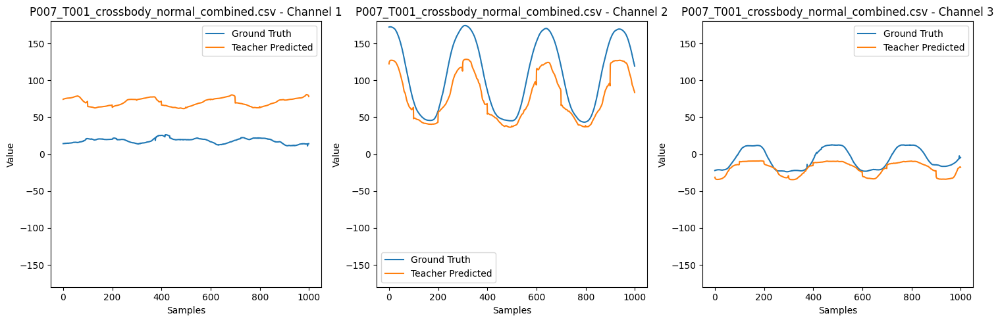

End of iteration
_________________________________________________________
Training subjects: ['subject_1']
Testing subject: subject_9
Dataset name: dataset_wl100_ol75_train['subject_1']_test['subject_9']
Training subjects: ['subject_1']
Testing subjects: ['subject_9']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_1:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_fast_combined:   0%|          | 0/130 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_slow_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_normal_combined:   0%|          | 0/127 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_normal_combined:   0%|          | 0/131 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_fast_combined:   0%|          | 0/126 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_slow_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_veryfast_combined:   0%|          | 0/123 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_slow_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_9:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_normal_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_veryfast_combined:   0%|          | 0/123 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_elbowflexion_slow_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_elbowflexion_normal_combined:   0%|          | 0/127 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_crossbody_normal_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_crossbody_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Epoch: 1, time: 1.4444, Training Loss: 2600.3156, Validation Loss: 946.0853
Epoch: 2, time: 1.6657, Training Loss: 585.8794, Validation Loss: 279.9501
Epoch: 3, time: 1.4308, Training Loss: 188.9209, Validation Loss: 100.4176
Epoch: 4, time: 1.5388, Training Loss: 99.5228, Validation Loss: 65.4311
Epoch: 5, time: 1.6562, Training Loss: 68.6402, Validation Loss: 60.0294
Epoch: 6, time: 1.4125, Training Loss: 51.3976, Validation Loss: 38.1794
Epoch: 7, time: 1.5348, Training Loss: 40.4480, Validation Loss: 58.8581
Epoch: 8, time: 1.4584, Training Loss: 48.9202, Validation Loss: 32.0434
Epoch: 9, time: 1.3888, Training Loss: 36.5859, Validation Loss: 25.6112
Epoch: 10, time: 1.3772, Training Loss: 30.3631, Validation Loss: 24.7537
Training time: 16.156644105911255 seconds
________________________________
Training set metrics
RMSE per channel: [6.28650665 4.5471797  4.14417267]
6.286507
4.5471797
4.1441727


0.9897955386489854
0.9978970571677159
0.9224521365987819
Mean: 4.993 +/- 1.139
Mea

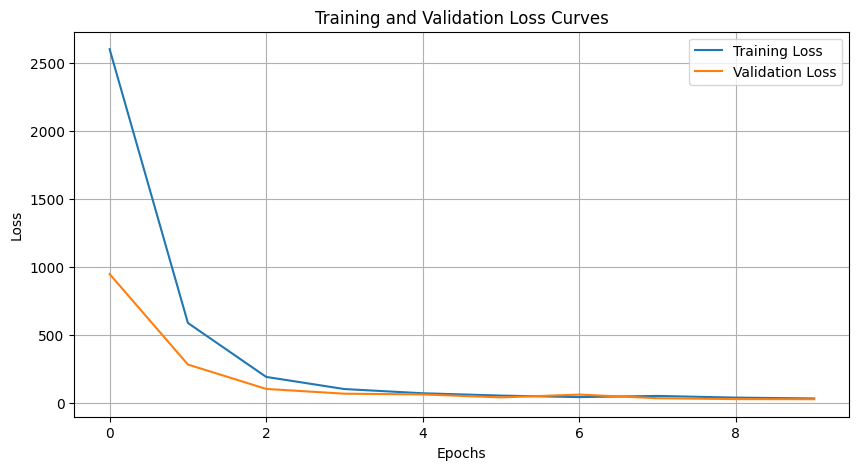

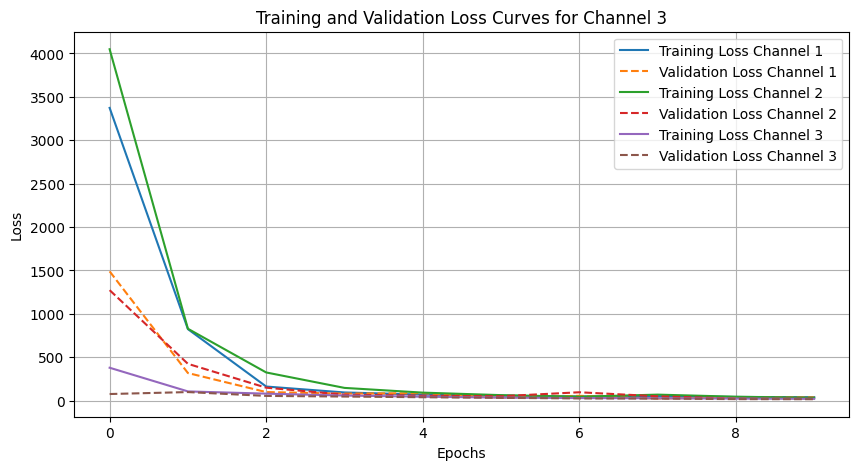

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_slow_combined.csv


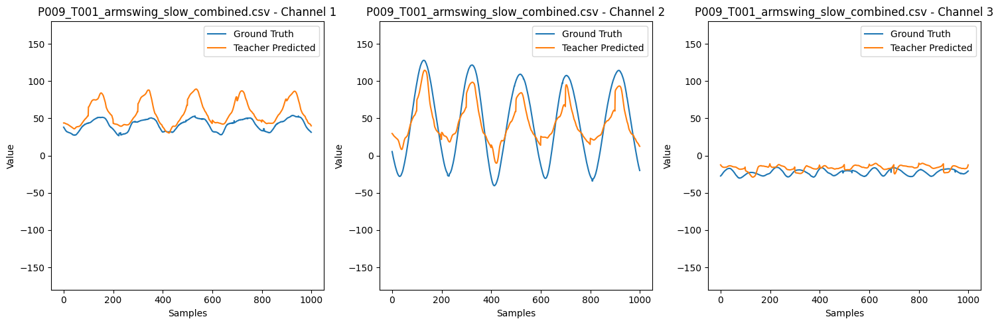

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_normal_combined.csv


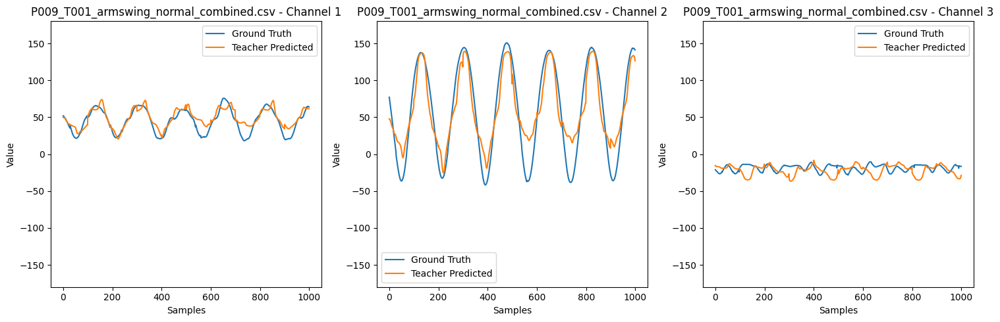

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_fast_combined.csv


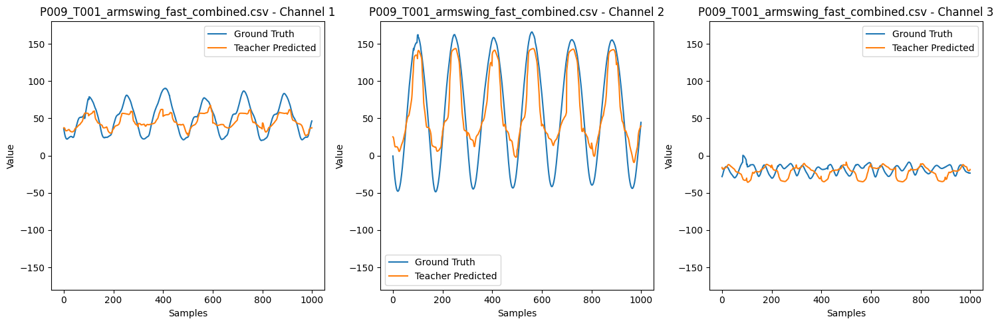

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_veryfast_combined.csv


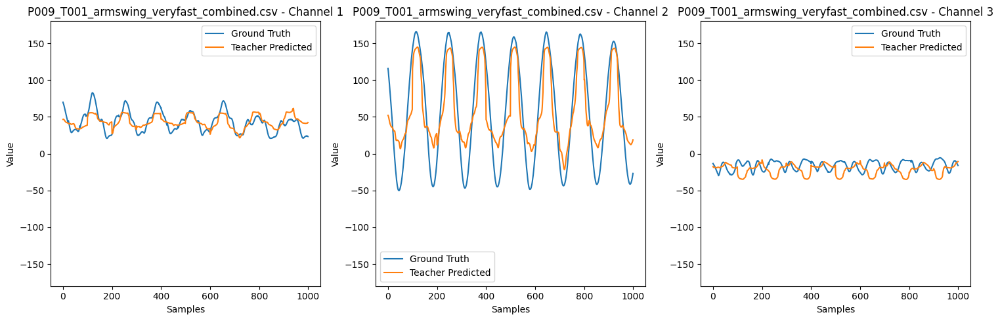

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_slow_combined.csv


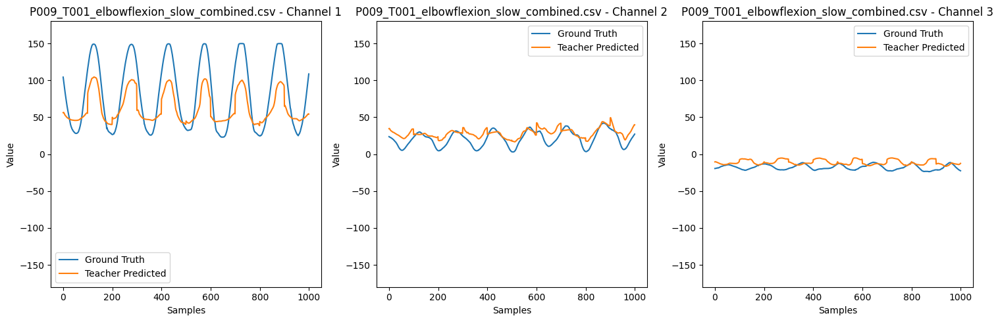

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_normal_combined.csv


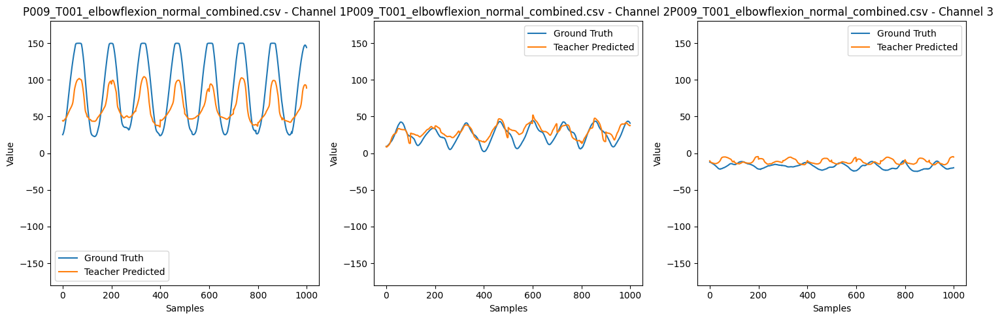

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_elbowflexion_fast_combined.csv


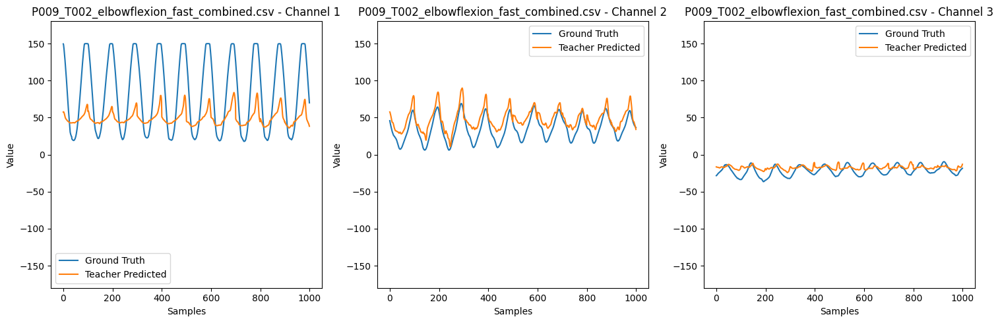

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_slow_combined.csv


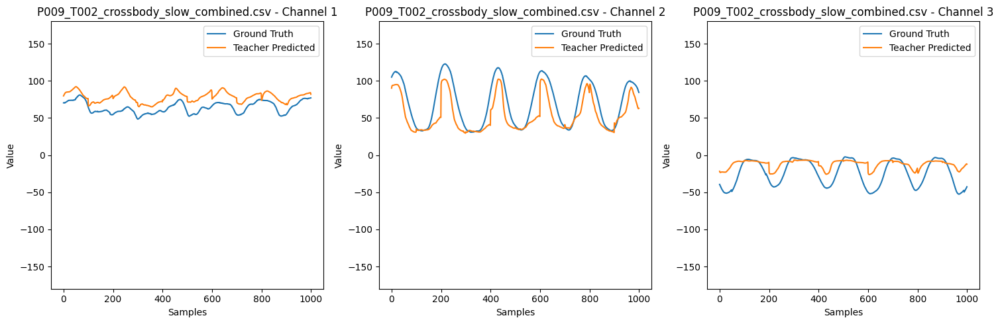

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_normal_combined.csv


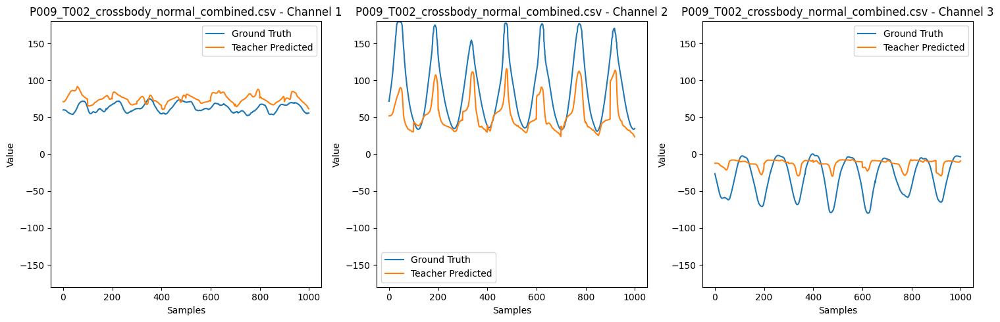

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_fast_combined.csv


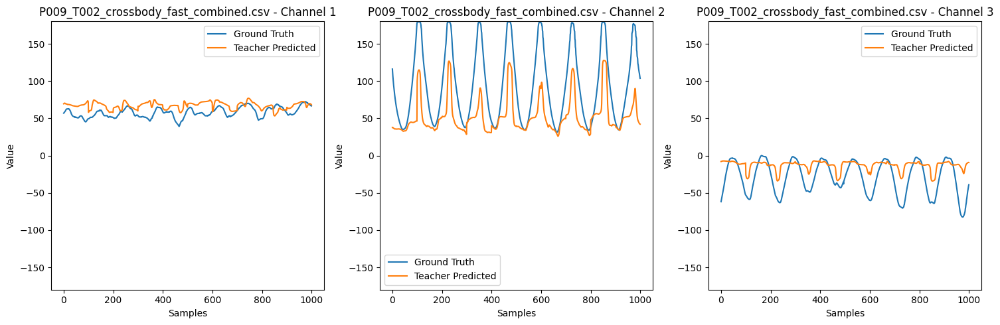

End of iteration
_________________________________________________________
Training subjects: ['subject_2']
Testing subject: subject_1
Dataset name: dataset_wl100_ol75_train['subject_2']_test['subject_1']
Training subjects: ['subject_2']
Testing subjects: ['subject_1']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_2:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_normal_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_veryfast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_1:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_fast_combined:   0%|          | 0/130 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_slow_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_normal_combined:   0%|          | 0/127 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_normal_combined:   0%|          | 0/131 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_fast_combined:   0%|          | 0/126 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_slow_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_veryfast_combined:   0%|          | 0/123 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_slow_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Epoch: 1, time: 1.3678, Training Loss: 2655.5645, Validation Loss: 1077.3481
Epoch: 2, time: 1.2761, Training Loss: 994.2832, Validation Loss: 672.5504
Epoch: 3, time: 1.3198, Training Loss: 521.8700, Validation Loss: 350.6249
Epoch: 4, time: 1.3187, Training Loss: 269.7246, Validation Loss: 212.5197
Epoch: 5, time: 1.3133, Training Loss: 157.8842, Validation Loss: 125.6110
Epoch: 6, time: 1.4584, Training Loss: 100.8485, Validation Loss: 83.6865
Epoch: 7, time: 1.3314, Training Loss: 89.0746, Validation Loss: 94.8917
Epoch: 8, time: 1.2975, Training Loss: 82.8216, Validation Loss: 61.3344
Epoch: 9, time: 1.3188, Training Loss: 59.5209, Validation Loss: 43.8505
Epoch: 10, time: 1.3106, Training Loss: 58.8005, Validation Loss: 38.6197
Training time: 14.054264545440674 seconds
________________________________
Training set metrics
RMSE per channel: [6.38399649 6.407691   5.41963768]
6.383997
6.4076915
5.4196377


0.988734090305106
0.9949251947747265
0.885577546970183
Mean: 6.070 +/- 0.564

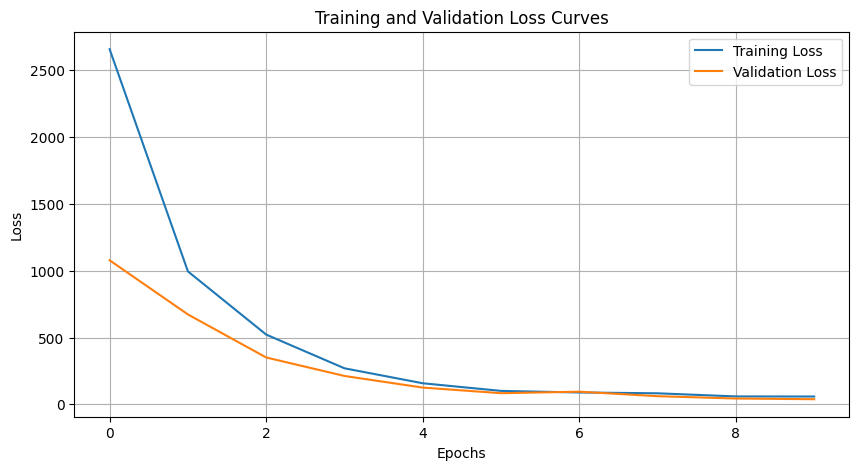

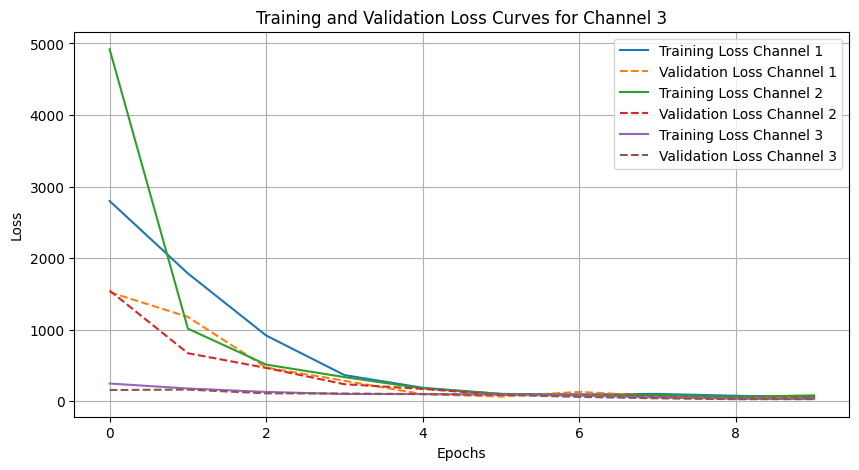

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_fast_combined.csv


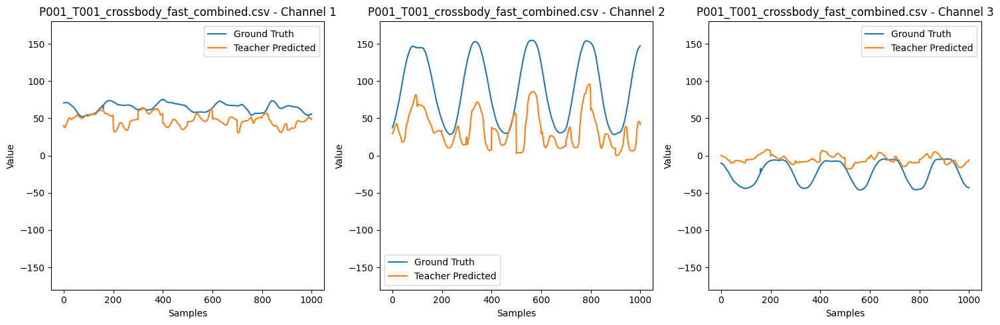

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_slow_combined.csv


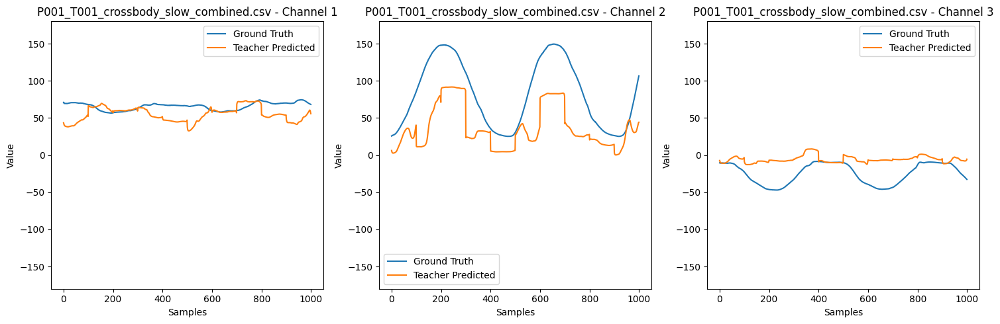

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_fast_combined.csv


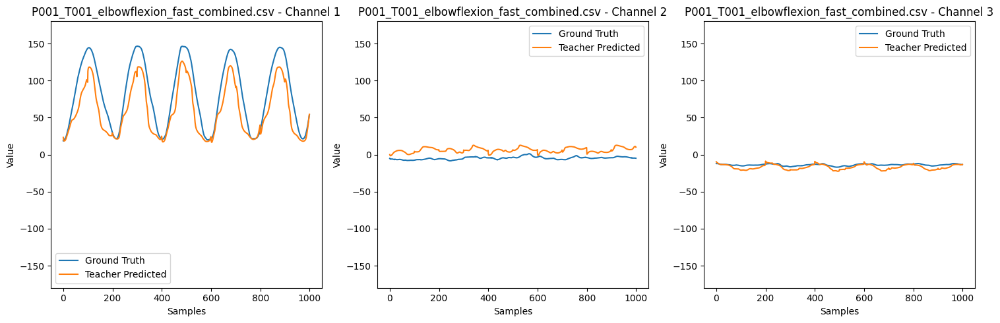

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_normal_combined.csv


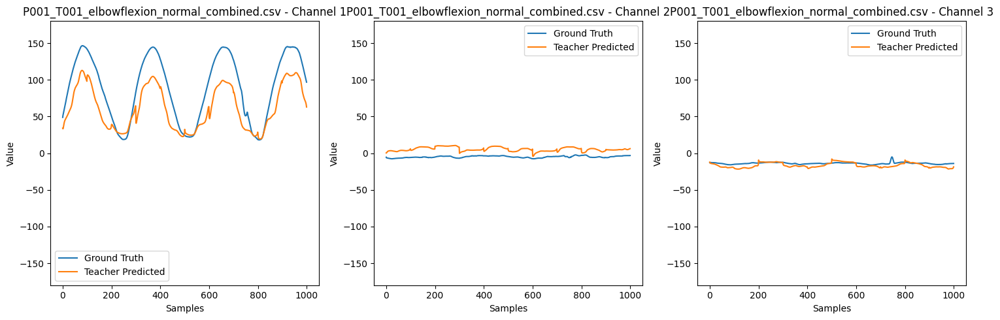

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_normal_combined.csv


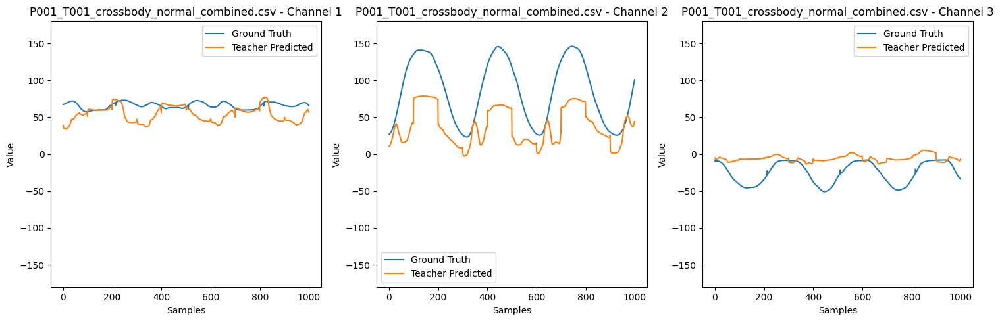

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_fast_combined.csv


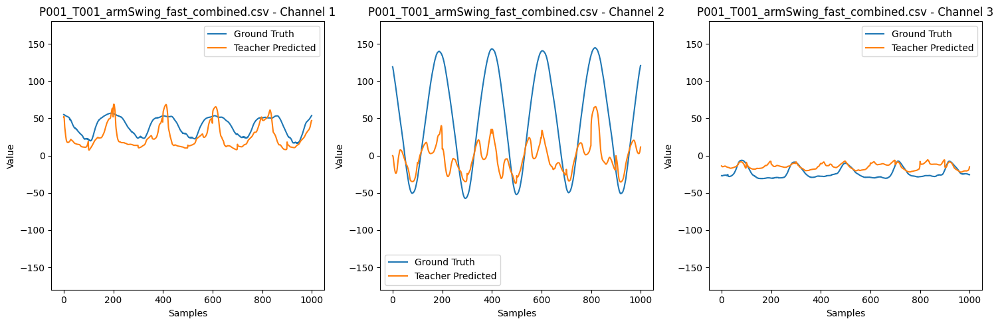

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_normal_combined.csv


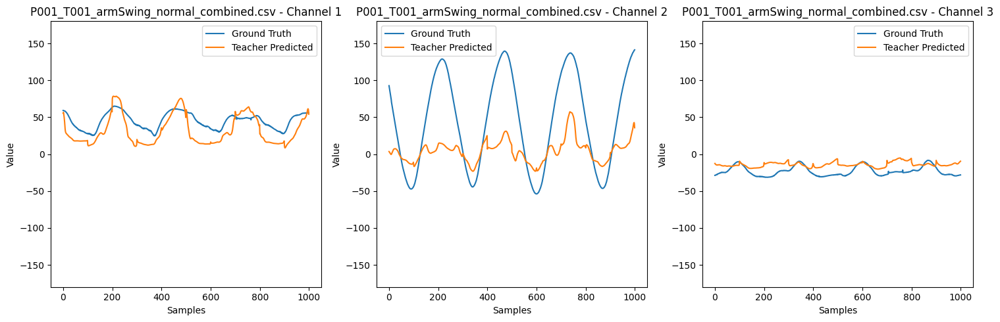

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_slow_combined.csv


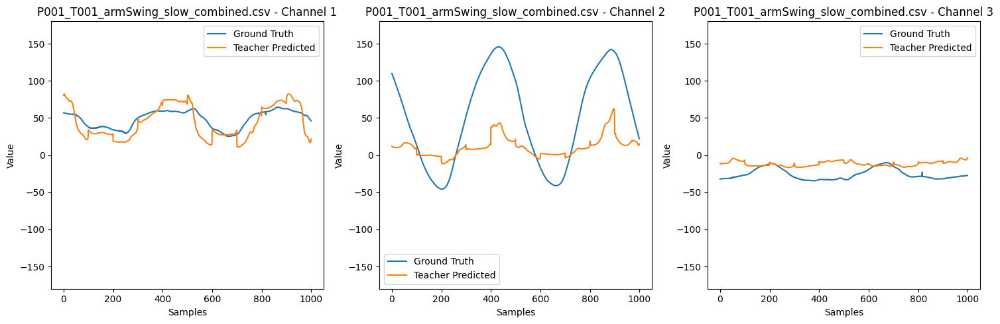

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_veryfast_combined.csv


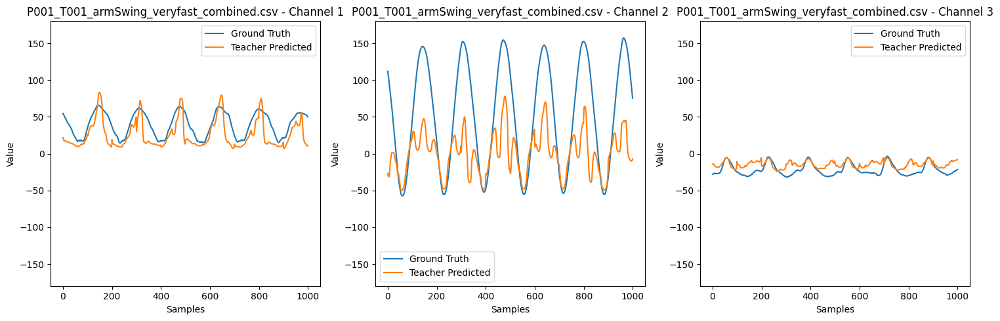

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_slow_combined.csv


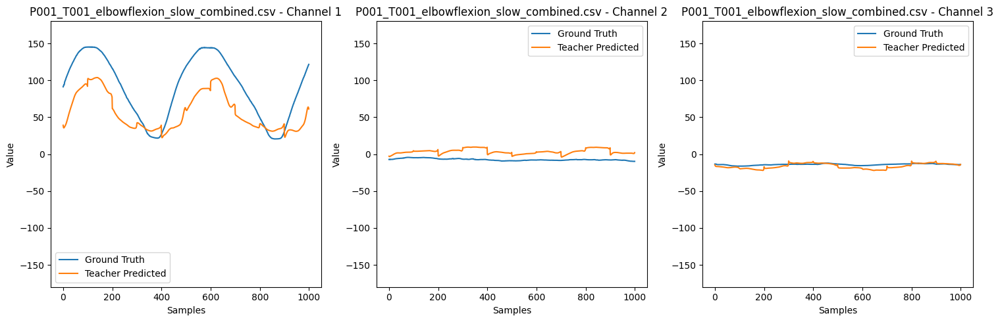

End of iteration
_________________________________________________________
Training subjects: ['subject_2']
Testing subject: subject_3
Dataset name: dataset_wl100_ol75_train['subject_2']_test['subject_3']
Training subjects: ['subject_2']
Testing subjects: ['subject_3']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_2:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_normal_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_veryfast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_3:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_normal_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_fast_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T003_armswing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_veryfast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_slow_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_slow_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_fast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Epoch: 1, time: 1.3759, Training Loss: 2727.6122, Validation Loss: 1140.7496
Epoch: 2, time: 1.2905, Training Loss: 919.7063, Validation Loss: 619.6141
Epoch: 3, time: 1.3800, Training Loss: 476.6461, Validation Loss: 330.3780
Epoch: 4, time: 1.3419, Training Loss: 239.3305, Validation Loss: 199.2664
Epoch: 5, time: 1.3836, Training Loss: 155.7071, Validation Loss: 135.5247
Epoch: 6, time: 1.3295, Training Loss: 114.0738, Validation Loss: 85.4489
Epoch: 7, time: 1.3112, Training Loss: 77.8668, Validation Loss: 58.3063
Epoch: 8, time: 1.3175, Training Loss: 63.8190, Validation Loss: 49.4802
Epoch: 9, time: 1.3207, Training Loss: 60.2012, Validation Loss: 56.5867
Epoch: 10, time: 1.5168, Training Loss: 51.8818, Validation Loss: 48.9082
Training time: 14.624292612075806 seconds
________________________________
Training set metrics
RMSE per channel: [6.42323923 8.27004623 5.31453323]
6.423239
8.270046
5.3145337


0.9879696468933693
0.9953794819933688
0.8887004843419426
Mean: 6.669 +/- 1.49

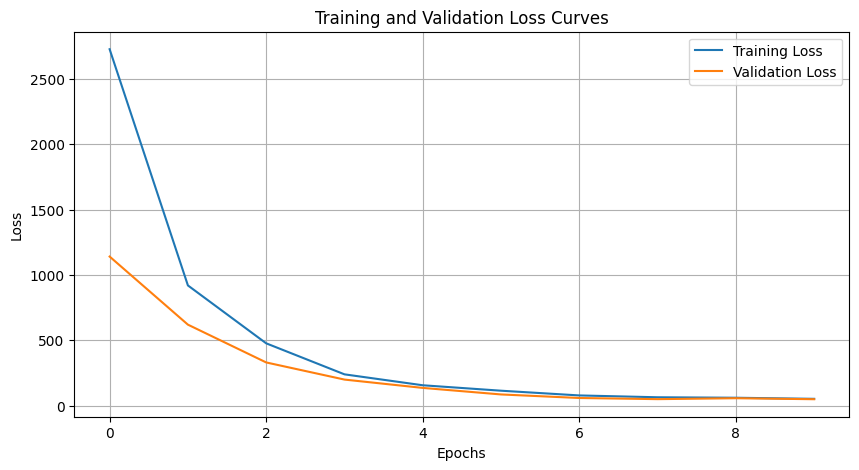

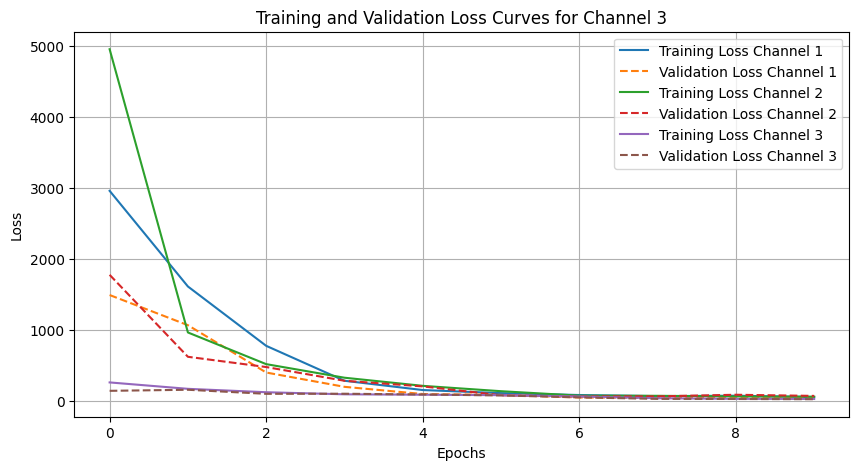

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_normal_combined.csv


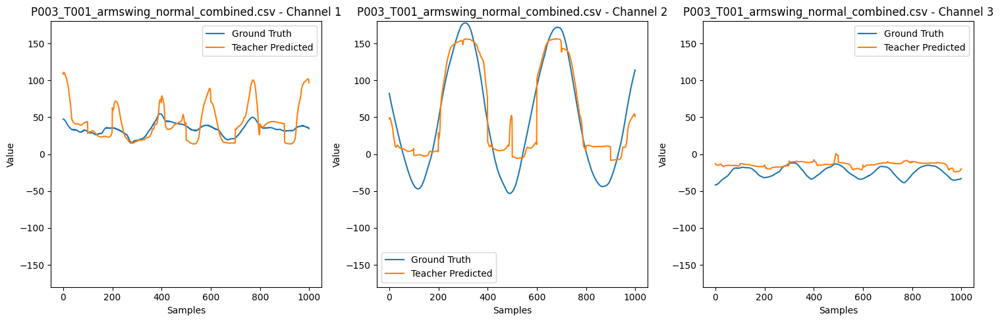

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_fast_combined.csv


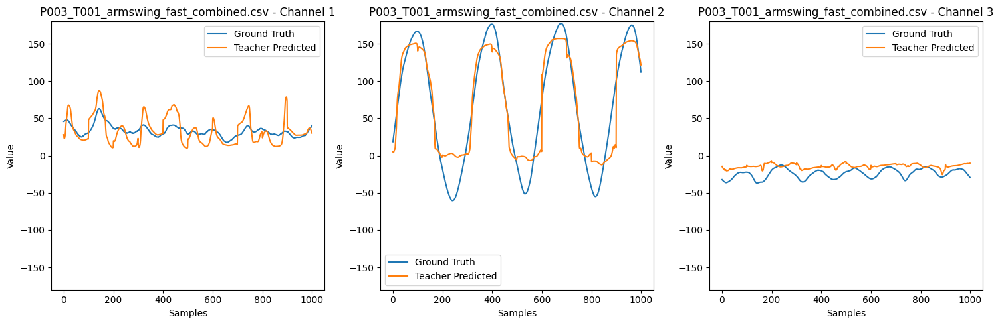

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T003_armswing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T003_armswing_slow_combined.csv


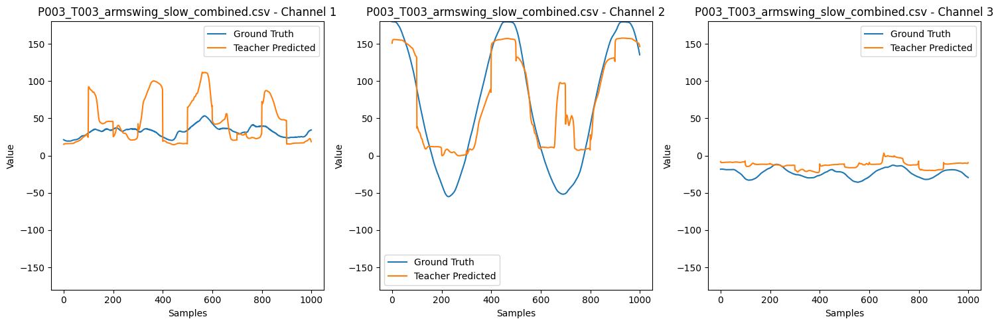

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_veryfast_combined.csv


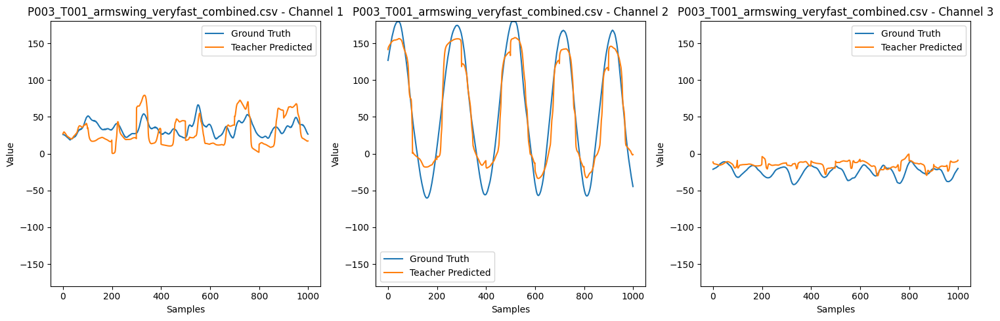

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_slow_combined.csv


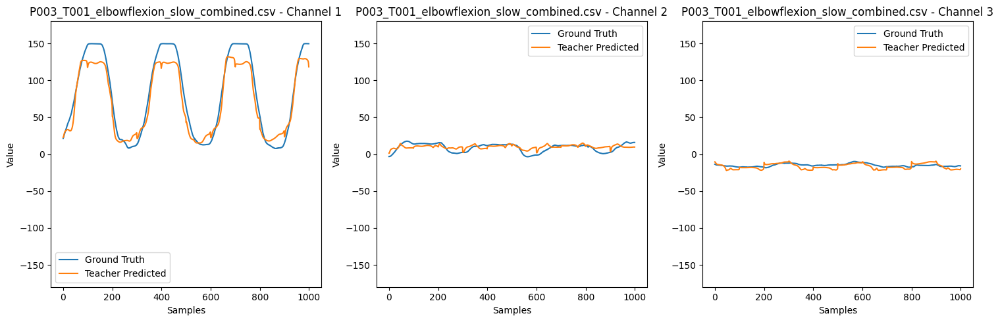

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_normal_combined.csv


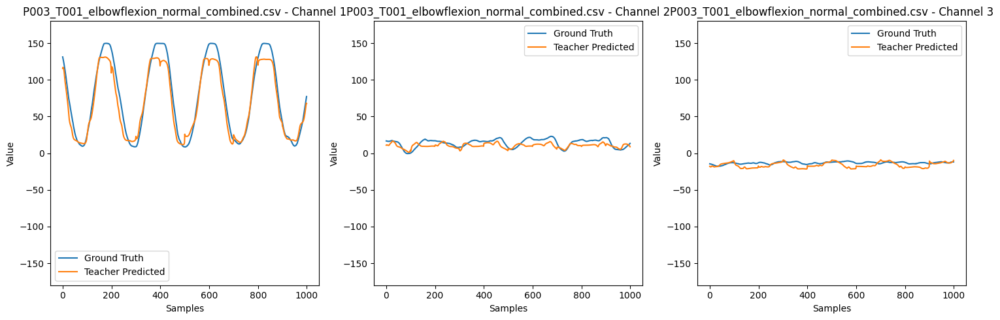

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_fast_combined.csv


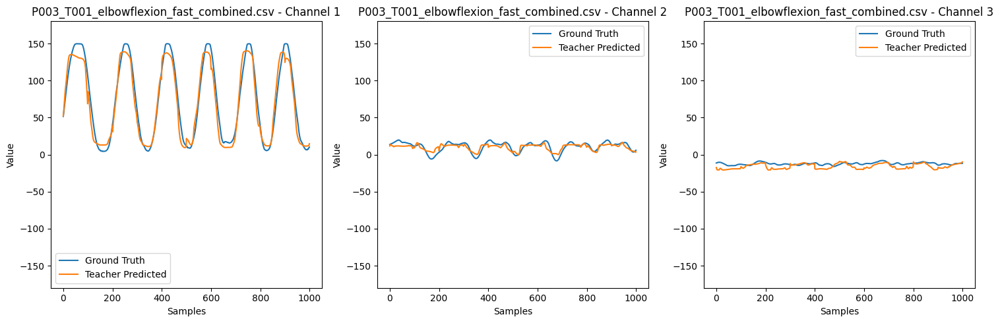

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_slow_combined.csv


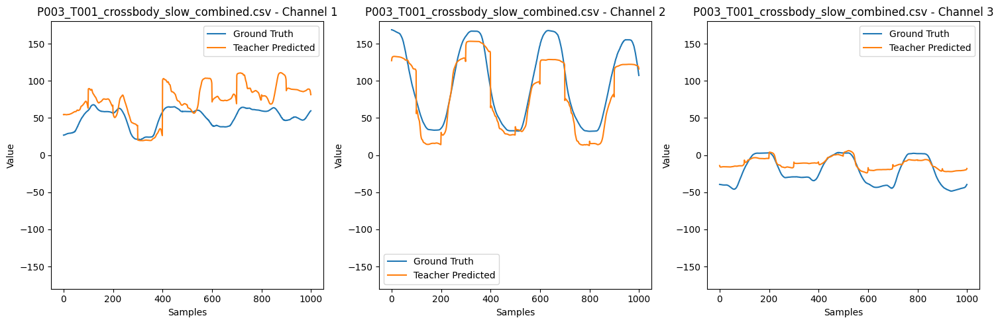

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_normal_combined.csv


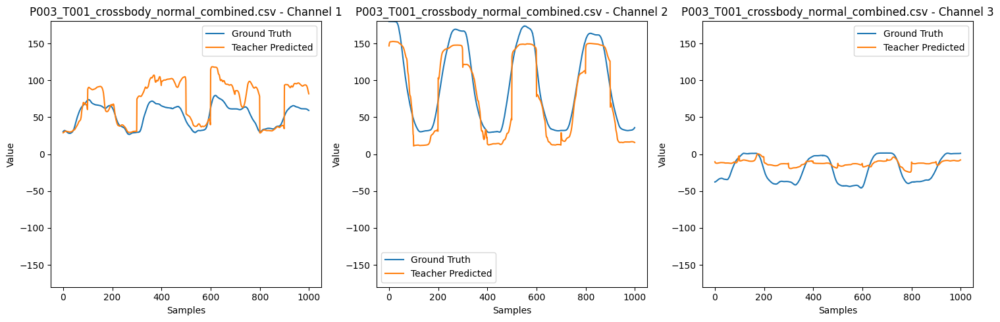

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_fast_combined.csv


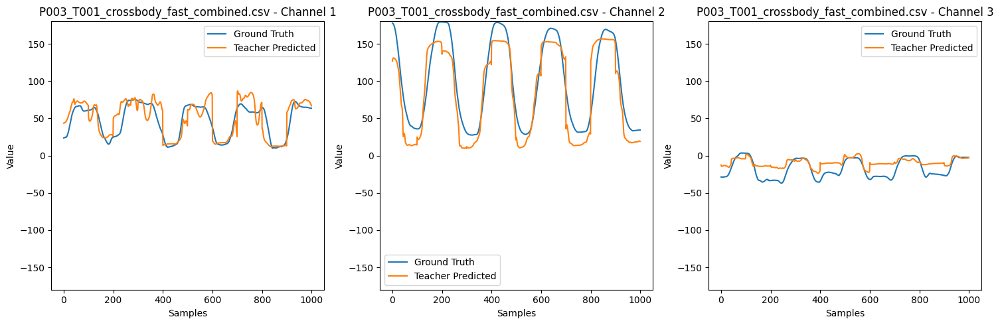

End of iteration
_________________________________________________________
Training subjects: ['subject_2']
Testing subject: subject_6
Dataset name: dataset_wl100_ol75_train['subject_2']_test['subject_6']
Training subjects: ['subject_2']
Testing subjects: ['subject_6']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_2:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_normal_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_veryfast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_6:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_slow_combined:   0%|          | 0/112 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_veryfast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_slow_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Epoch: 1, time: 1.3857, Training Loss: 2690.7850, Validation Loss: 1056.9983
Epoch: 2, time: 1.3584, Training Loss: 967.8907, Validation Loss: 661.3644
Epoch: 3, time: 1.3044, Training Loss: 479.9518, Validation Loss: 350.8006
Epoch: 4, time: 1.3115, Training Loss: 223.6097, Validation Loss: 153.0313
Epoch: 5, time: 1.3118, Training Loss: 127.8649, Validation Loss: 108.4015
Epoch: 6, time: 1.3161, Training Loss: 94.4453, Validation Loss: 74.9063
Epoch: 7, time: 1.4480, Training Loss: 73.4710, Validation Loss: 70.7699
Epoch: 8, time: 1.5202, Training Loss: 65.4328, Validation Loss: 47.6944
Epoch: 9, time: 1.3327, Training Loss: 52.7562, Validation Loss: 38.3899
Epoch: 10, time: 1.3142, Training Loss: 46.0891, Validation Loss: 42.9983
Training time: 14.755032539367676 seconds
________________________________
Training set metrics
RMSE per channel: [6.02792263 6.42071676 5.93705654]
6.027922
6.4207172
5.9370556


0.9890746652184231
0.995449622812638
0.8672993088172256
Mean: 6.129 +/- 0.257

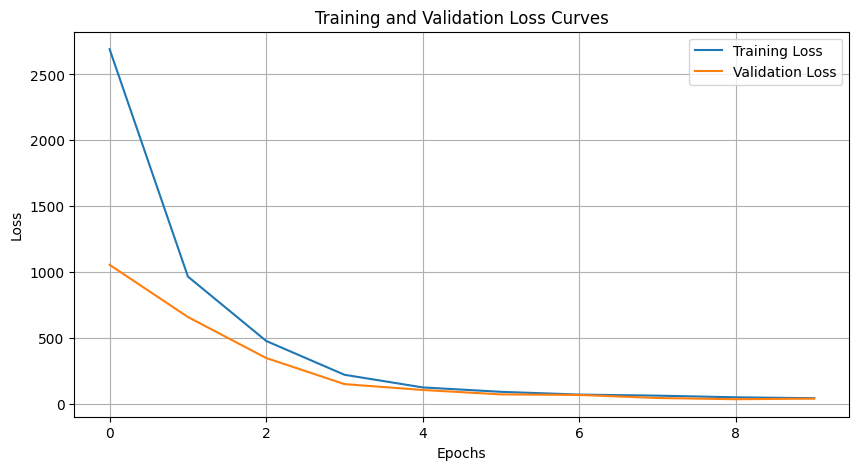

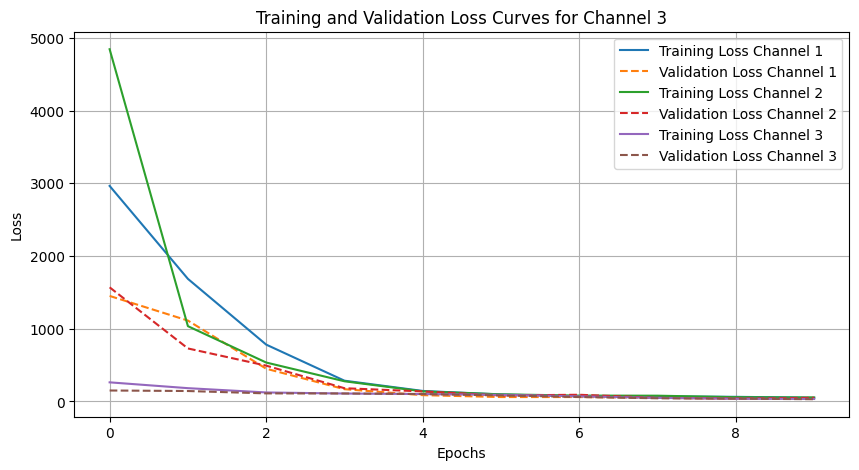

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_slow_combined.csv


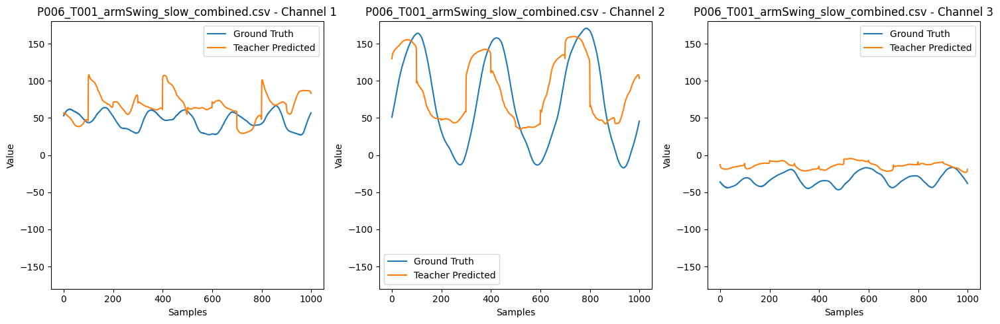

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_normal_combined.csv


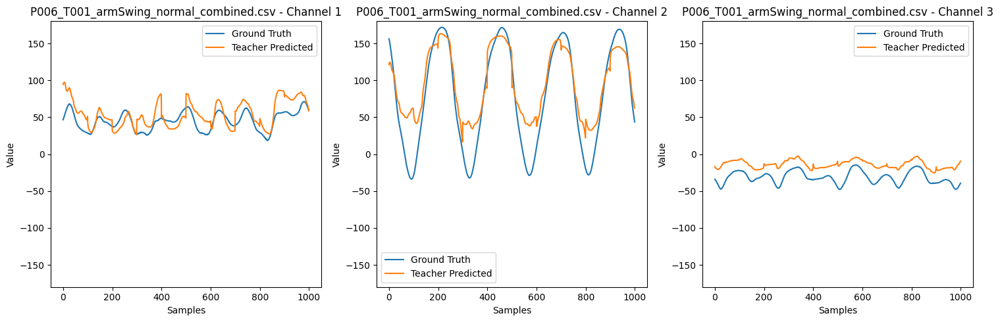

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_veryfast_combined.csv


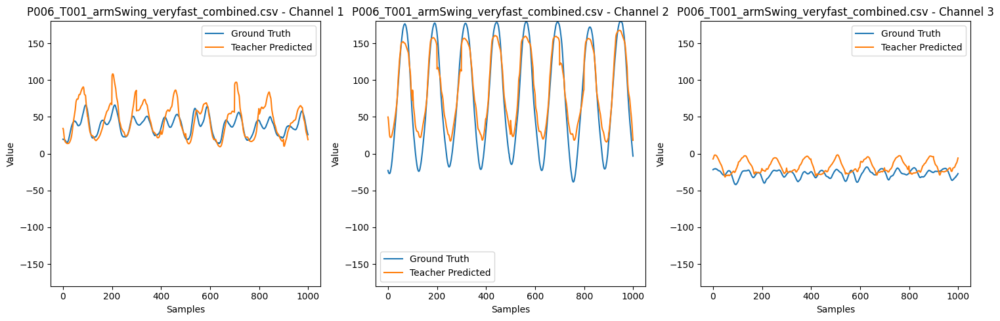

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_fast_combined.csv


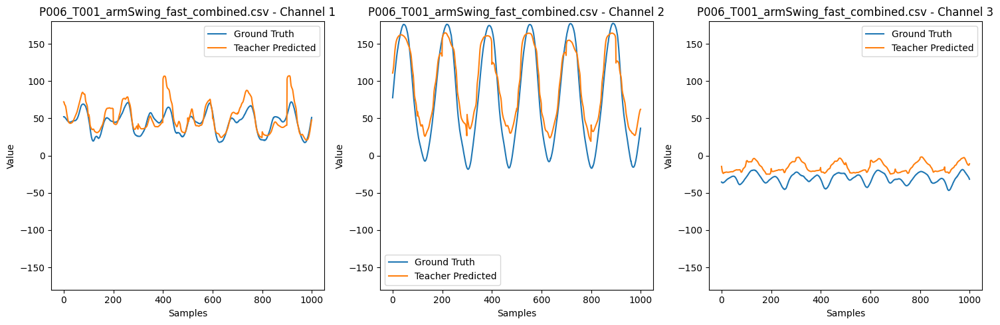

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_slow_combined.csv


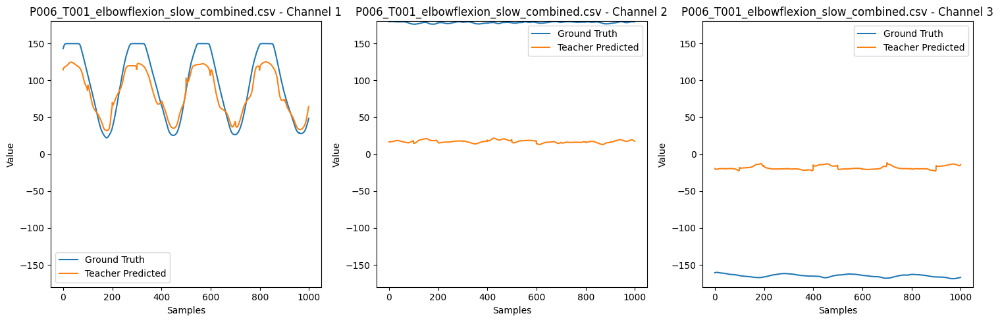

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_normal_combined.csv


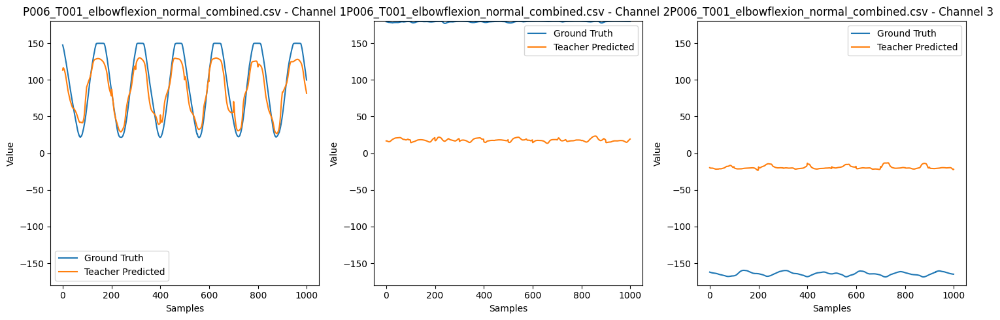

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_fast_combined.csv


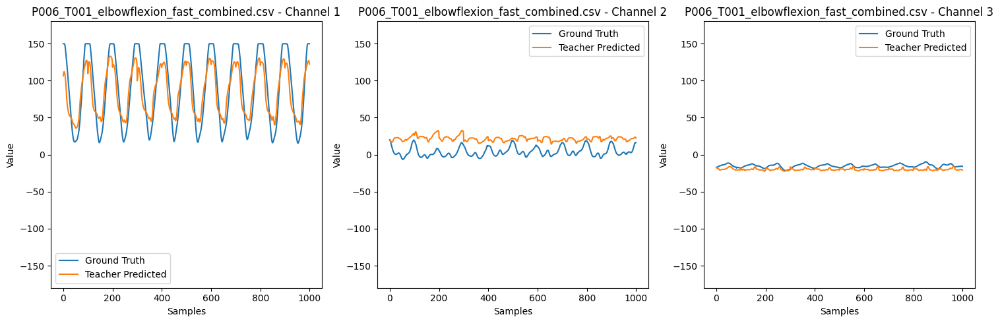

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_slow_combined.csv


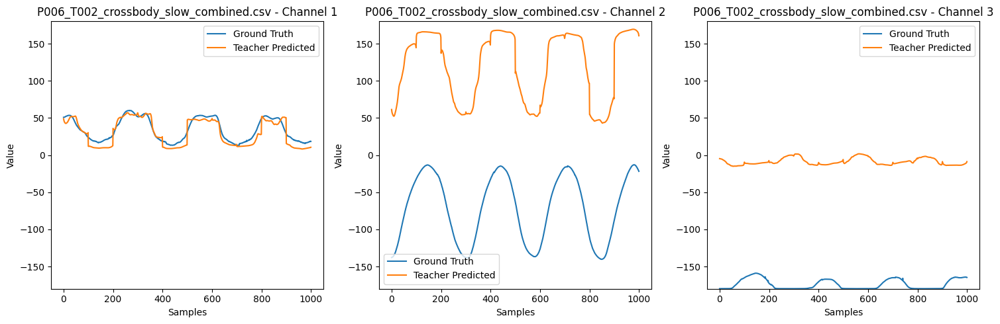

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_normal_combined.csv


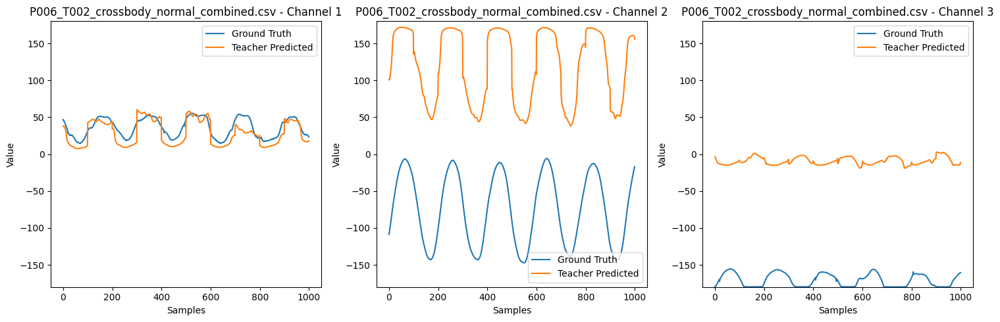

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_fast_combined.csv


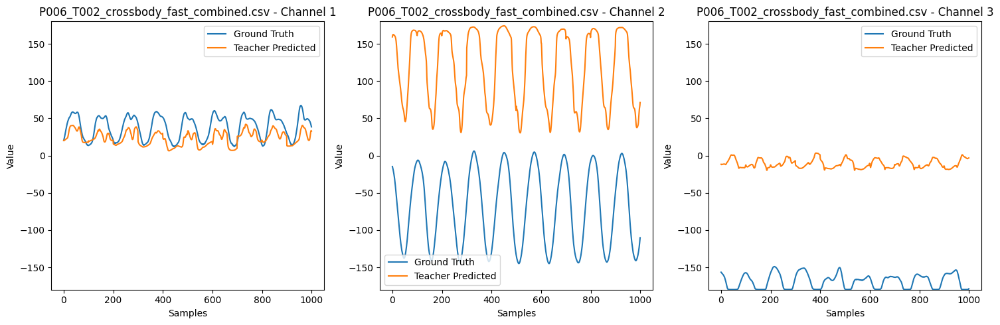

End of iteration
_________________________________________________________
Training subjects: ['subject_2']
Testing subject: subject_7
Dataset name: dataset_wl100_ol75_train['subject_2']_test['subject_7']
Training subjects: ['subject_2']
Testing subjects: ['subject_7']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_2:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_normal_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_veryfast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_7:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T002_armSwing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_normal_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_veryfast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_slow_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Epoch: 1, time: 1.4145, Training Loss: 2667.5654, Validation Loss: 1040.5231
Epoch: 2, time: 1.3123, Training Loss: 944.6779, Validation Loss: 628.3952
Epoch: 3, time: 1.3203, Training Loss: 493.4518, Validation Loss: 338.1588
Epoch: 4, time: 1.3153, Training Loss: 245.3293, Validation Loss: 164.2969
Epoch: 5, time: 1.3452, Training Loss: 147.2266, Validation Loss: 117.3777
Epoch: 6, time: 1.2989, Training Loss: 112.0385, Validation Loss: 97.4096
Epoch: 7, time: 1.3197, Training Loss: 85.1799, Validation Loss: 68.0961
Epoch: 8, time: 1.3208, Training Loss: 62.9877, Validation Loss: 58.5092
Epoch: 9, time: 1.3518, Training Loss: 60.2711, Validation Loss: 49.8385
Epoch: 10, time: 1.3339, Training Loss: 50.1582, Validation Loss: 47.0838
Training time: 14.212296724319458 seconds
________________________________
Training set metrics
RMSE per channel: [7.74430656 6.66949654 5.62361956]
7.7443066
6.6694965
5.62362


0.9883768891019337
0.9953885514957832
0.8824616317121896
Mean: 6.679 +/- 1.06

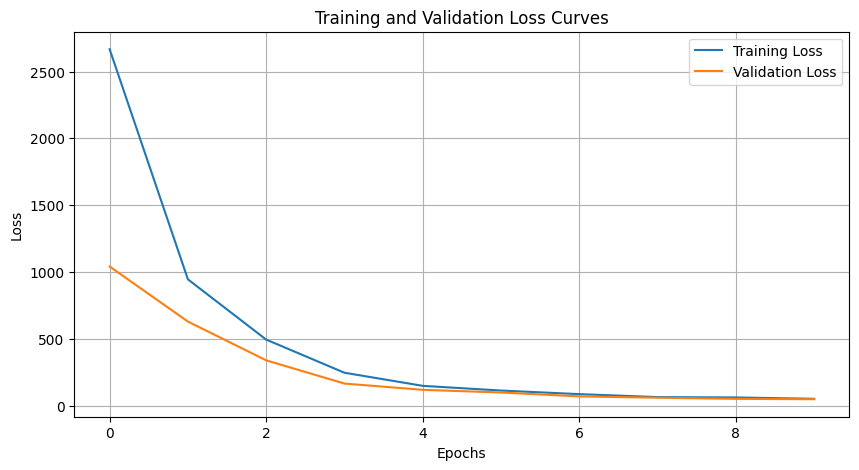

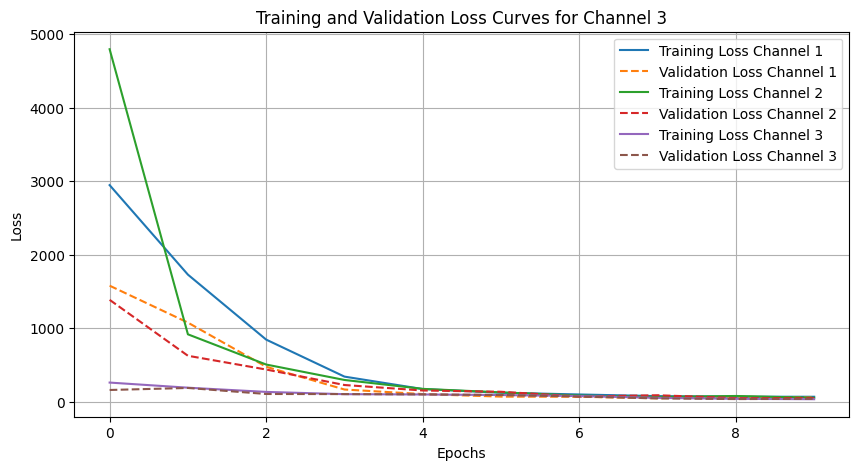

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T002_armSwing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T002_armSwing_slow_combined.csv


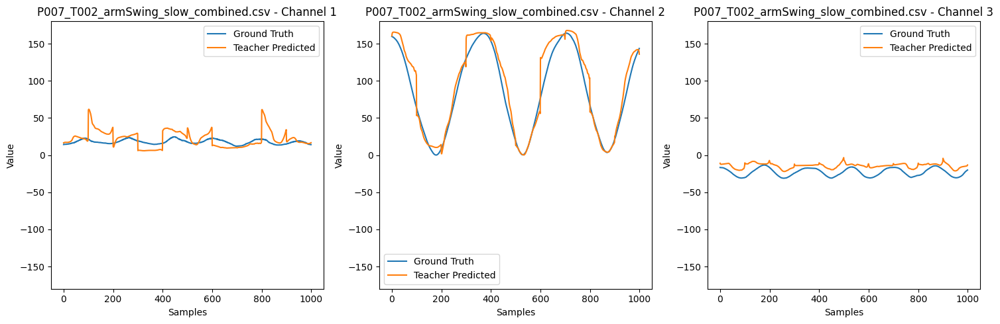

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_normal_combined.csv


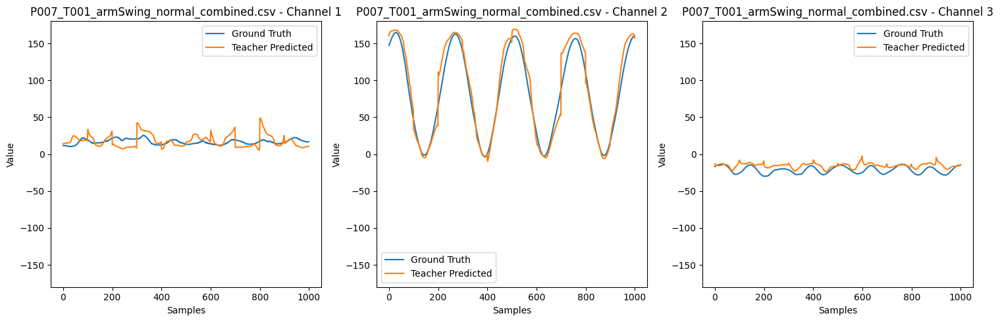

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_fast_combined.csv


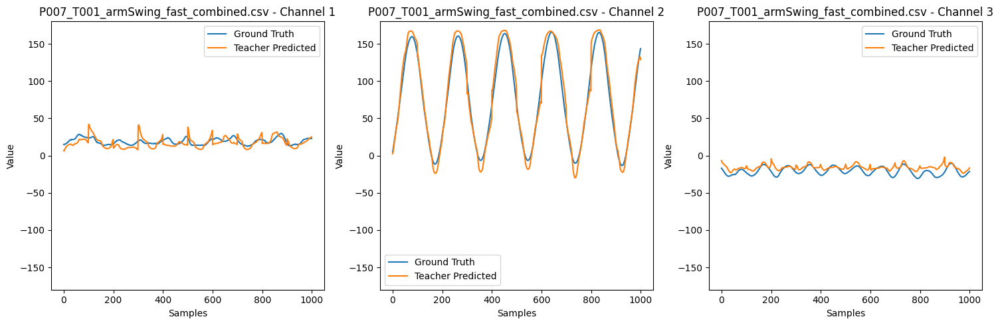

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_veryfast_combined.csv


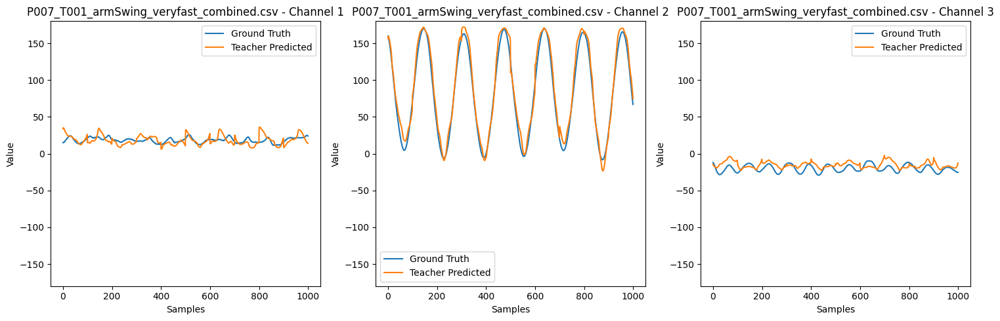

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_slow_combined.csv


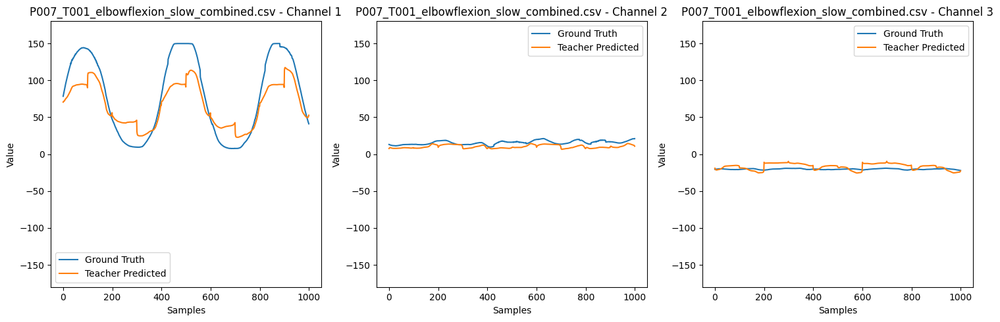

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_normal_combined.csv


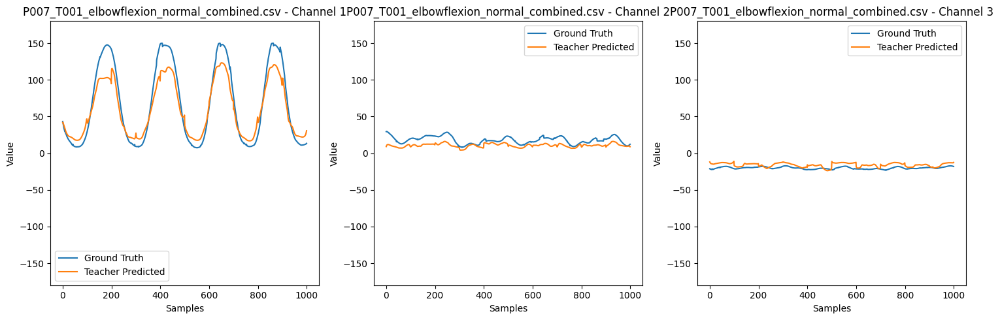

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_fast_combined.csv


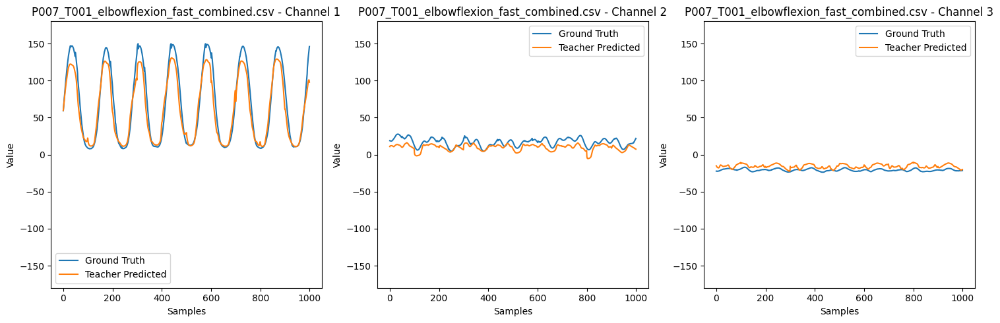

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_slow_combined.csv


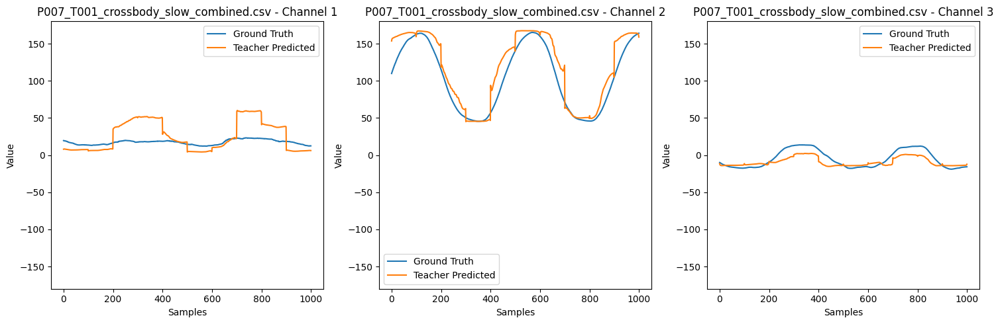

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_fast_combined.csv


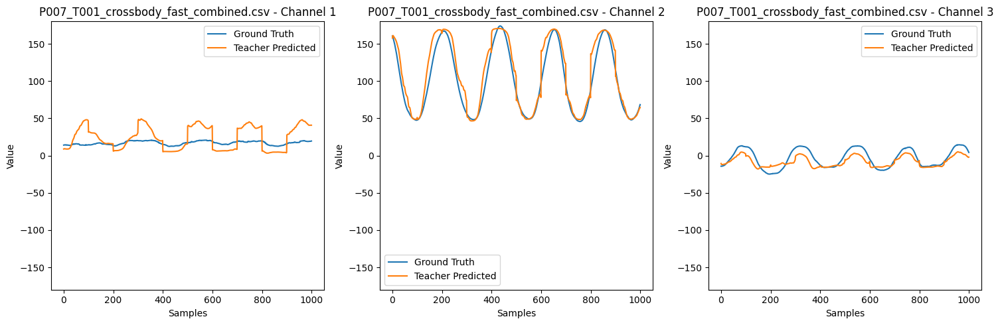

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_normal_combined.csv


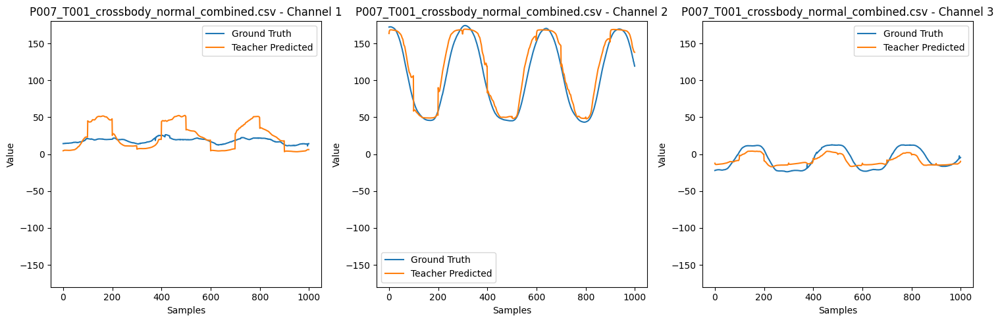

End of iteration
_________________________________________________________
Training subjects: ['subject_2']
Testing subject: subject_9
Dataset name: dataset_wl100_ol75_train['subject_2']_test['subject_9']
Training subjects: ['subject_2']
Testing subjects: ['subject_9']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_2:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_normal_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_veryfast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_9:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_normal_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_veryfast_combined:   0%|          | 0/123 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_elbowflexion_slow_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_elbowflexion_normal_combined:   0%|          | 0/127 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_crossbody_normal_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_crossbody_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Epoch: 1, time: 1.3517, Training Loss: 2675.0189, Validation Loss: 1101.8865
Epoch: 2, time: 1.2835, Training Loss: 951.7060, Validation Loss: 631.8813
Epoch: 3, time: 1.2784, Training Loss: 513.0753, Validation Loss: 344.7049
Epoch: 4, time: 1.2995, Training Loss: 250.0878, Validation Loss: 178.6107
Epoch: 5, time: 1.2977, Training Loss: 131.2966, Validation Loss: 99.1123
Epoch: 6, time: 1.3012, Training Loss: 96.8501, Validation Loss: 78.3401
Epoch: 7, time: 1.3483, Training Loss: 85.5206, Validation Loss: 61.8422
Epoch: 8, time: 1.3325, Training Loss: 59.8184, Validation Loss: 60.9634
Epoch: 9, time: 1.3558, Training Loss: 67.6743, Validation Loss: 44.8564
Epoch: 10, time: 1.3770, Training Loss: 47.4985, Validation Loss: 37.0377
Training time: 14.165492057800293 seconds
________________________________
Training set metrics
RMSE per channel: [6.44298744 5.80653048 5.64227867]
6.4429874
5.8065305
5.6422796


0.9882217073250923
0.9957732401111681
0.8744051210116576
Mean: 5.964 +/- 0.42

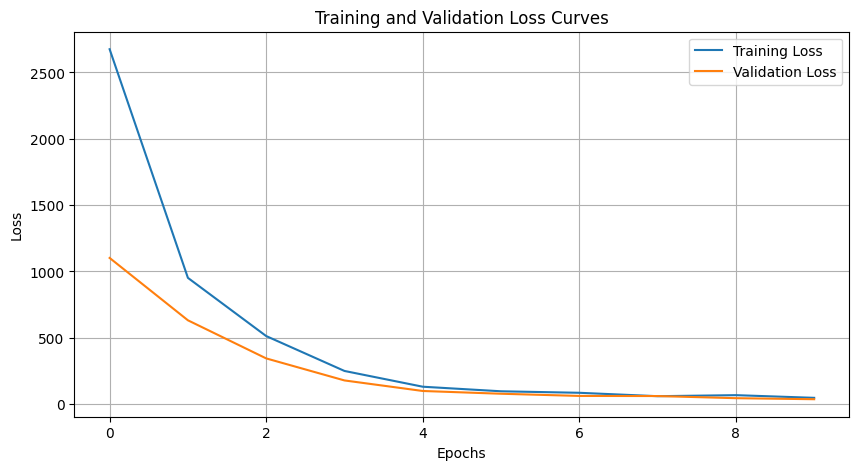

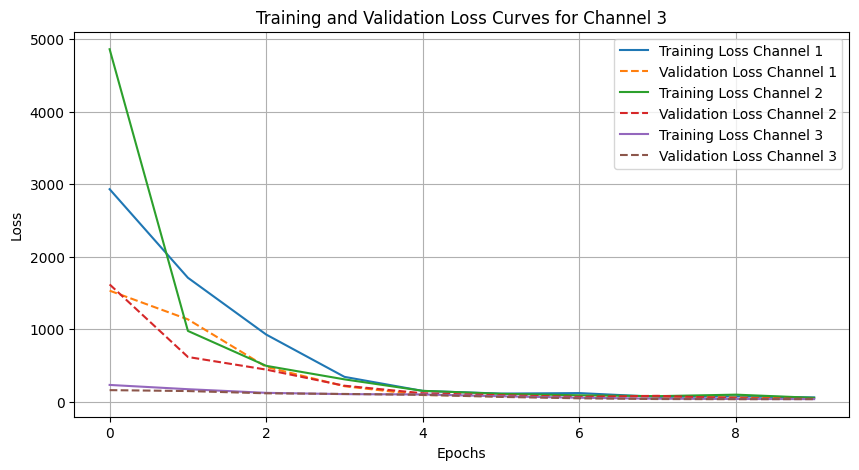

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_slow_combined.csv


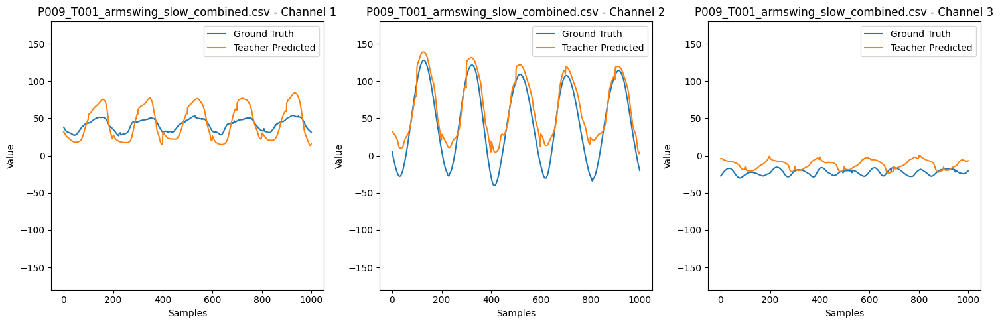

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_normal_combined.csv


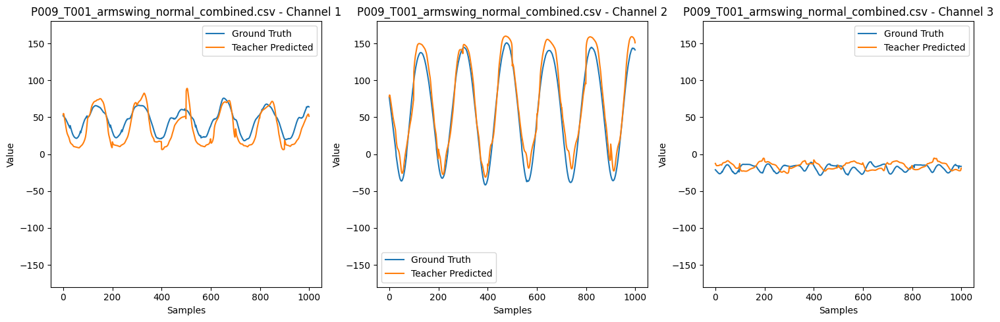

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_fast_combined.csv


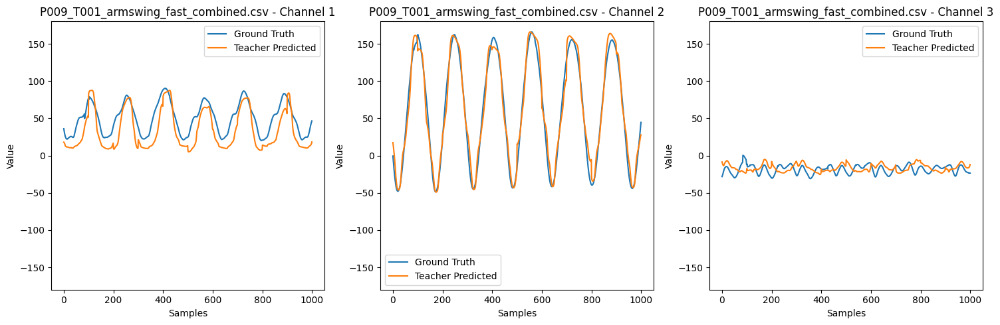

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_veryfast_combined.csv


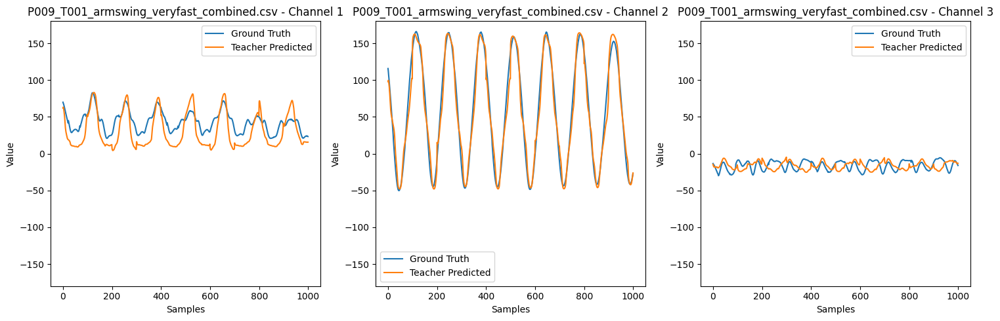

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_slow_combined.csv


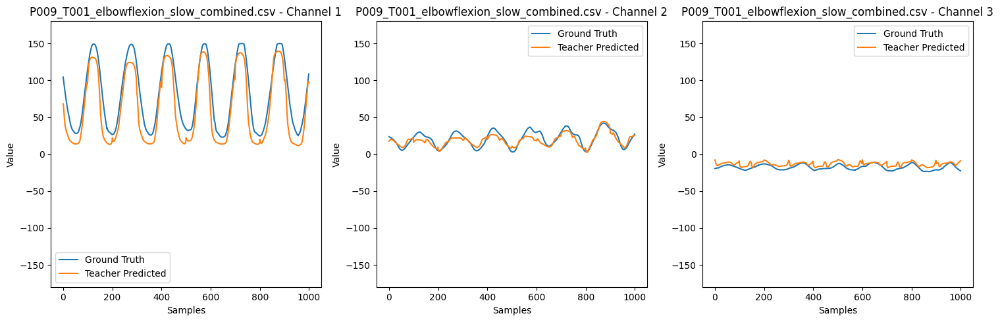

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_normal_combined.csv


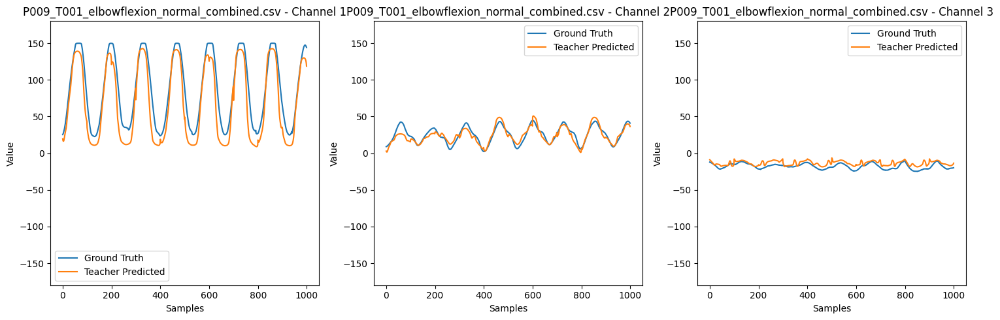

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_elbowflexion_fast_combined.csv


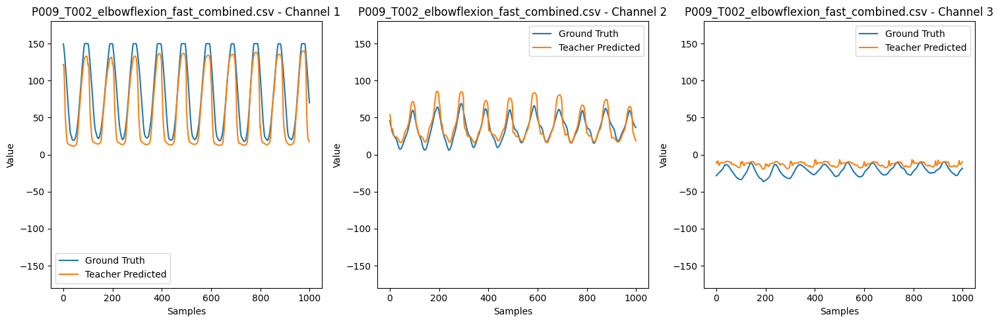

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_slow_combined.csv


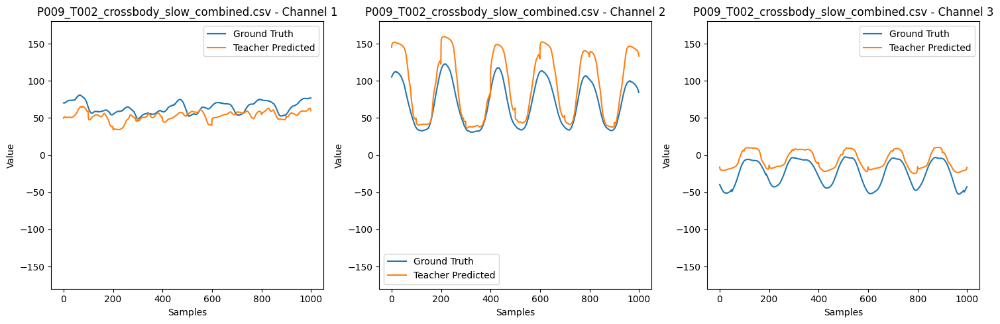

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_normal_combined.csv


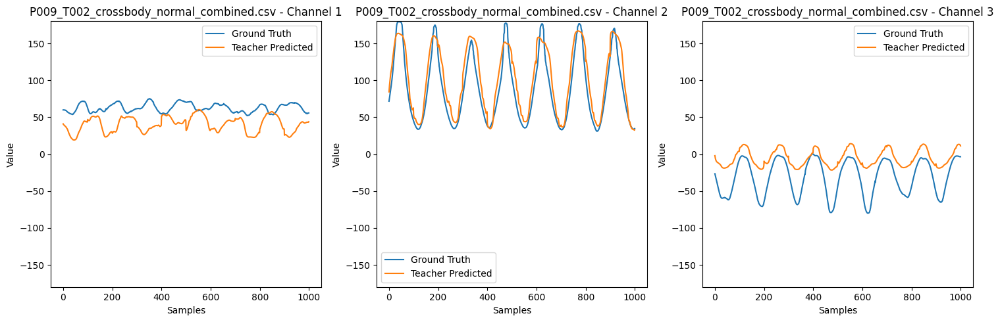

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_fast_combined.csv


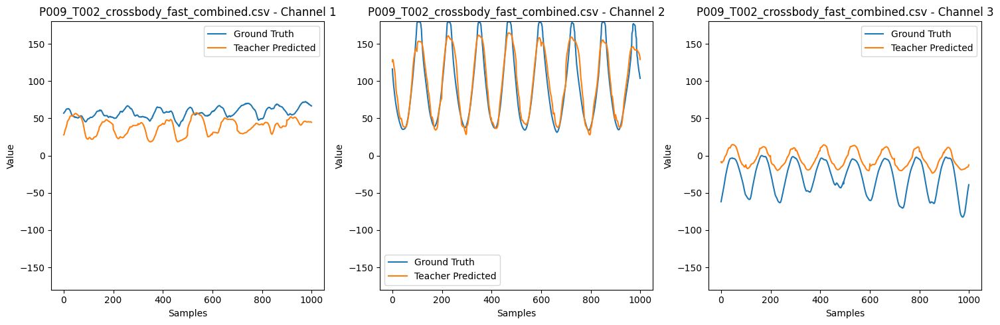

End of iteration
_________________________________________________________
Training subjects: ['subject_3']
Testing subject: subject_1
Dataset name: dataset_wl100_ol75_train['subject_3']_test['subject_1']
Training subjects: ['subject_3']
Testing subjects: ['subject_1']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_3:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_normal_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_fast_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T003_armswing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_veryfast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_slow_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_slow_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_fast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_1:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_fast_combined:   0%|          | 0/130 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_slow_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_normal_combined:   0%|          | 0/127 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_normal_combined:   0%|          | 0/131 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_fast_combined:   0%|          | 0/126 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_slow_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_veryfast_combined:   0%|          | 0/123 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_slow_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Epoch: 1, time: 1.6989, Training Loss: 2871.1578, Validation Loss: 1311.9360
Epoch: 2, time: 1.3694, Training Loss: 952.8832, Validation Loss: 526.6652
Epoch: 3, time: 1.3701, Training Loss: 362.1199, Validation Loss: 178.9210
Epoch: 4, time: 1.3446, Training Loss: 146.0910, Validation Loss: 96.4288
Epoch: 5, time: 1.3645, Training Loss: 94.6501, Validation Loss: 69.1189
Epoch: 6, time: 1.3613, Training Loss: 66.0273, Validation Loss: 54.3815
Epoch: 7, time: 1.3589, Training Loss: 56.0525, Validation Loss: 46.5069
Epoch: 8, time: 1.4569, Training Loss: 52.3572, Validation Loss: 37.1671
Epoch: 9, time: 1.4246, Training Loss: 44.8683, Validation Loss: 27.5227
Epoch: 10, time: 1.6076, Training Loss: 40.2051, Validation Loss: 44.8647
Training time: 15.513413906097412 seconds
________________________________
Training set metrics
RMSE per channel: [5.24296665 5.86941242 5.09427595]
5.242967
5.8694124
5.094276


0.9900164226280764
0.9963965668731056
0.8766101438851005
Mean: 5.402 +/- 0.411
Me

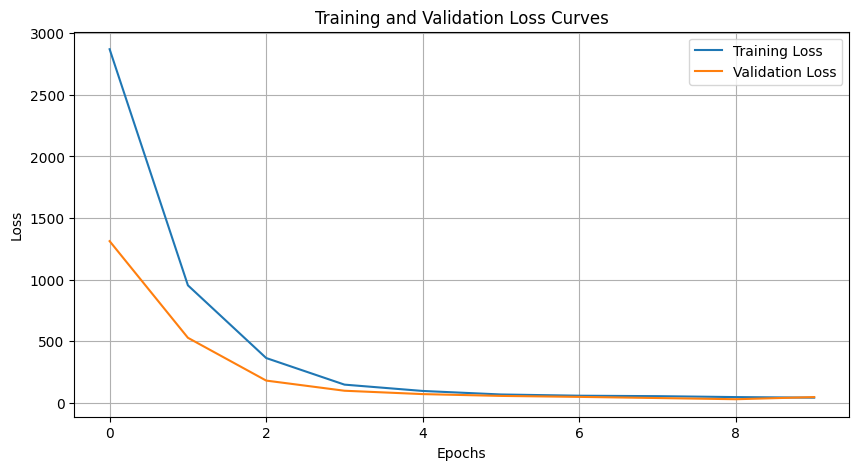

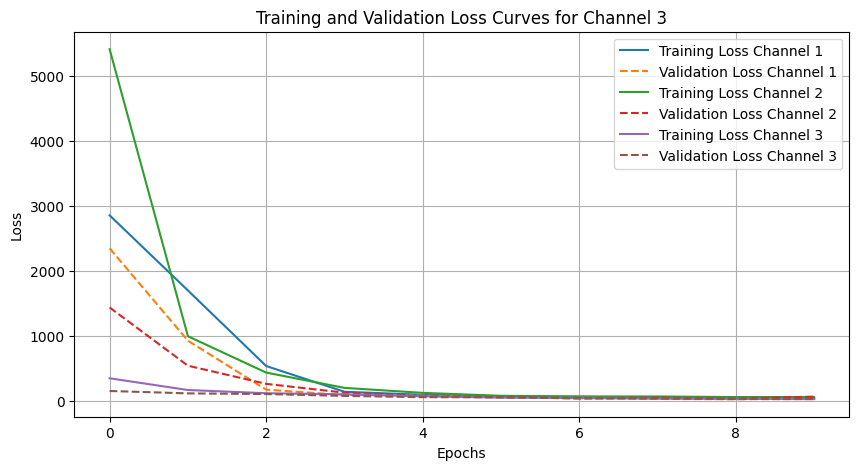

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_fast_combined.csv


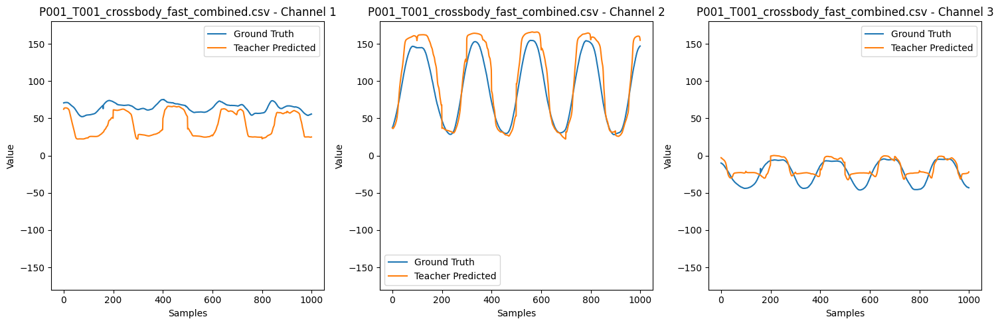

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_slow_combined.csv


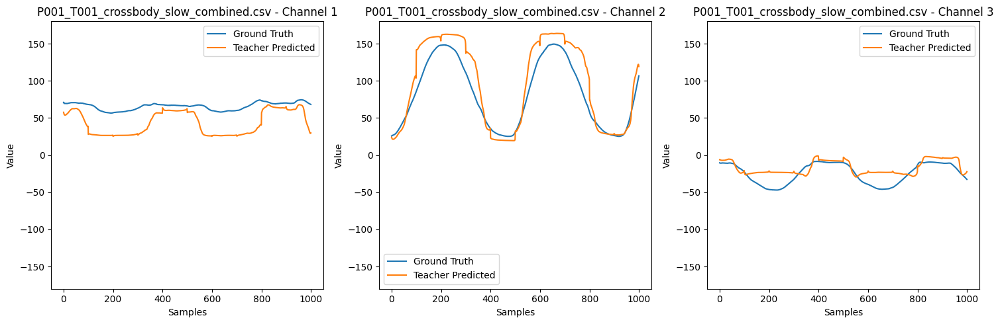

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_fast_combined.csv


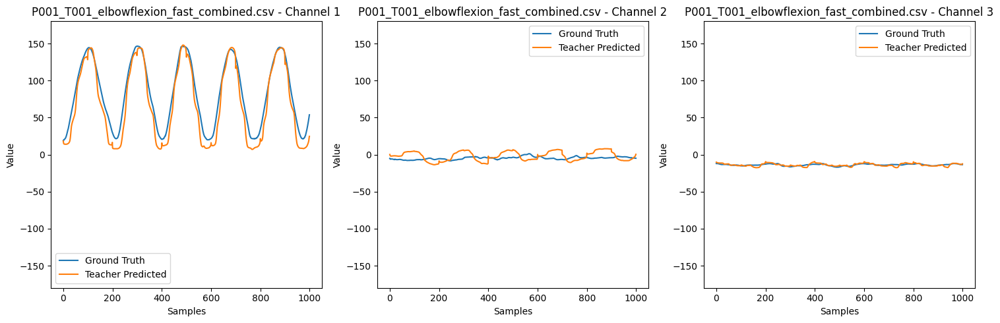

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_normal_combined.csv


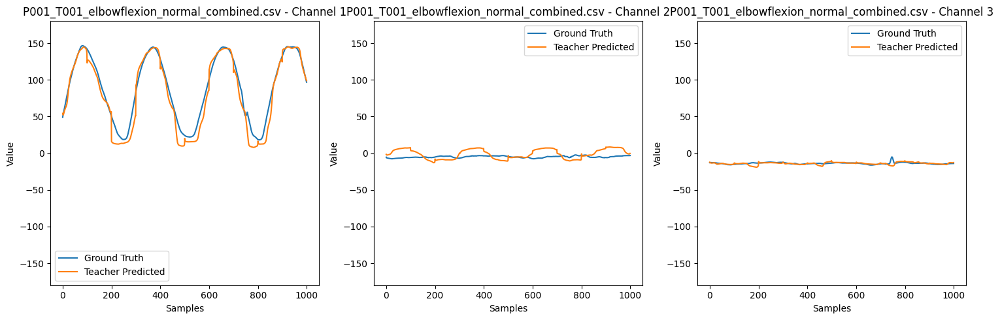

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_normal_combined.csv


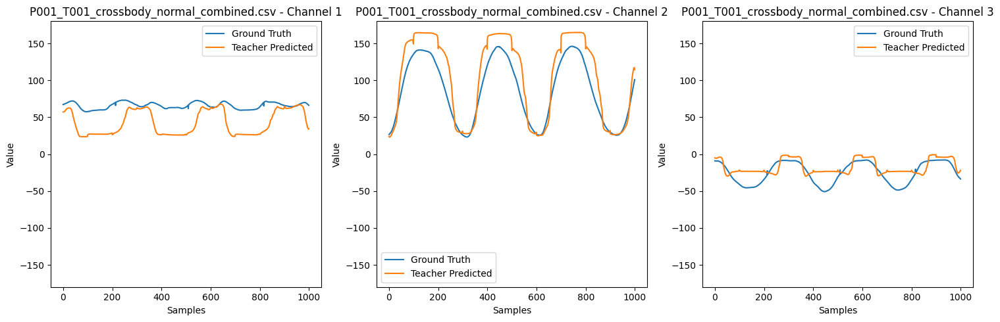

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_fast_combined.csv


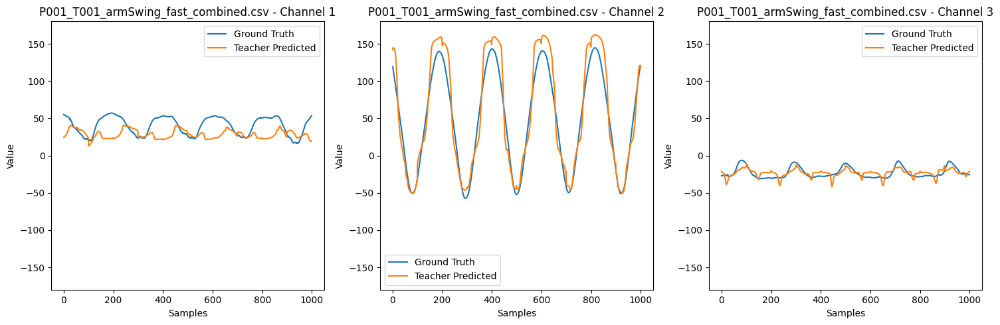

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_normal_combined.csv


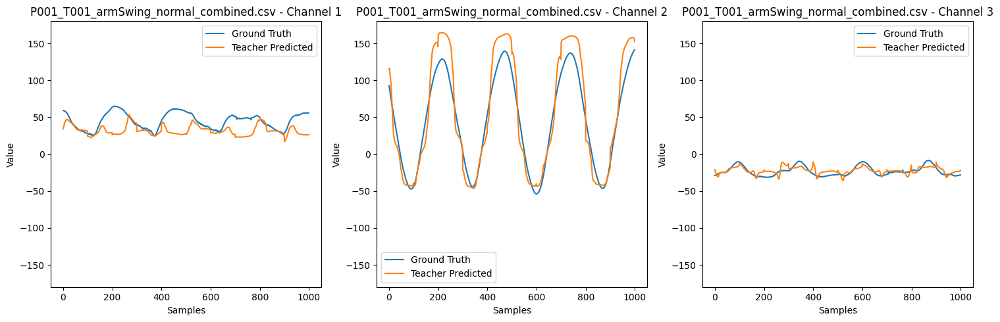

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_slow_combined.csv


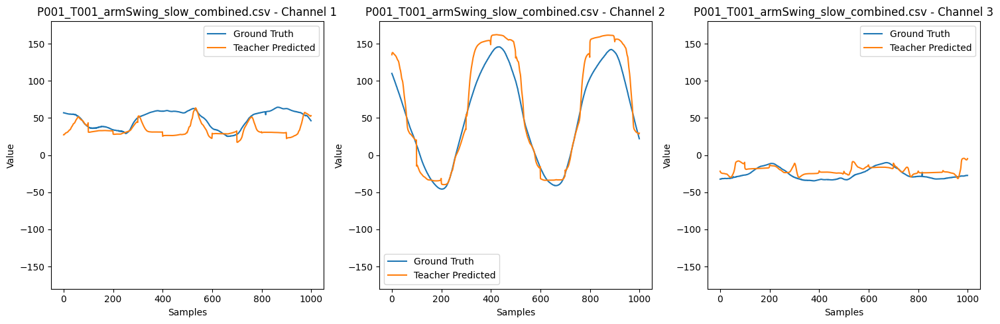

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_veryfast_combined.csv


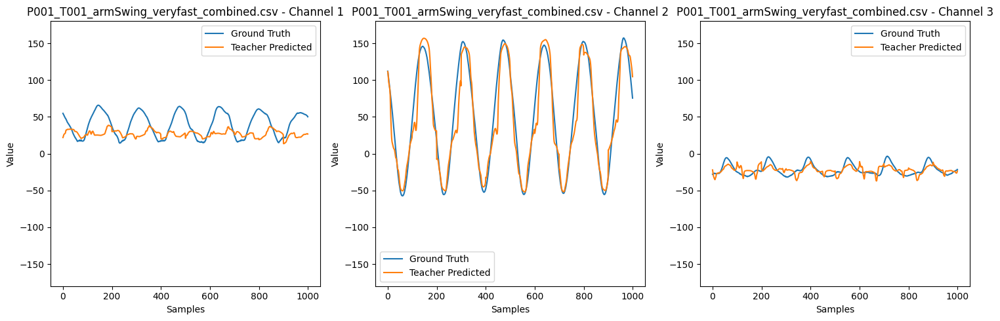

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_slow_combined.csv


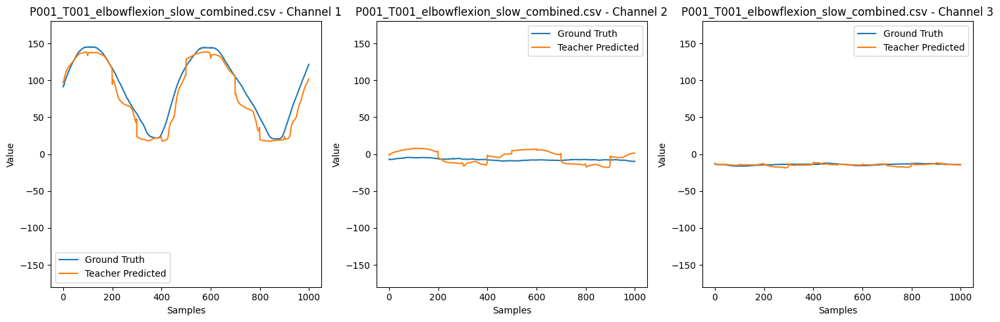

End of iteration
_________________________________________________________
Training subjects: ['subject_3']
Testing subject: subject_2
Dataset name: dataset_wl100_ol75_train['subject_3']_test['subject_2']
Training subjects: ['subject_3']
Testing subjects: ['subject_2']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_3:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_normal_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_fast_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T003_armswing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_veryfast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_slow_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_slow_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_fast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_2:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_normal_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_veryfast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Epoch: 1, time: 1.4758, Training Loss: 2797.0075, Validation Loss: 1174.4708
Epoch: 2, time: 1.3344, Training Loss: 770.4201, Validation Loss: 389.3319
Epoch: 3, time: 1.3264, Training Loss: 258.0449, Validation Loss: 144.1026
Epoch: 4, time: 1.3537, Training Loss: 125.6415, Validation Loss: 93.2660
Epoch: 5, time: 1.3968, Training Loss: 85.9397, Validation Loss: 65.2465
Epoch: 6, time: 1.3907, Training Loss: 67.9069, Validation Loss: 50.8713
Epoch: 7, time: 1.3823, Training Loss: 57.5243, Validation Loss: 57.8268
Epoch: 8, time: 1.3828, Training Loss: 49.8401, Validation Loss: 46.5471
Epoch: 9, time: 1.4859, Training Loss: 43.4404, Validation Loss: 40.9494
Epoch: 10, time: 1.4329, Training Loss: 40.0719, Validation Loss: 42.5305
Training time: 14.690727233886719 seconds
________________________________
Training set metrics
RMSE per channel: [5.42208815 8.52242947 5.21081591]
5.422088
8.522429
5.2108154


0.9895175825529651
0.9949650193391499
0.8688723496407038
Mean: 6.385 +/- 1.854
Me

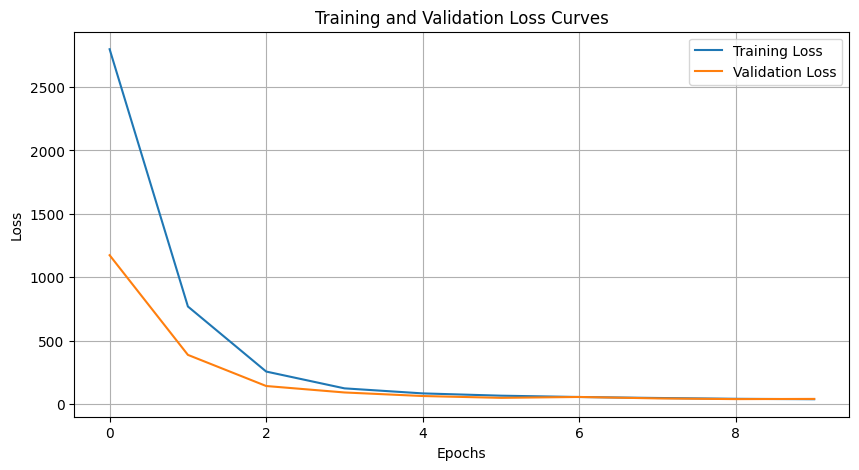

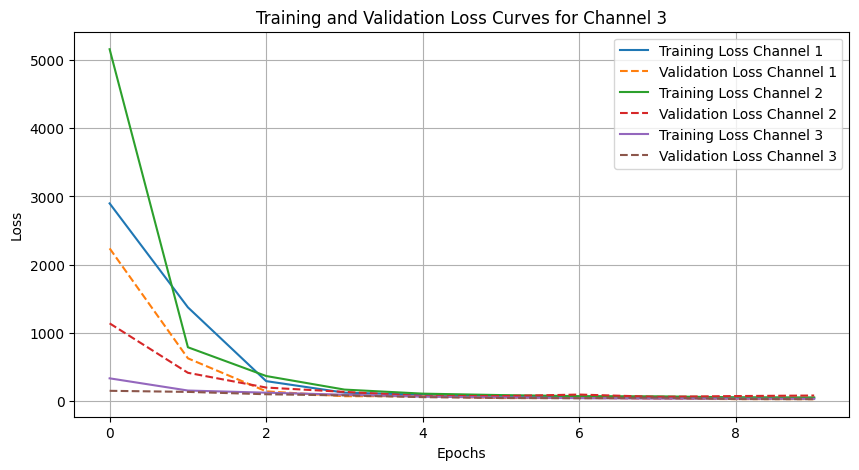

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_slow_combined.csv


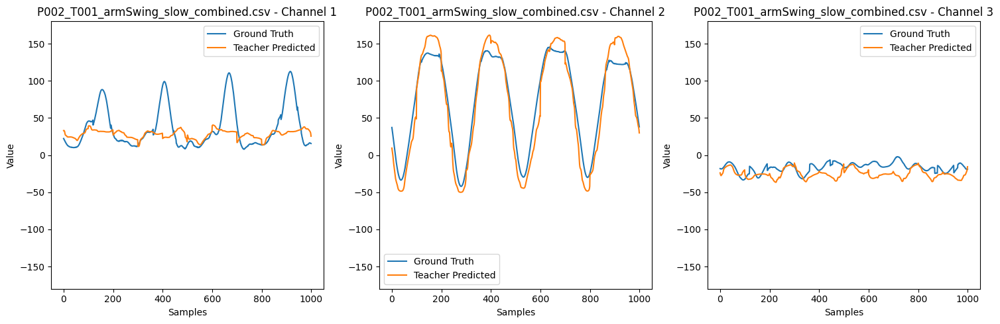

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_normal_combined.csv


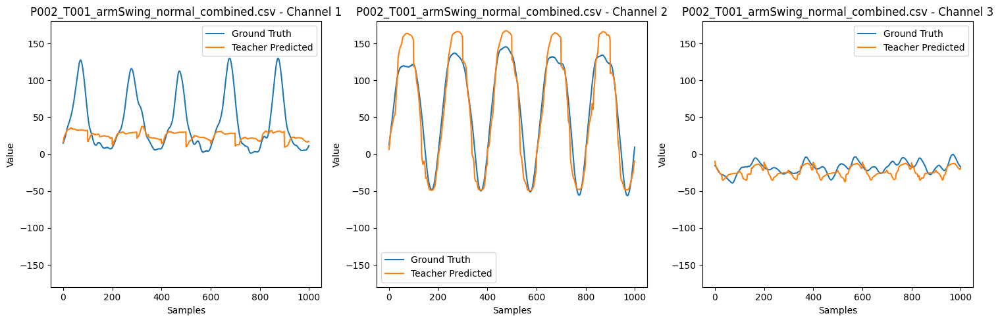

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_fast_combined.csv


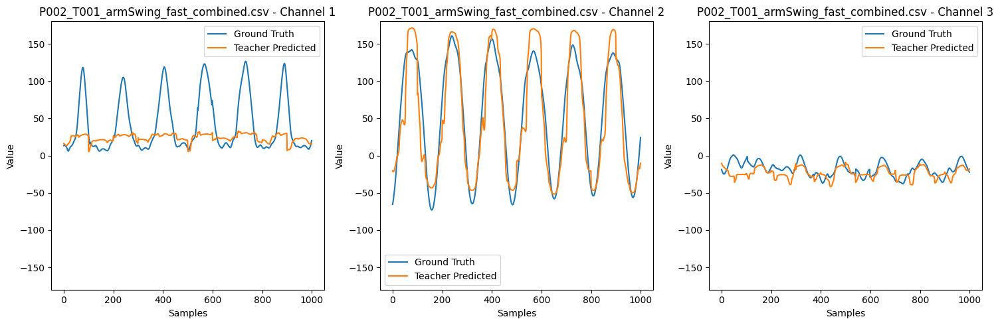

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_veryfast_combined.csv


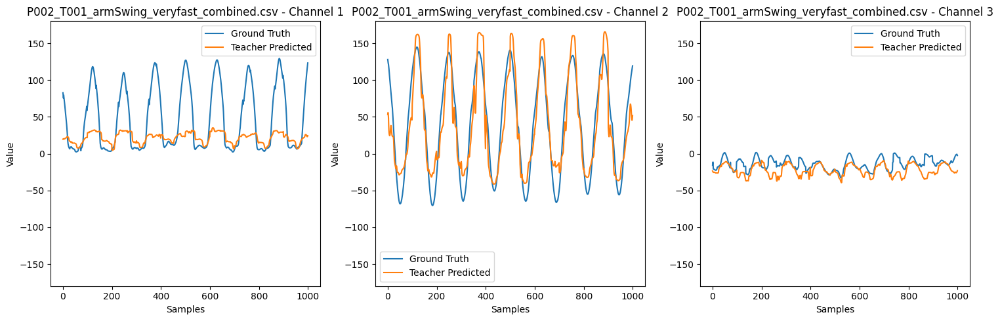

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_slow_combined.csv


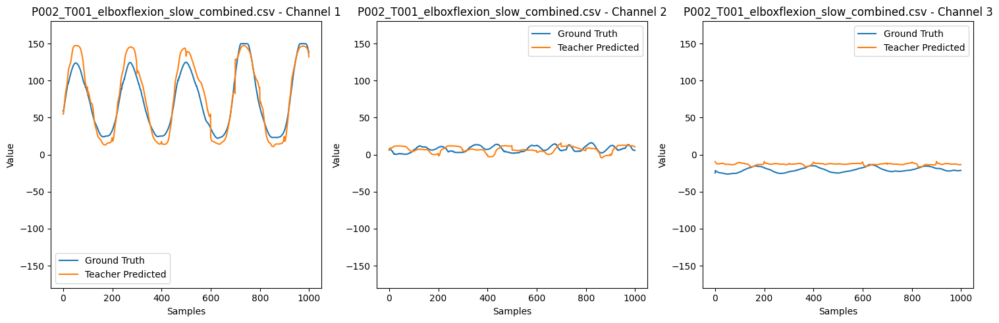

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_normal_combined.csv


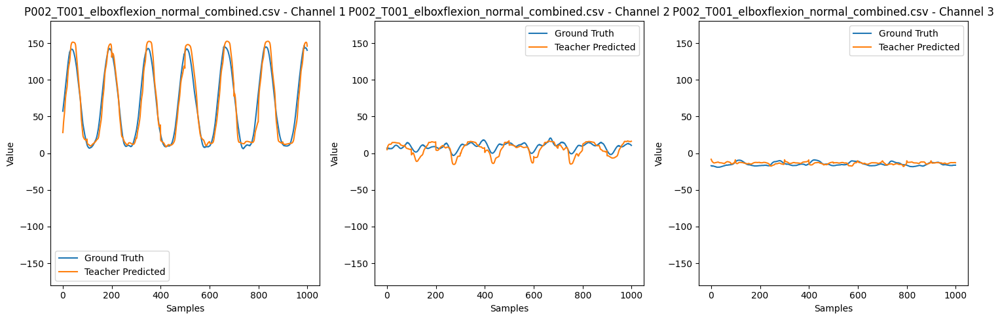

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_fast_combined.csv


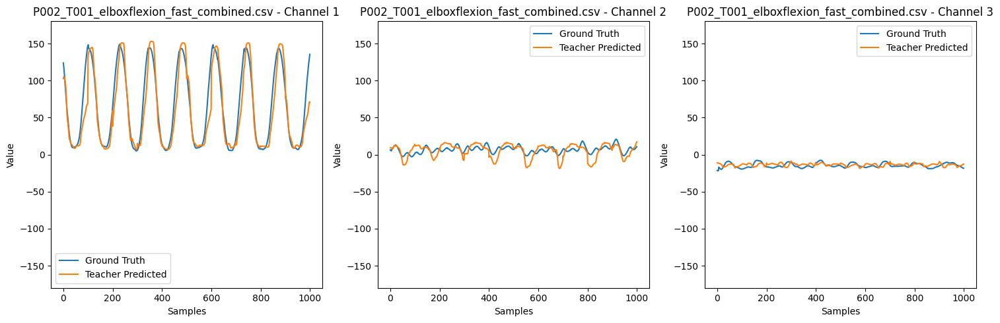

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_slow_combined.csv


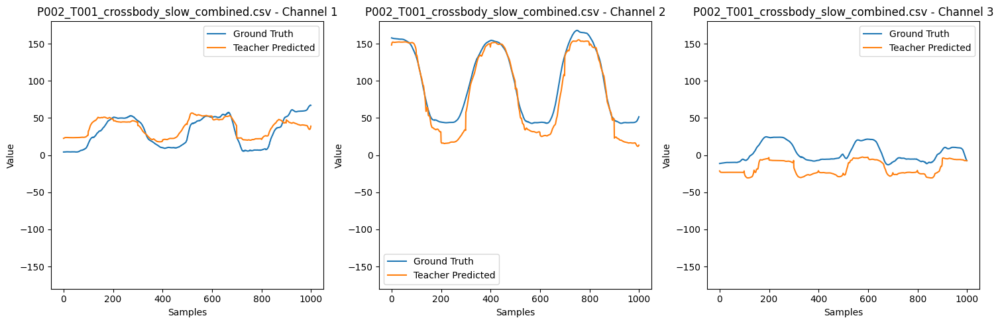

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_normal_combined.csv


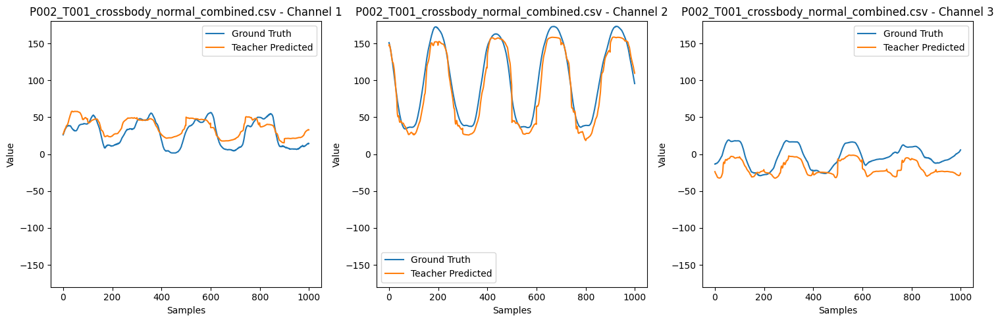

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_fast_combined.csv


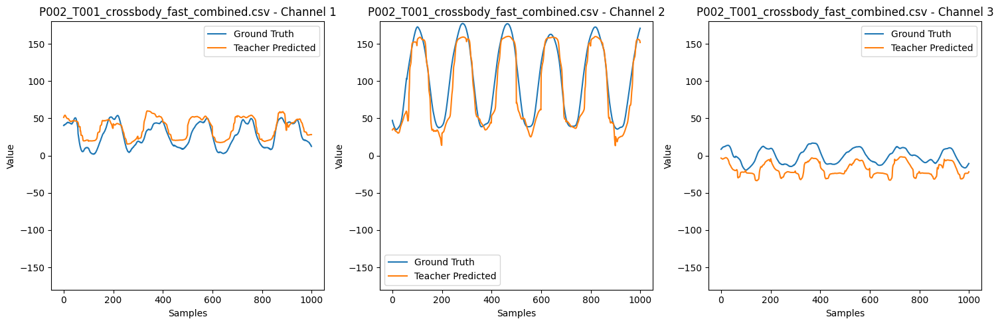

End of iteration
_________________________________________________________
Training subjects: ['subject_3']
Testing subject: subject_6
Dataset name: dataset_wl100_ol75_train['subject_3']_test['subject_6']
Training subjects: ['subject_3']
Testing subjects: ['subject_6']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_3:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_normal_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_fast_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T003_armswing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_veryfast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_slow_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_slow_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_fast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_6:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_slow_combined:   0%|          | 0/112 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_veryfast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_slow_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Epoch: 1, time: 1.4220, Training Loss: 2831.2376, Validation Loss: 1212.0040
Epoch: 2, time: 1.3373, Training Loss: 938.5575, Validation Loss: 534.0759
Epoch: 3, time: 1.3339, Training Loss: 365.2858, Validation Loss: 184.3107
Epoch: 4, time: 1.3423, Training Loss: 138.5140, Validation Loss: 85.0905
Epoch: 5, time: 1.3574, Training Loss: 79.9118, Validation Loss: 89.4908
Epoch: 6, time: 1.3522, Training Loss: 73.6331, Validation Loss: 50.0983
Epoch: 7, time: 1.3742, Training Loss: 52.6686, Validation Loss: 41.7483
Epoch: 8, time: 1.3765, Training Loss: 45.5882, Validation Loss: 28.0103
Epoch: 9, time: 1.3755, Training Loss: 43.8168, Validation Loss: 33.0001
Epoch: 10, time: 1.3871, Training Loss: 35.2514, Validation Loss: 30.6787
Training time: 14.278007745742798 seconds
________________________________
Training set metrics
RMSE per channel: [5.47511292 5.86619711 5.0671854 ]
5.475113
5.866197
5.067186


0.9902429015802873
0.9963372834878982
0.8786614467714038
Mean: 5.469 +/- 0.400
Mea

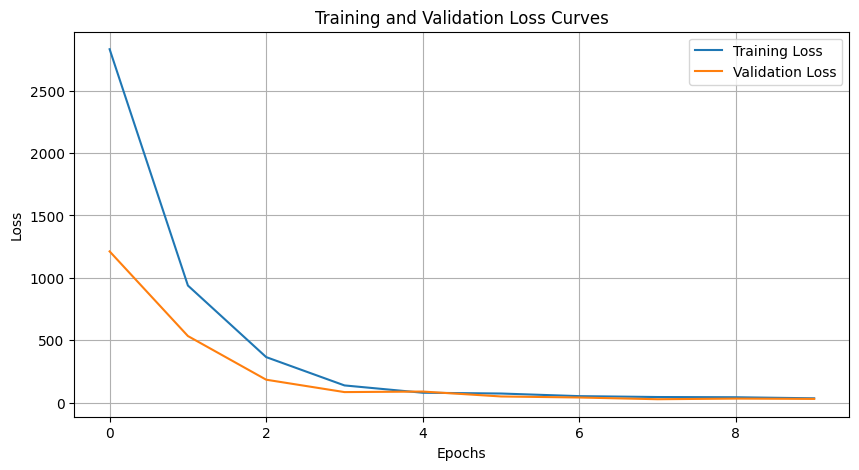

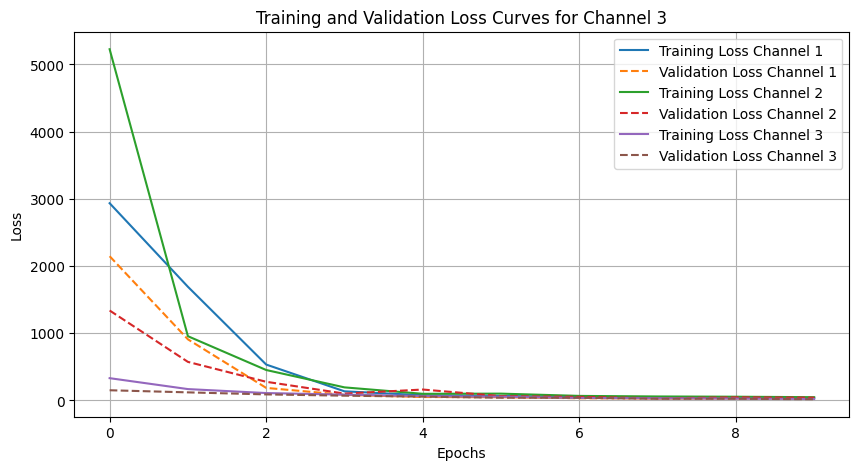

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_slow_combined.csv


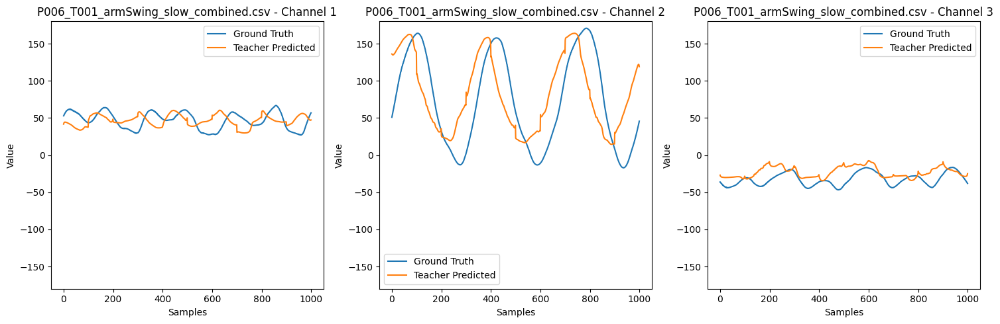

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_normal_combined.csv


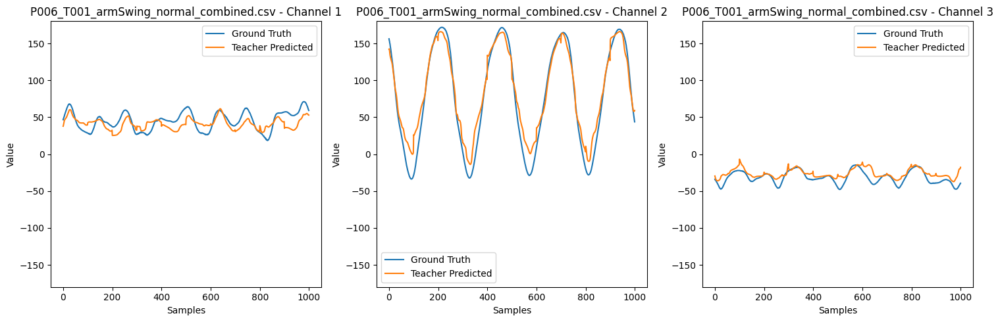

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_veryfast_combined.csv


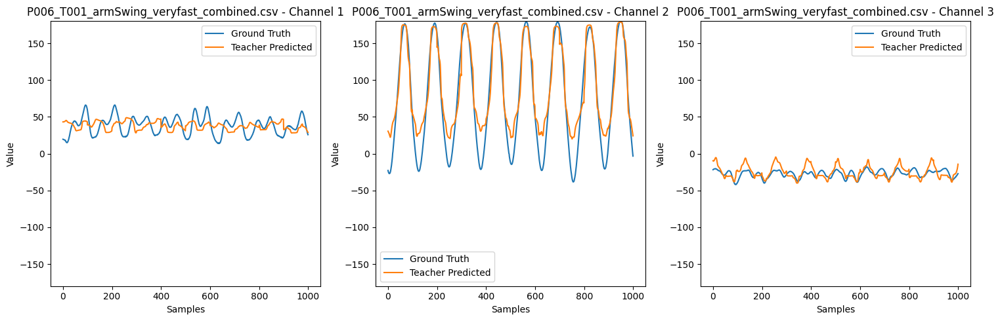

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_armSwing_fast_combined.csv


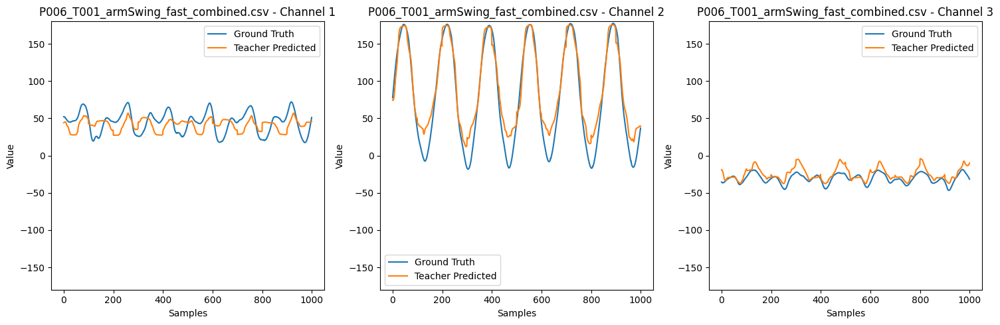

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_slow_combined.csv


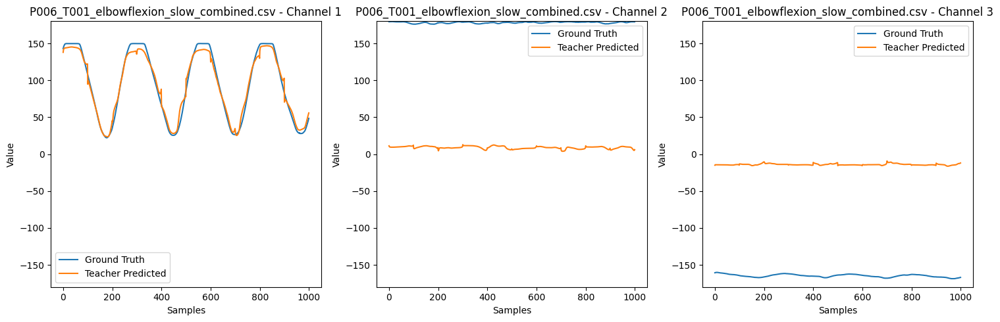

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_normal_combined.csv


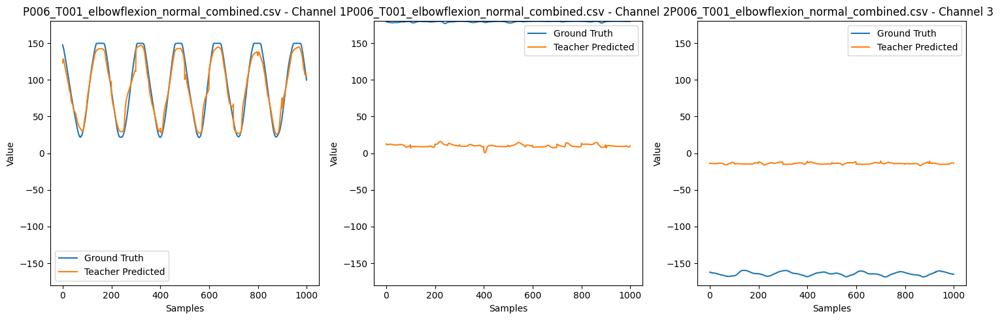

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T001_elbowflexion_fast_combined.csv


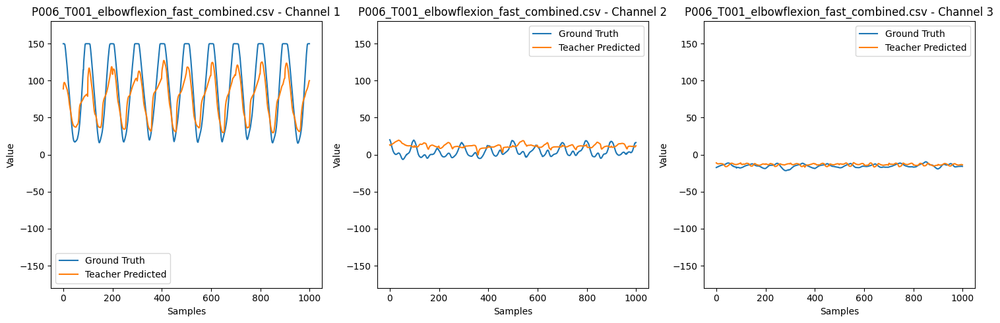

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_slow_combined.csv


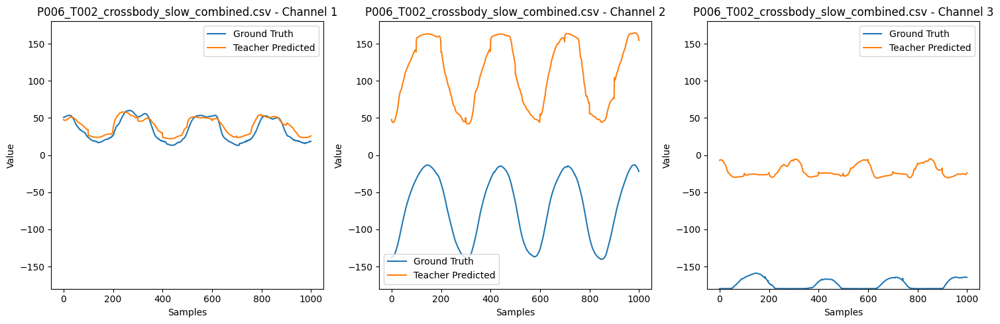

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_normal_combined.csv


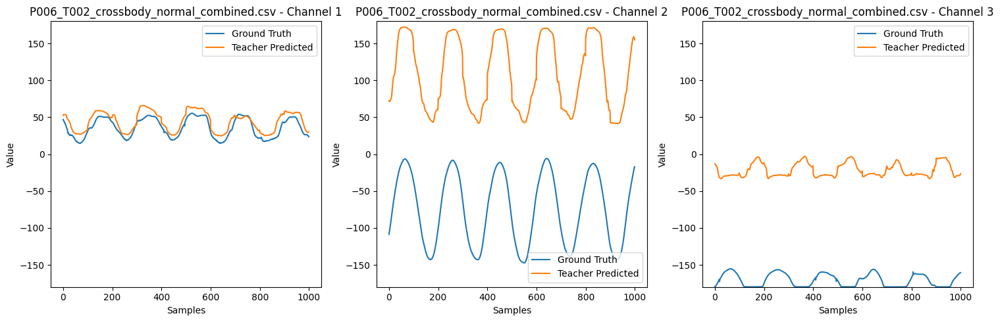

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_6/combined/P006_T002_crossbody_fast_combined.csv


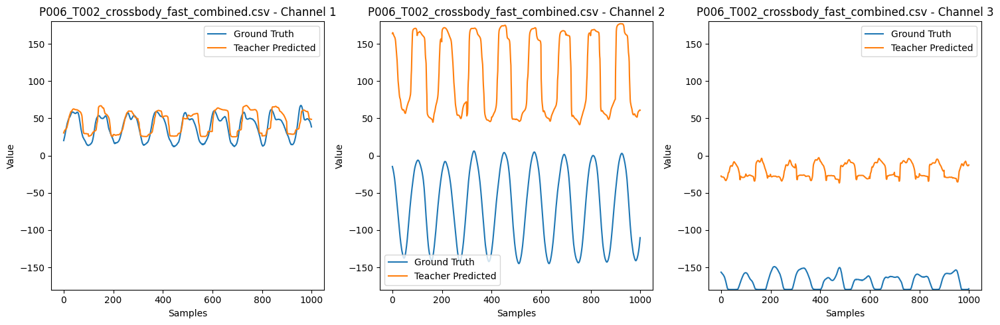

End of iteration
_________________________________________________________
Training subjects: ['subject_3']
Testing subject: subject_7
Dataset name: dataset_wl100_ol75_train['subject_3']_test['subject_7']
Training subjects: ['subject_3']
Testing subjects: ['subject_7']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_3:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_normal_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_fast_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T003_armswing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_veryfast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_slow_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_slow_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_fast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_7:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T002_armSwing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_normal_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_veryfast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_slow_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Epoch: 1, time: 1.4140, Training Loss: 2881.1295, Validation Loss: 1229.9089
Epoch: 2, time: 1.3737, Training Loss: 886.2948, Validation Loss: 465.4711
Epoch: 3, time: 1.3572, Training Loss: 305.3502, Validation Loss: 184.0607
Epoch: 4, time: 1.4048, Training Loss: 143.7595, Validation Loss: 94.0798
Epoch: 5, time: 1.3526, Training Loss: 95.8686, Validation Loss: 72.5260
Epoch: 6, time: 1.3484, Training Loss: 69.6480, Validation Loss: 46.9522
Epoch: 7, time: 1.3615, Training Loss: 62.7203, Validation Loss: 51.4863
Epoch: 8, time: 1.3600, Training Loss: 51.2139, Validation Loss: 39.7991
Epoch: 9, time: 1.3721, Training Loss: 43.2251, Validation Loss: 36.6188
Epoch: 10, time: 1.3638, Training Loss: 45.8541, Validation Loss: 28.4449
Training time: 14.55631709098816 seconds
________________________________
Training set metrics
RMSE per channel: [5.31239319 5.92088747 5.04615974]
5.312393
5.9208875
5.04616


0.990111886461165
0.9967531997197078
0.8812851722046814
Mean: 5.426 +/- 0.448
Mean:

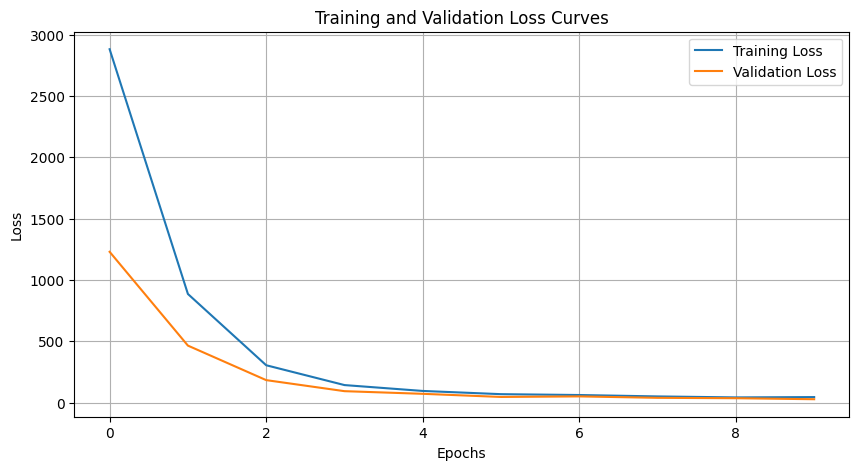

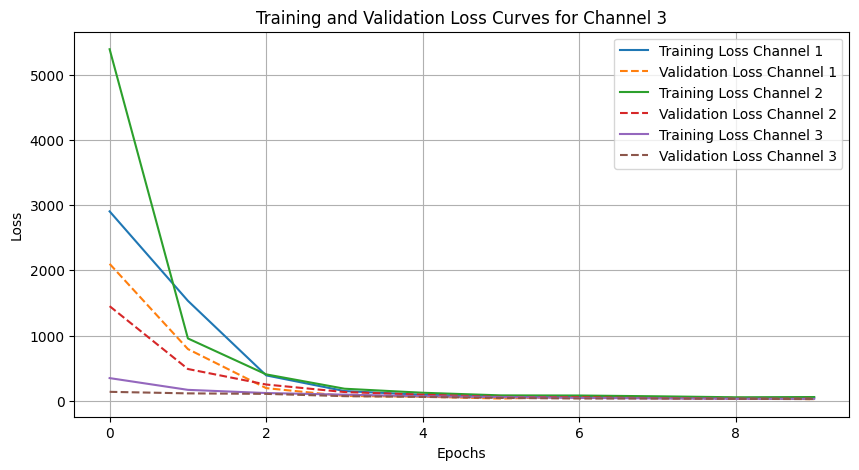

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T002_armSwing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T002_armSwing_slow_combined.csv


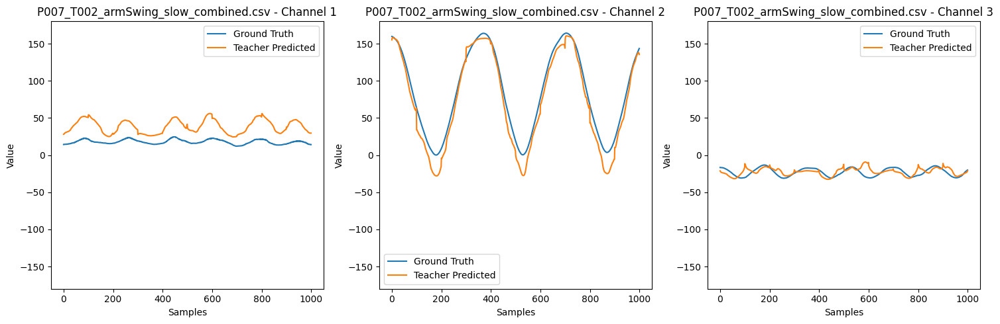

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_normal_combined.csv


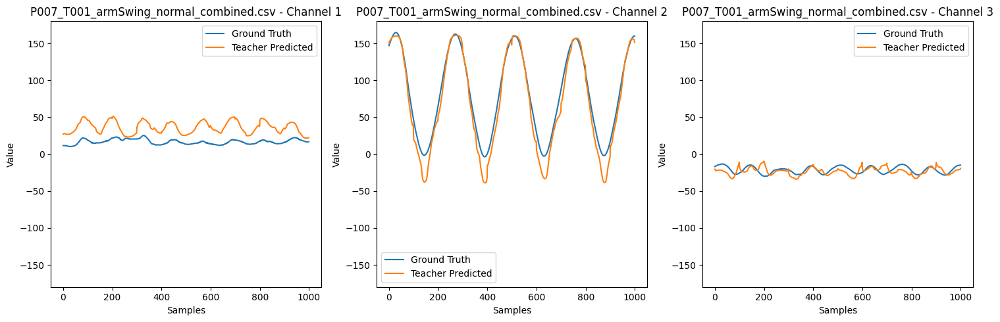

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_fast_combined.csv


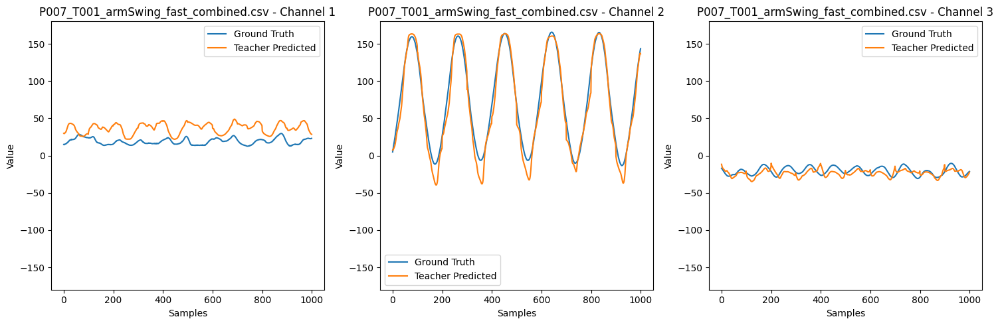

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_veryfast_combined.csv


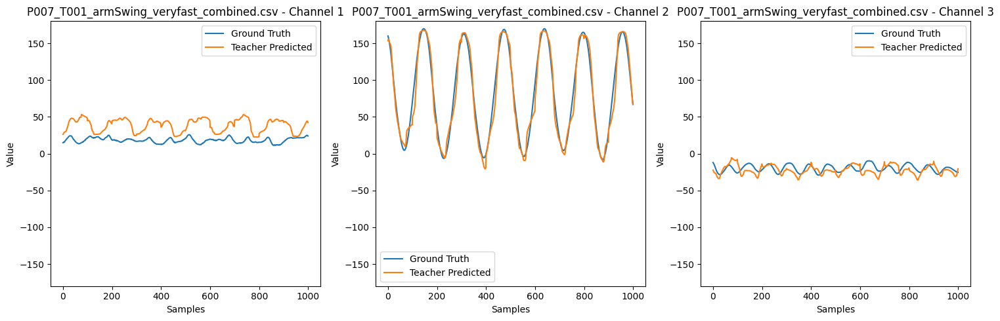

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_slow_combined.csv


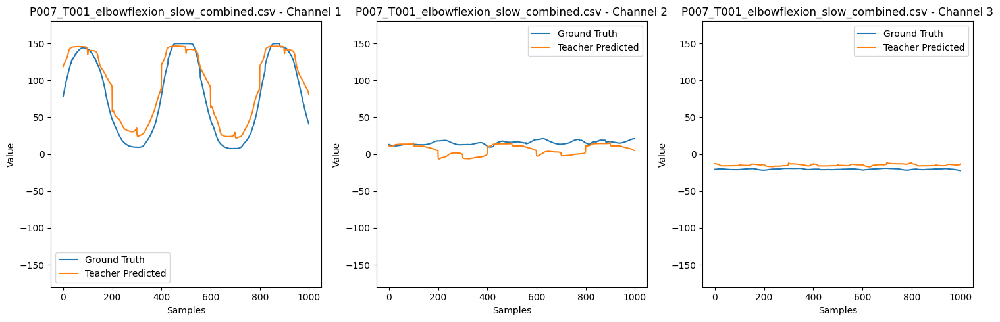

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_normal_combined.csv


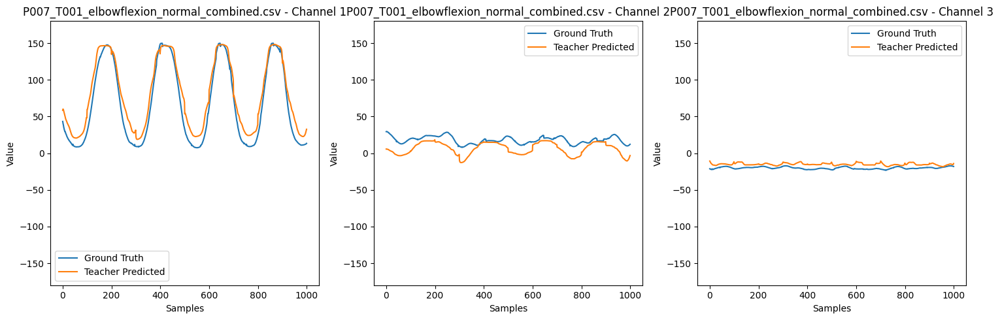

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_fast_combined.csv


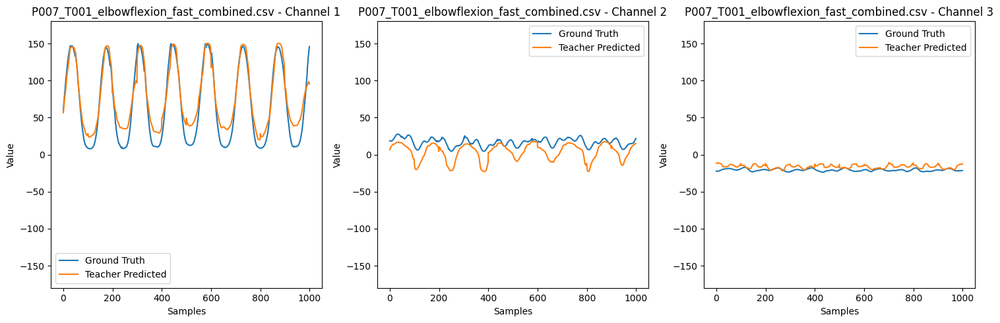

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_slow_combined.csv


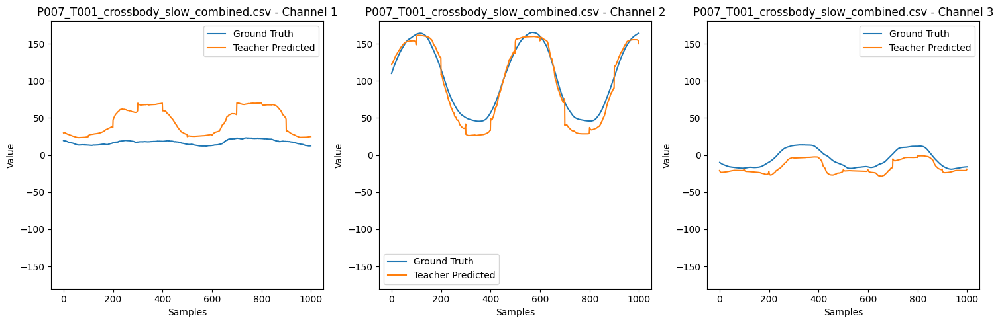

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_fast_combined.csv


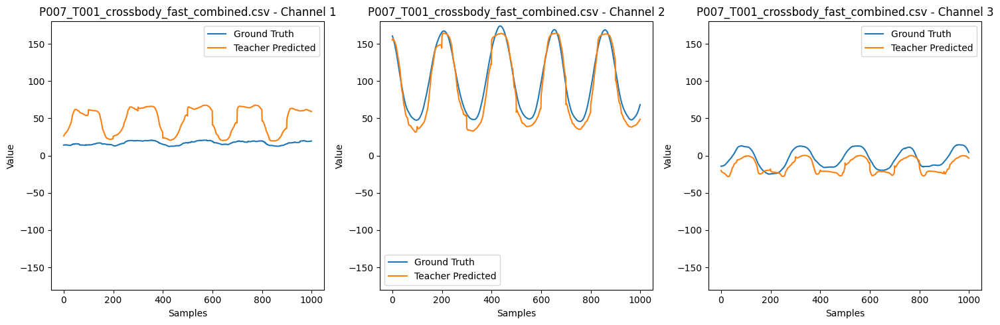

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_normal_combined.csv


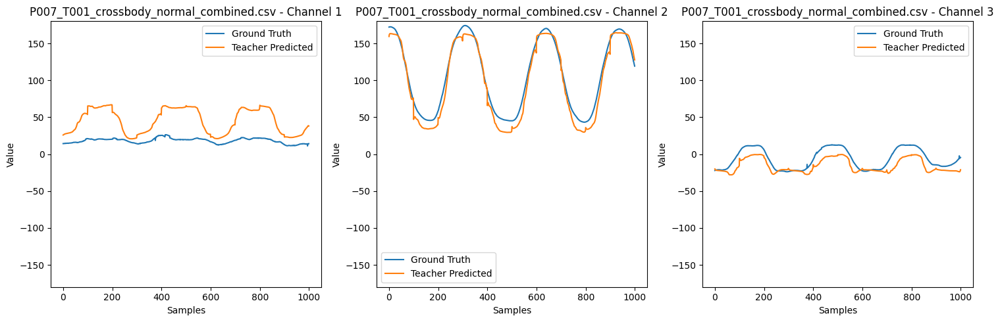

End of iteration
_________________________________________________________
Training subjects: ['subject_3']
Testing subject: subject_9
Dataset name: dataset_wl100_ol75_train['subject_3']_test['subject_9']
Training subjects: ['subject_3']
Testing subjects: ['subject_9']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_3:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_normal_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_fast_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T003_armswing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_veryfast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_slow_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_slow_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_fast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_9:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_normal_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_veryfast_combined:   0%|          | 0/123 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_elbowflexion_slow_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_elbowflexion_normal_combined:   0%|          | 0/127 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_crossbody_normal_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_crossbody_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Epoch: 1, time: 1.4501, Training Loss: 2889.1691, Validation Loss: 1301.8696
Epoch: 2, time: 1.3518, Training Loss: 949.6173, Validation Loss: 512.4933
Epoch: 3, time: 1.3467, Training Loss: 347.2952, Validation Loss: 181.1621
Epoch: 4, time: 1.3725, Training Loss: 146.7471, Validation Loss: 91.0372
Epoch: 5, time: 1.3987, Training Loss: 87.1720, Validation Loss: 69.4124
Epoch: 6, time: 1.3542, Training Loss: 63.2971, Validation Loss: 63.0080
Epoch: 7, time: 1.3617, Training Loss: 64.8280, Validation Loss: 62.3254
Epoch: 8, time: 1.4000, Training Loss: 56.1499, Validation Loss: 55.0876
Epoch: 9, time: 1.3646, Training Loss: 52.4608, Validation Loss: 40.6526
Epoch: 10, time: 1.3847, Training Loss: 39.4796, Validation Loss: 34.0119
Training time: 14.73855972290039 seconds
________________________________
Training set metrics
RMSE per channel: [5.20444822 7.02790117 4.80062628]
5.204448
7.027901
4.8006263


0.9905831917425514
0.9964603708744917
0.9009289708994496
Mean: 5.678 +/- 1.187
Mea

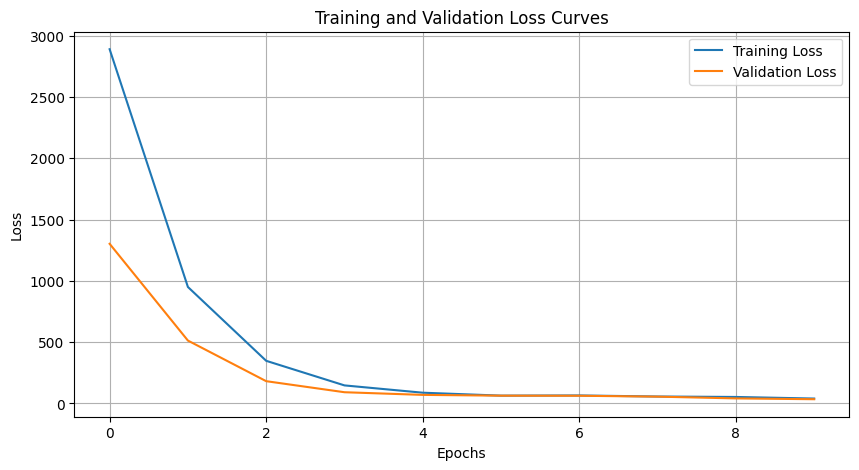

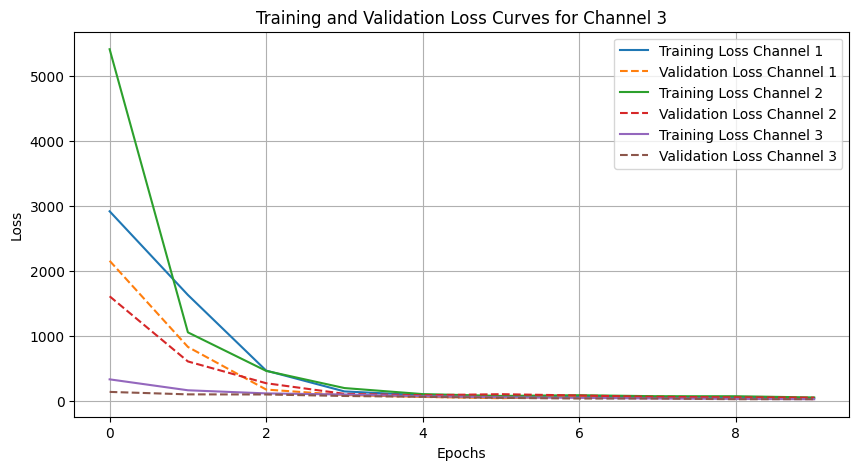

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_slow_combined.csv


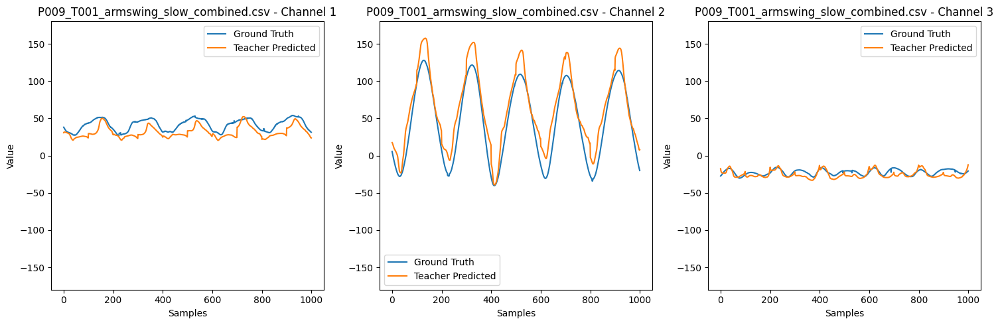

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_normal_combined.csv


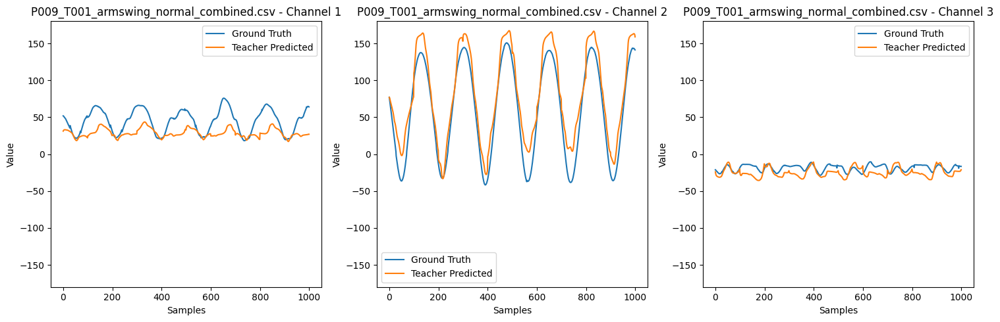

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_fast_combined.csv


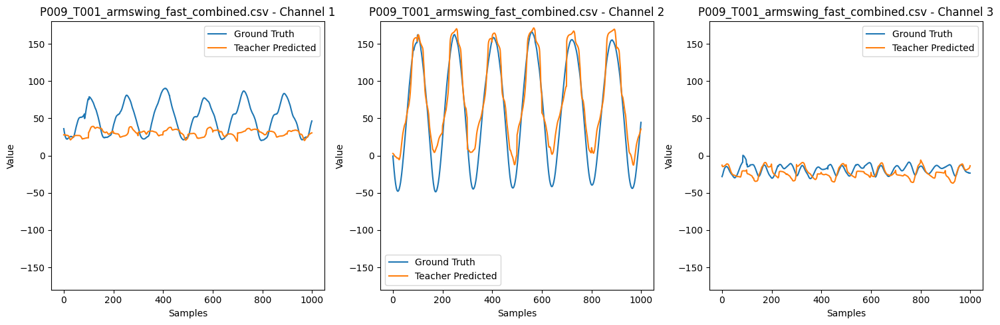

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_veryfast_combined.csv


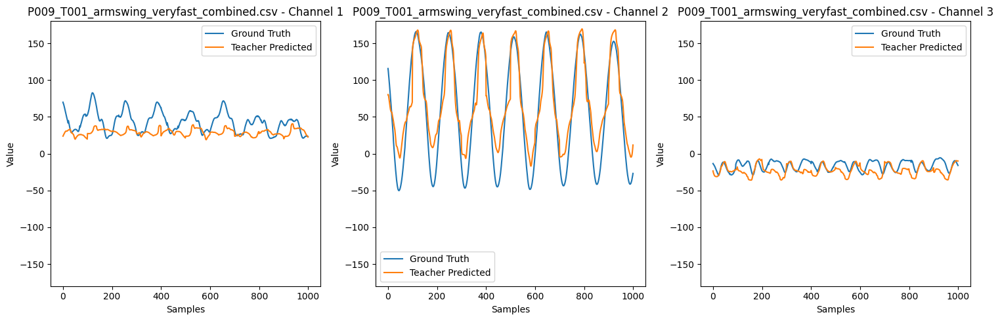

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_slow_combined.csv


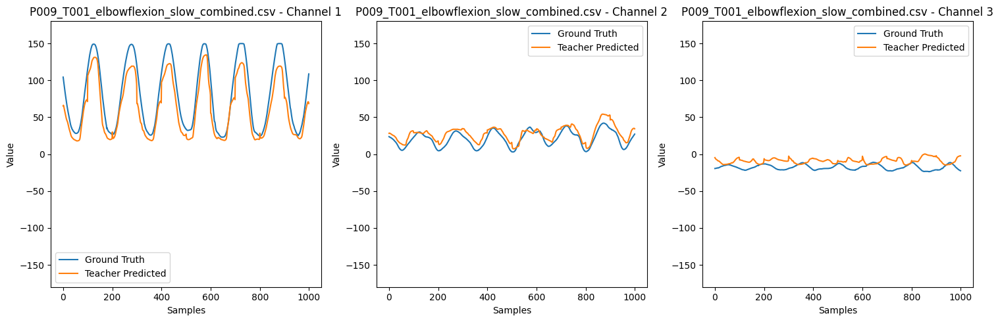

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_normal_combined.csv


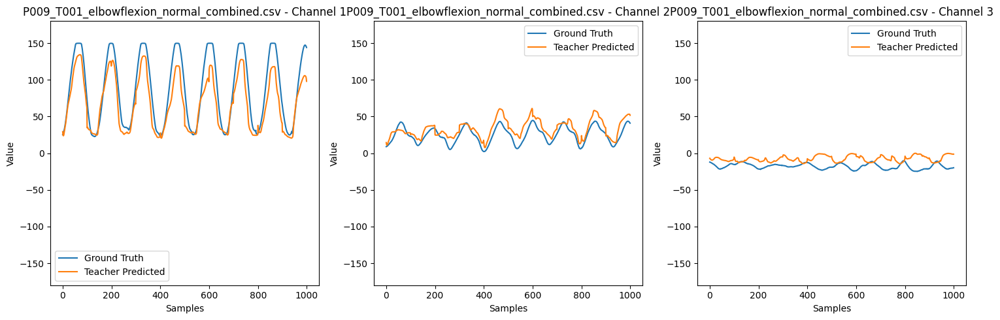

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_elbowflexion_fast_combined.csv


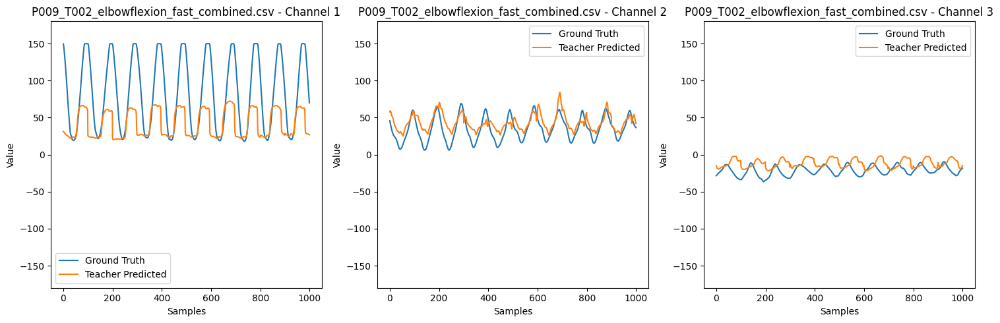

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_slow_combined.csv


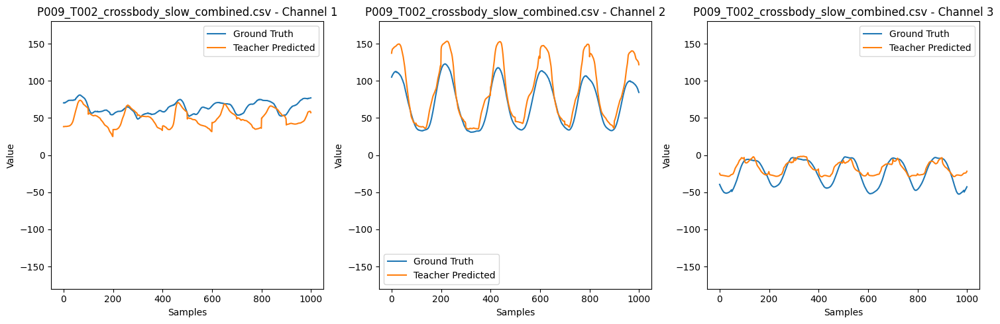

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_normal_combined.csv


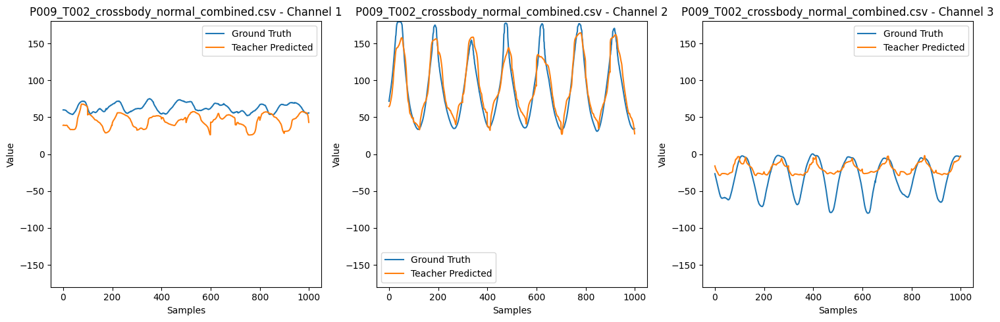

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_fast_combined.csv


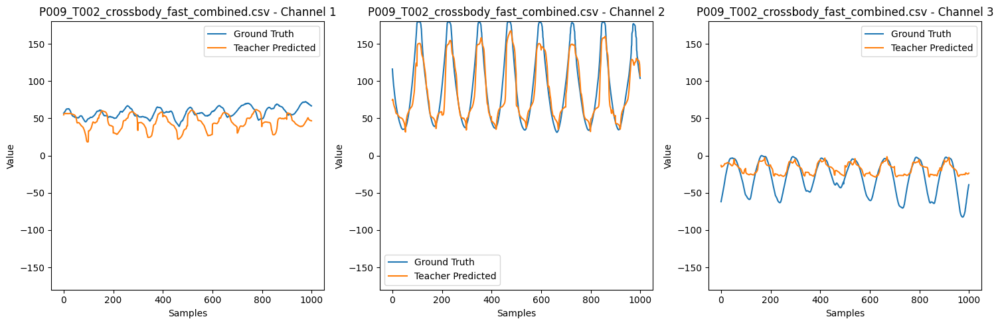

End of iteration
_________________________________________________________
Training subjects: ['subject_6']
Testing subject: subject_1
Dataset name: dataset_wl100_ol75_train['subject_6']_test['subject_1']
Training subjects: ['subject_6']
Testing subjects: ['subject_1']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_6:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_slow_combined:   0%|          | 0/112 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_veryfast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_slow_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_1:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_fast_combined:   0%|          | 0/130 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_slow_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_normal_combined:   0%|          | 0/127 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_normal_combined:   0%|          | 0/131 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_fast_combined:   0%|          | 0/126 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_slow_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_armSwing_veryfast_combined:   0%|          | 0/123 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_slow_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Epoch: 1, time: 1.4207, Training Loss: 8854.7220, Validation Loss: 5646.7712
Epoch: 2, time: 1.3073, Training Loss: 5111.5178, Validation Loss: 4539.8910
Epoch: 3, time: 1.3125, Training Loss: 3497.7365, Validation Loss: 2182.5248
Epoch: 4, time: 1.3139, Training Loss: 1279.4894, Validation Loss: 902.0034
Epoch: 5, time: 1.2981, Training Loss: 692.2042, Validation Loss: 632.2762
Epoch: 6, time: 1.3376, Training Loss: 505.8665, Validation Loss: 468.3368
Epoch: 7, time: 1.2844, Training Loss: 398.2357, Validation Loss: 327.4974
Epoch: 8, time: 1.2951, Training Loss: 293.9472, Validation Loss: 242.6912
Epoch: 9, time: 1.2970, Training Loss: 204.6239, Validation Loss: 166.2507
Epoch: 10, time: 1.3031, Training Loss: 153.5930, Validation Loss: 189.1814
Training time: 13.966050148010254 seconds
________________________________
Training set metrics
RMSE per channel: [11.8462019  14.63161182  7.8003273 ]
11.846201
14.631613
7.800327


0.9509273570294048
0.9906295533253123
0.9952791825149042
Me

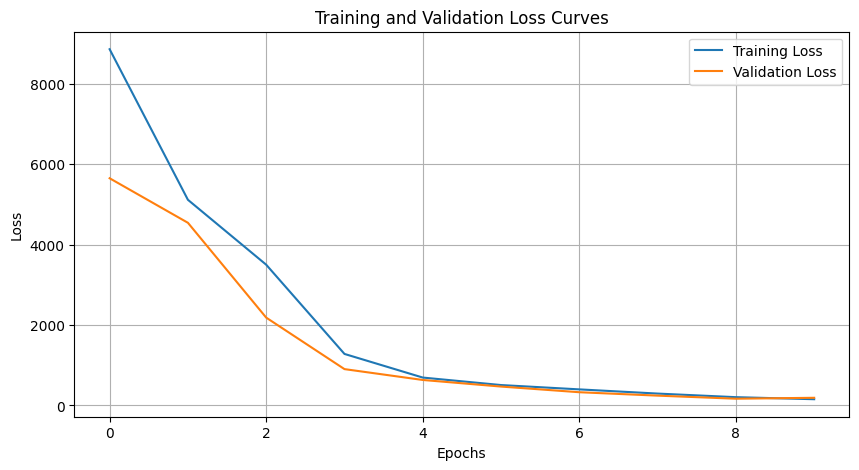

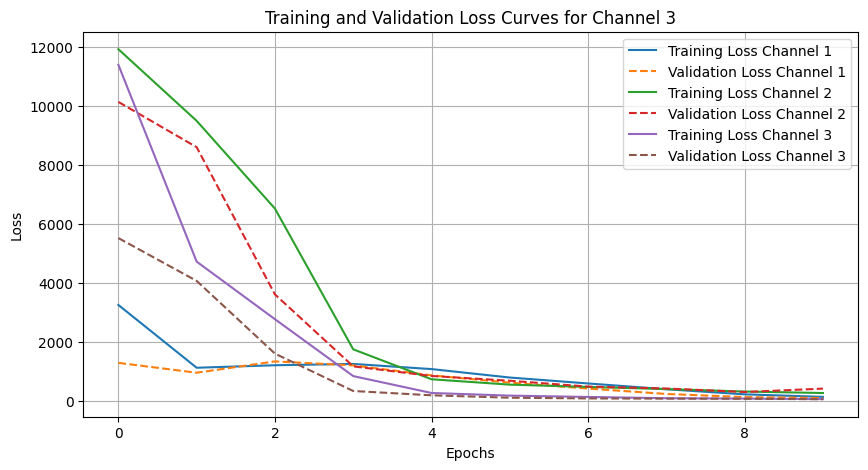

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_fast_combined.csv


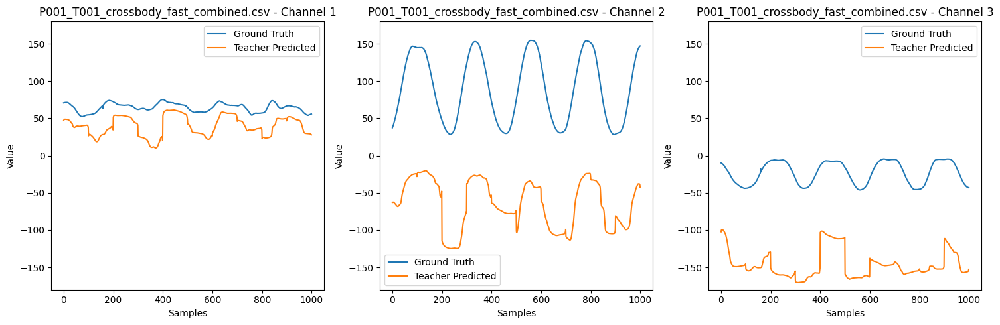

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_slow_combined.csv


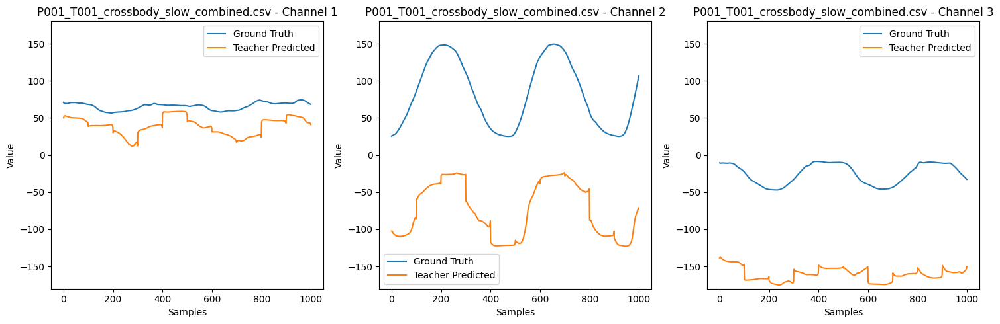

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_fast_combined.csv


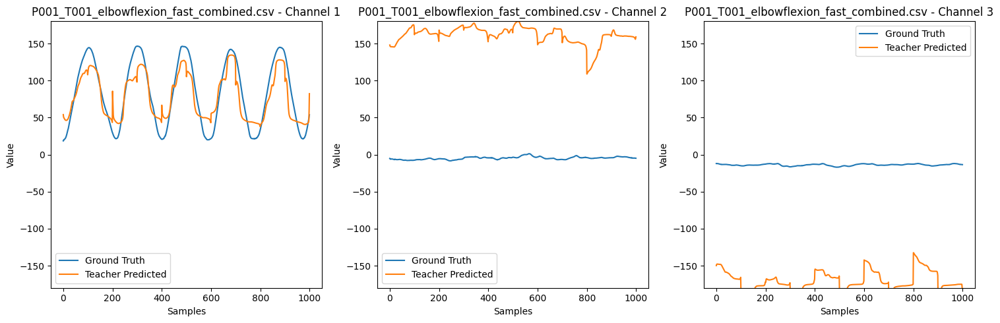

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_normal_combined.csv


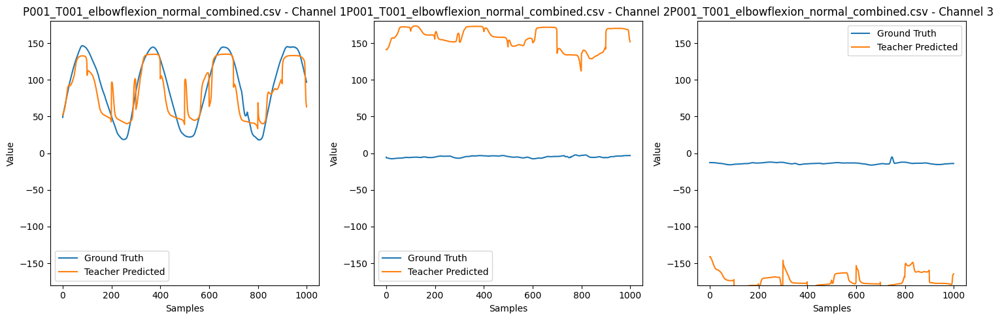

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_crossbody_normal_combined.csv


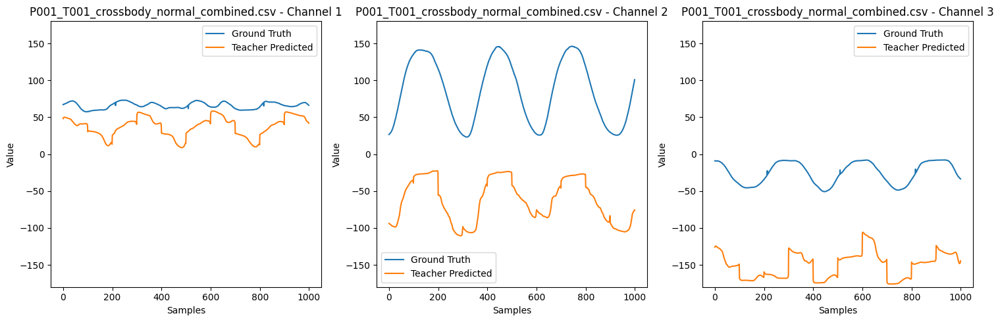

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_fast_combined.csv


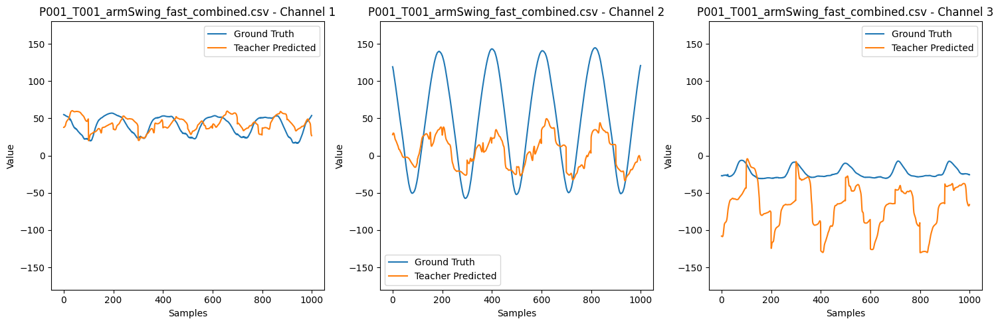

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_normal_combined.csv


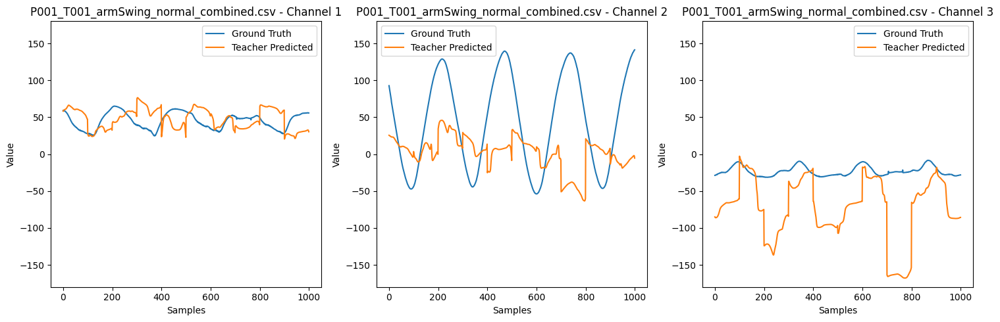

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_slow_combined.csv


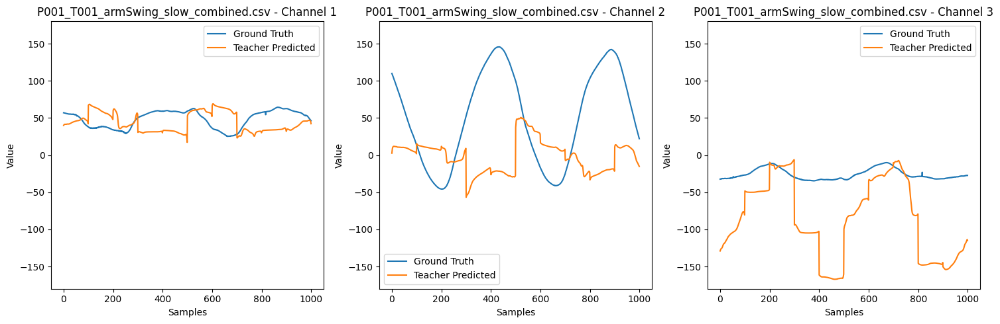

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_armSwing_veryfast_combined.csv


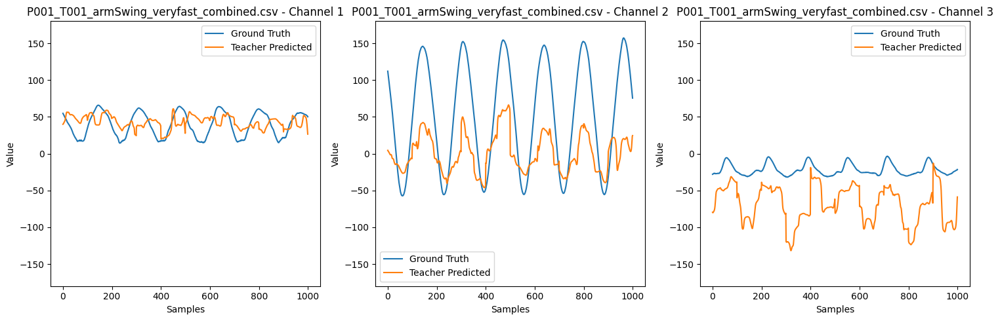

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_1/combined/P001_T001_elbowflexion_slow_combined.csv


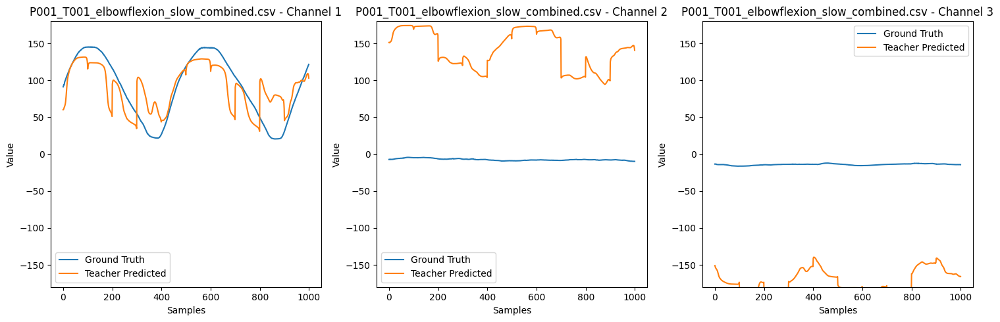

End of iteration
_________________________________________________________
Training subjects: ['subject_6']
Testing subject: subject_2
Dataset name: dataset_wl100_ol75_train['subject_6']_test['subject_2']
Training subjects: ['subject_6']
Testing subjects: ['subject_2']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_6:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_slow_combined:   0%|          | 0/112 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_veryfast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_slow_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_2:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_normal_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_armSwing_veryfast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_elboxflexion_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_2_P002_T001_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Epoch: 1, time: 1.3570, Training Loss: 8915.7884, Validation Loss: 5561.7845
Epoch: 2, time: 1.2901, Training Loss: 5146.5116, Validation Loss: 4287.1587
Epoch: 3, time: 1.3272, Training Loss: 2826.1944, Validation Loss: 1406.7807
Epoch: 4, time: 1.3131, Training Loss: 1170.3278, Validation Loss: 1050.0288
Epoch: 5, time: 1.3085, Training Loss: 818.7494, Validation Loss: 802.0191
Epoch: 6, time: 1.3354, Training Loss: 598.5646, Validation Loss: 500.5644
Epoch: 7, time: 1.3266, Training Loss: 457.6027, Validation Loss: 354.0047
Epoch: 8, time: 1.2938, Training Loss: 266.1577, Validation Loss: 214.1698
Epoch: 9, time: 1.3100, Training Loss: 238.1629, Validation Loss: 181.0108
Epoch: 10, time: 1.5374, Training Loss: 146.6827, Validation Loss: 156.6598
Training time: 14.31497073173523 seconds
________________________________
Training set metrics
RMSE per channel: [ 9.52440262 14.16252327  5.70538092]
9.524402
14.162525
5.705381


0.9677817870611812
0.9913362251091591
0.9967632797105863
Mea

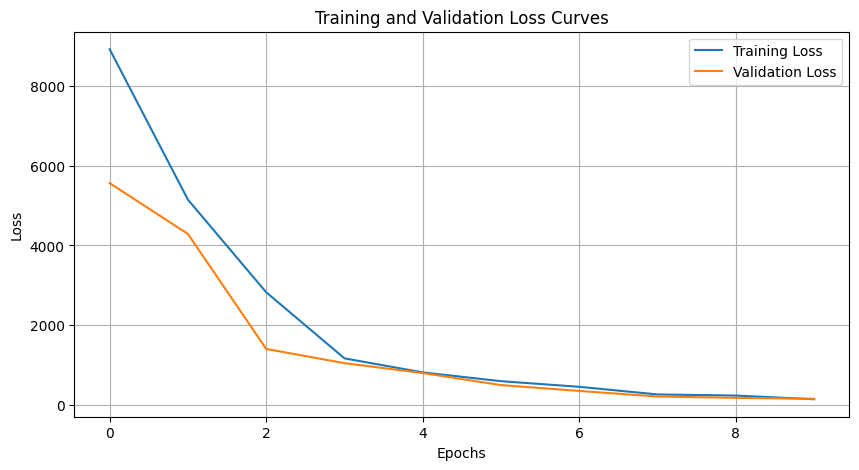

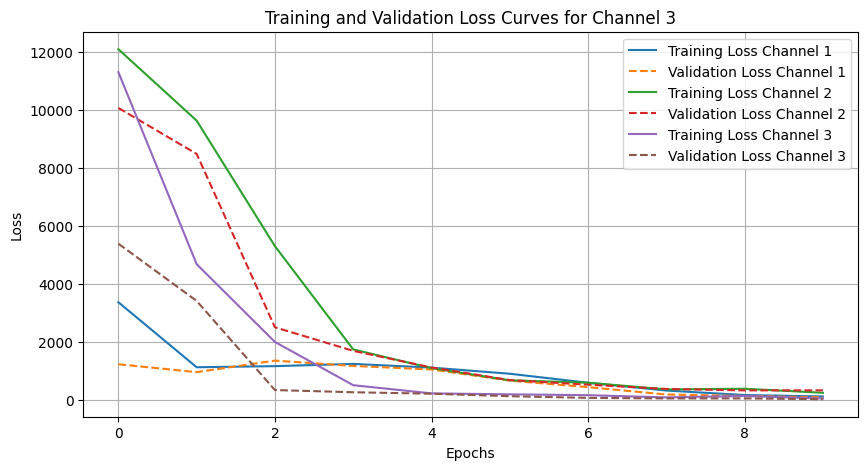

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_slow_combined.csv


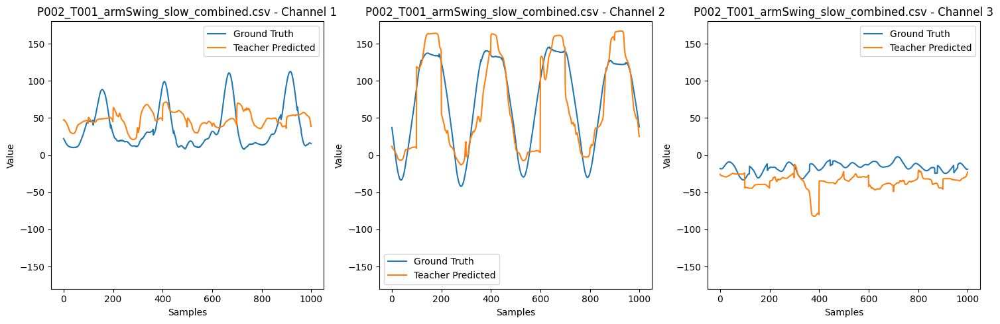

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_normal_combined.csv


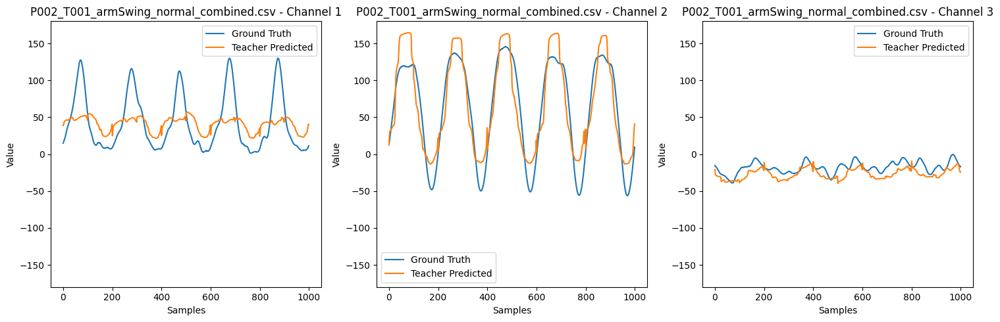

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_fast_combined.csv


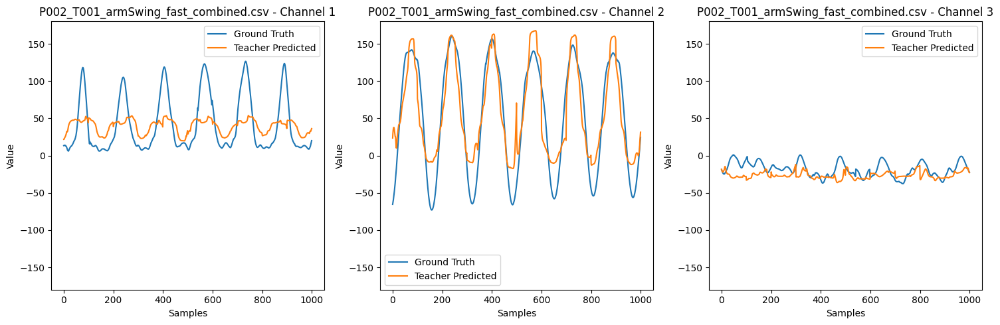

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_armSwing_veryfast_combined.csv


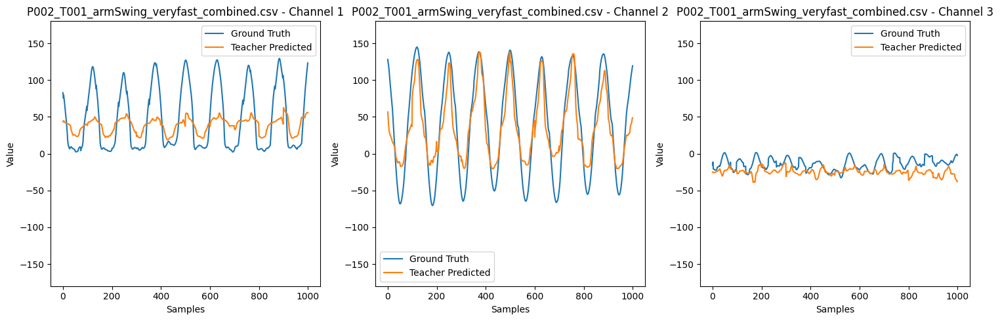

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_slow_combined.csv


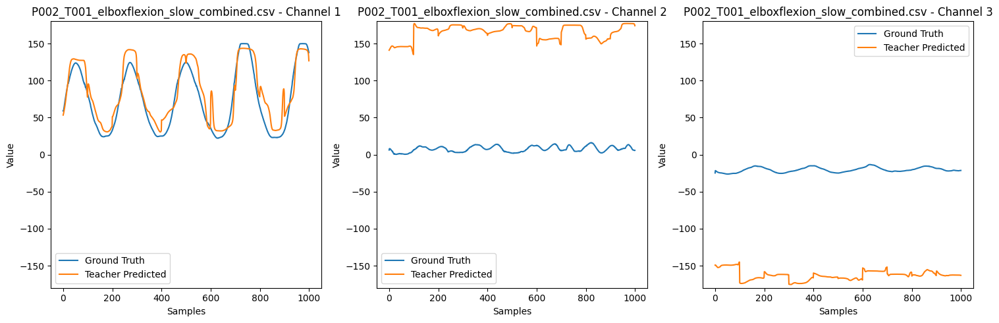

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_normal_combined.csv


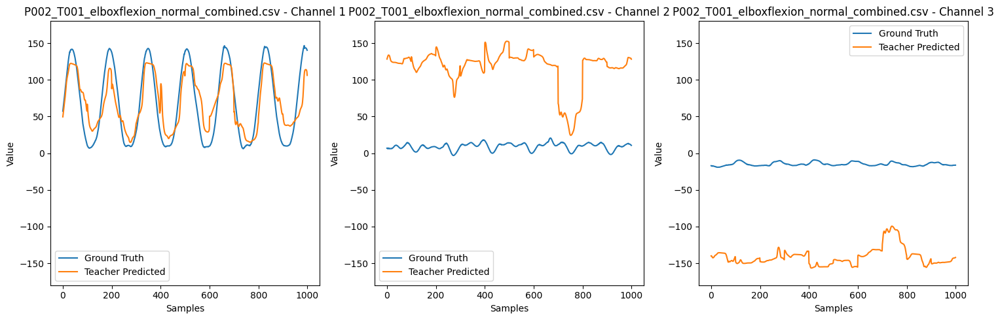

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_elboxflexion_fast_combined.csv


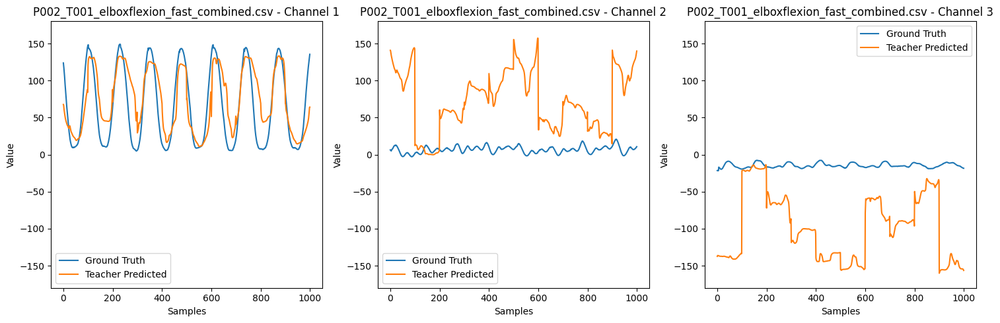

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_slow_combined.csv


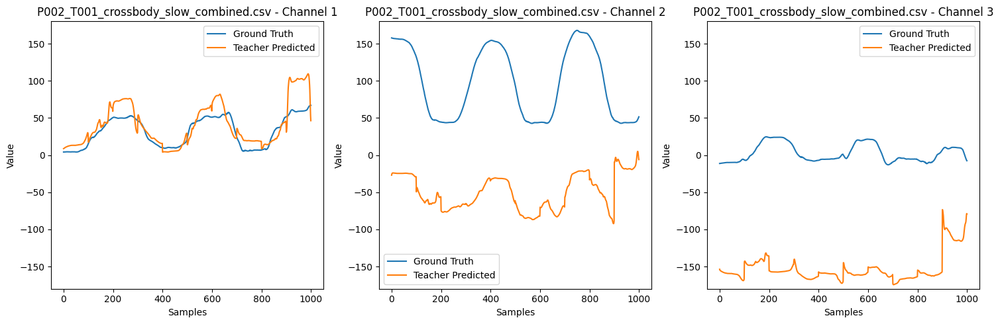

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_normal_combined.csv


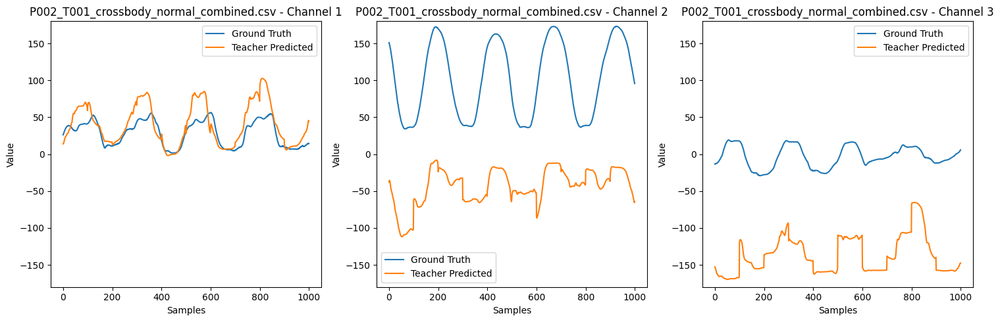

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_2/combined/P002_T001_crossbody_fast_combined.csv


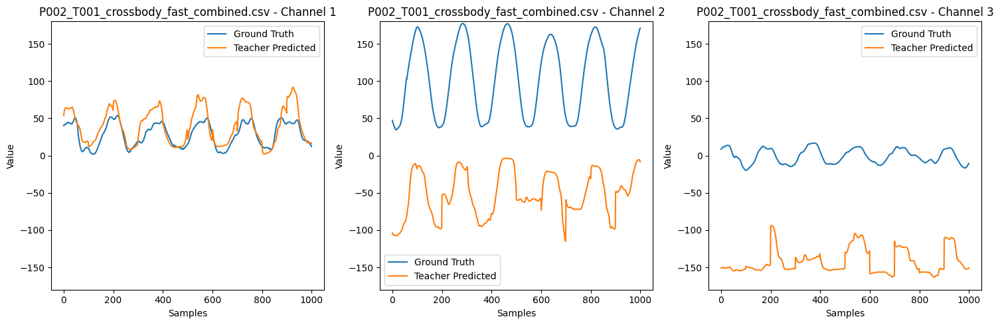

End of iteration
_________________________________________________________
Training subjects: ['subject_6']
Testing subject: subject_3
Dataset name: dataset_wl100_ol75_train['subject_6']_test['subject_3']
Training subjects: ['subject_6']
Testing subjects: ['subject_3']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_6:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_slow_combined:   0%|          | 0/112 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_veryfast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_slow_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_3:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_normal_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_fast_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T003_armswing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_armswing_veryfast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_slow_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_slow_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_normal_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_3_P003_T001_crossbody_fast_combined:   0%|          | 0/128 [00:00<?, ?it/s]

Epoch: 1, time: 1.3906, Training Loss: 8794.9448, Validation Loss: 5863.7174
Epoch: 2, time: 1.2670, Training Loss: 5584.1879, Validation Loss: 5035.0968
Epoch: 3, time: 1.2841, Training Loss: 4430.4003, Validation Loss: 3805.4383
Epoch: 4, time: 1.2846, Training Loss: 2667.5236, Validation Loss: 1309.6742
Epoch: 5, time: 1.2975, Training Loss: 1031.4069, Validation Loss: 912.4359
Epoch: 6, time: 1.3513, Training Loss: 728.1656, Validation Loss: 645.2989
Epoch: 7, time: 1.3176, Training Loss: 549.9691, Validation Loss: 524.1488
Epoch: 8, time: 1.3428, Training Loss: 382.5592, Validation Loss: 336.0985
Epoch: 9, time: 1.3121, Training Loss: 301.7064, Validation Loss: 250.1925
Epoch: 10, time: 1.3323, Training Loss: 211.5767, Validation Loss: 180.6432
Training time: 14.074555397033691 seconds
________________________________
Training set metrics
RMSE per channel: [11.98117447 16.87749481  7.79772282]
11.9811735
16.877495
7.7977223


0.9480560959149228
0.9886397758092987
0.994435200194892

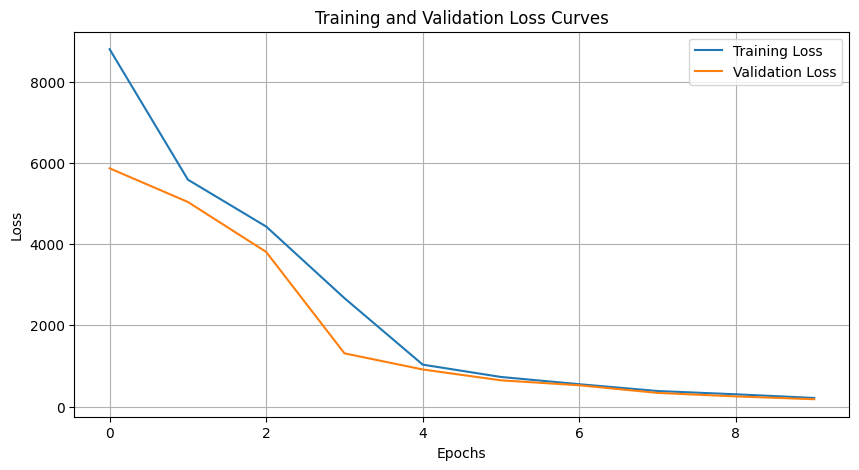

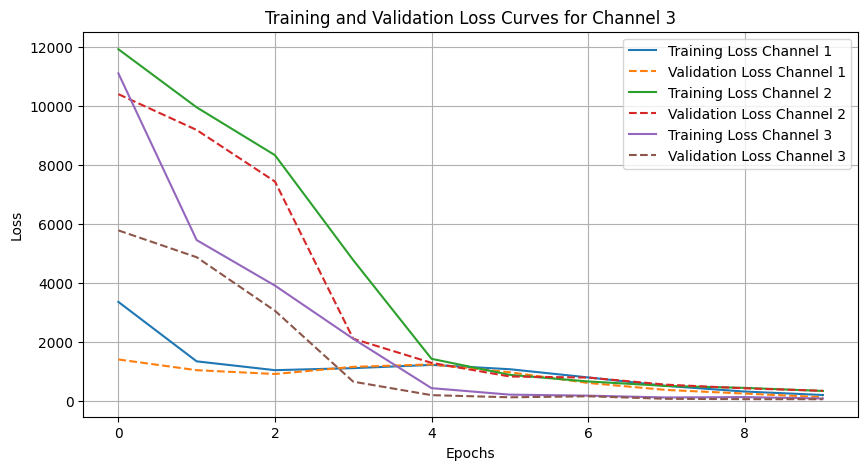

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_normal_combined.csv


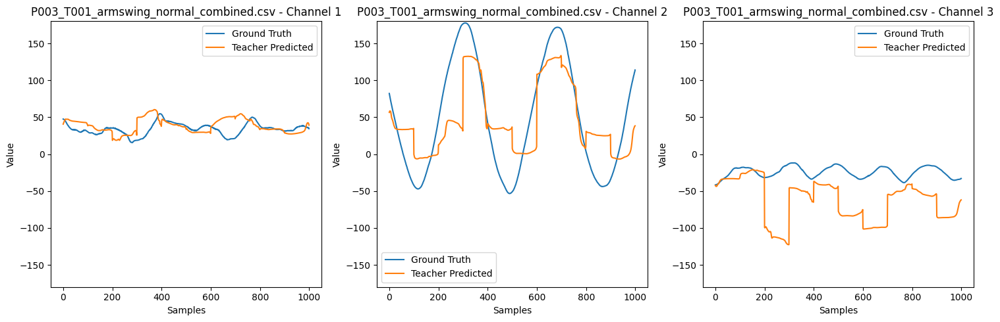

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_fast_combined.csv


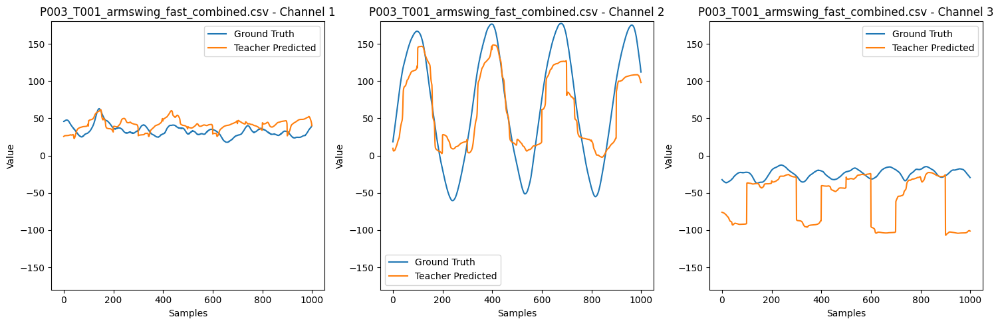

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T003_armswing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T003_armswing_slow_combined.csv


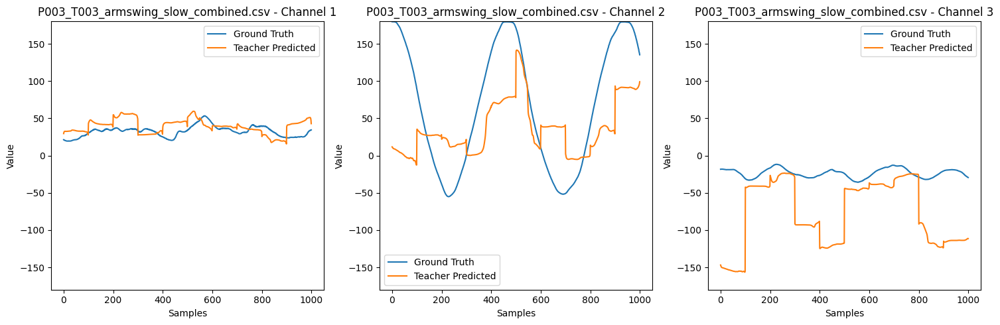

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_armswing_veryfast_combined.csv


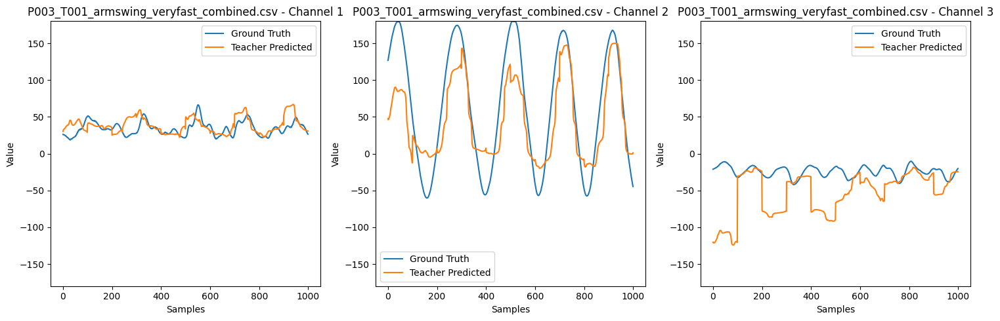

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_slow_combined.csv


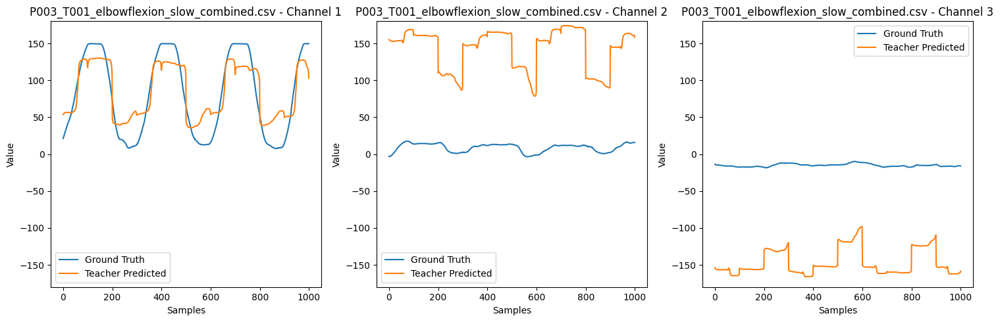

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_normal_combined.csv


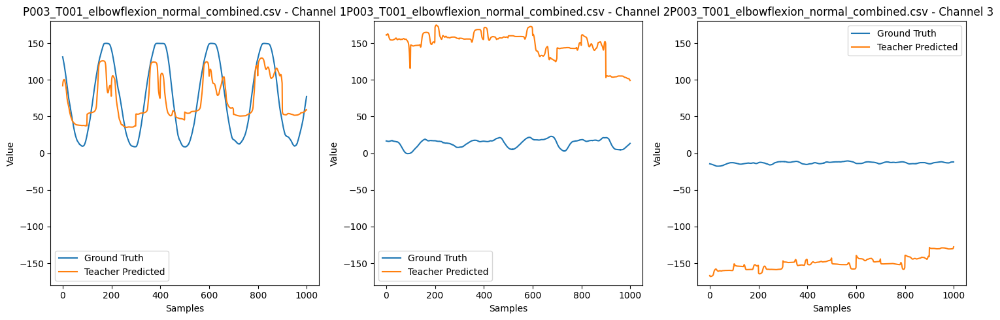

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_elbowflexion_fast_combined.csv


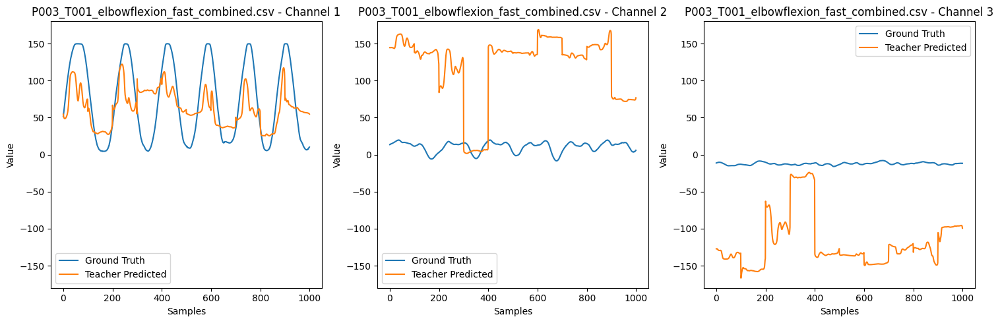

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_slow_combined.csv


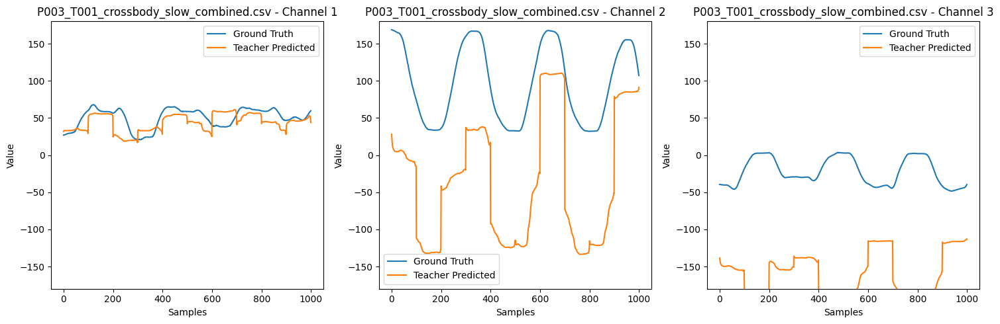

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_normal_combined.csv


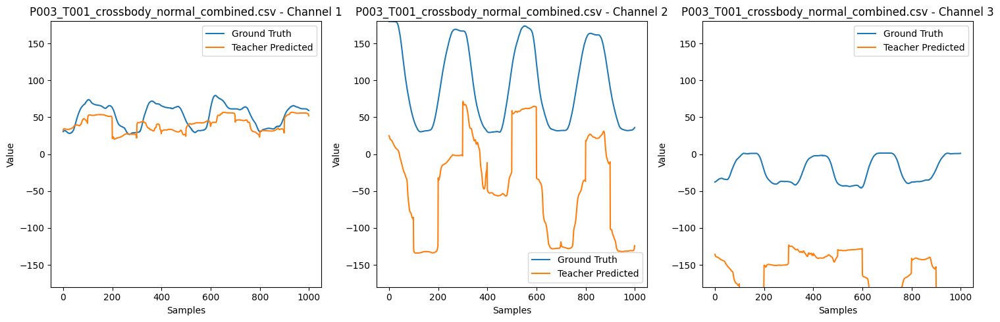

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_3/combined/P003_T001_crossbody_fast_combined.csv


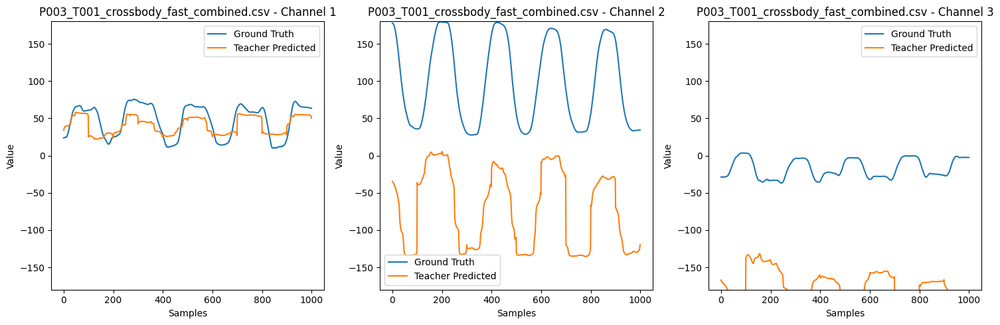

End of iteration
_________________________________________________________
Training subjects: ['subject_6']
Testing subject: subject_7
Dataset name: dataset_wl100_ol75_train['subject_6']_test['subject_7']
Training subjects: ['subject_6']
Testing subjects: ['subject_7']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_6:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_slow_combined:   0%|          | 0/112 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_veryfast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_slow_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_7:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T002_armSwing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_normal_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_veryfast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_slow_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Epoch: 1, time: 1.3440, Training Loss: 8881.7282, Validation Loss: 5687.2657
Epoch: 2, time: 1.2627, Training Loss: 5289.4346, Validation Loss: 4622.8711
Epoch: 3, time: 1.2688, Training Loss: 3812.6012, Validation Loss: 2724.0382
Epoch: 4, time: 1.3119, Training Loss: 1443.3157, Validation Loss: 1016.4379
Epoch: 5, time: 1.3748, Training Loss: 843.1689, Validation Loss: 712.2098
Epoch: 6, time: 1.5393, Training Loss: 571.4028, Validation Loss: 539.0834
Epoch: 7, time: 1.5077, Training Loss: 411.1539, Validation Loss: 389.7919
Epoch: 8, time: 1.3299, Training Loss: 298.0563, Validation Loss: 267.8900
Epoch: 9, time: 1.3028, Training Loss: 239.6210, Validation Loss: 235.8458
Epoch: 10, time: 1.3051, Training Loss: 201.4582, Validation Loss: 223.7299
Training time: 14.896000623703003 seconds
________________________________
Training set metrics
RMSE per channel: [13.45147419 16.9326458   6.7782445 ]
13.451474
16.932646
6.778245


0.9528086437443475
0.9870059086277616
0.9961683035104093
M

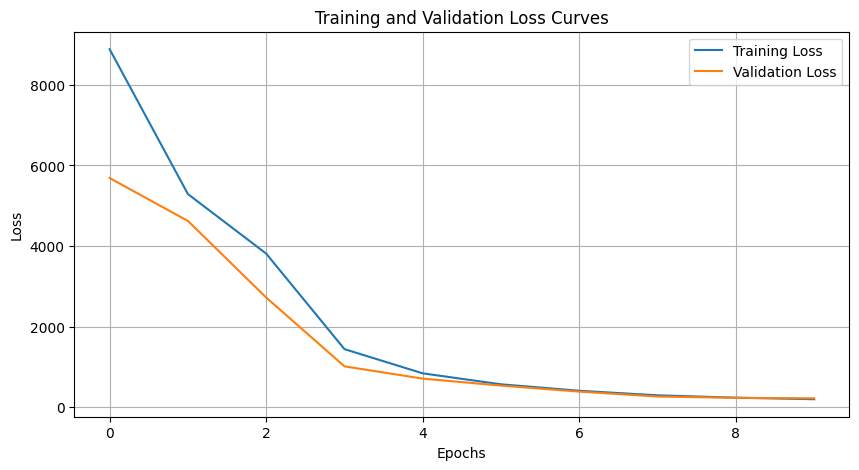

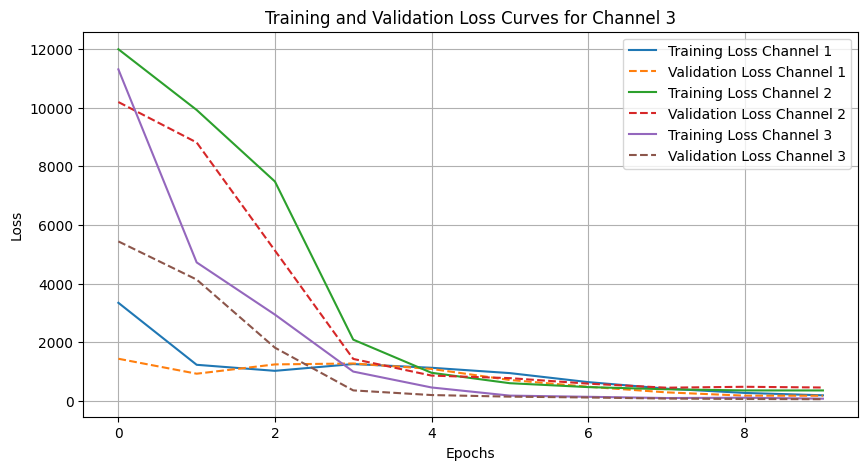

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T002_armSwing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T002_armSwing_slow_combined.csv


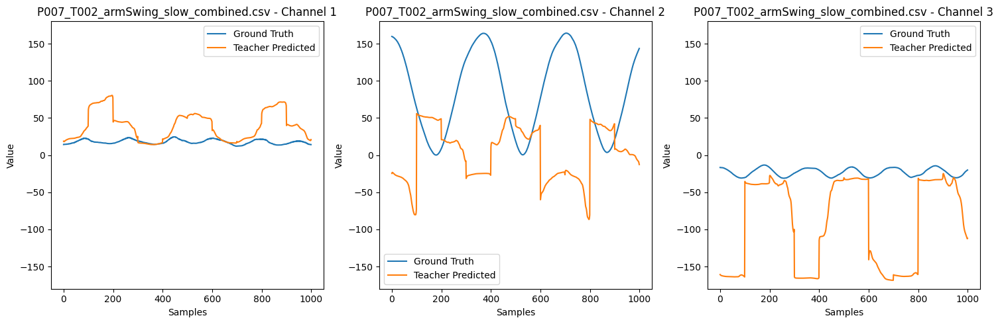

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_normal_combined.csv


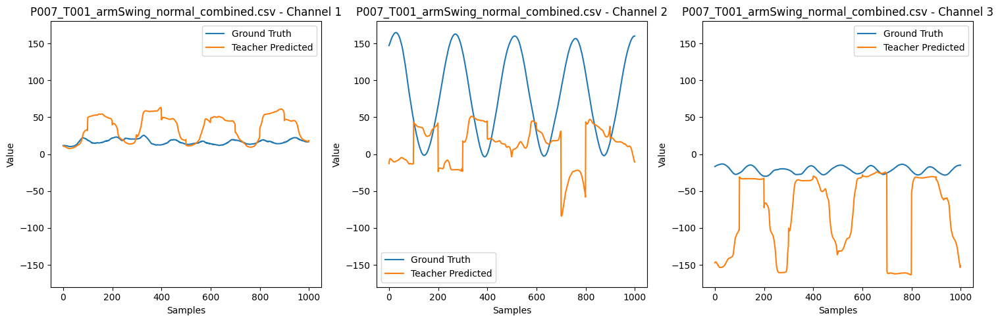

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_fast_combined.csv


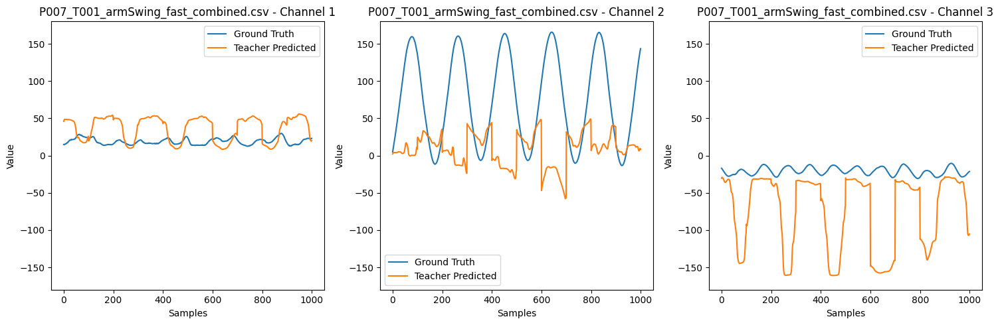

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_armSwing_veryfast_combined.csv


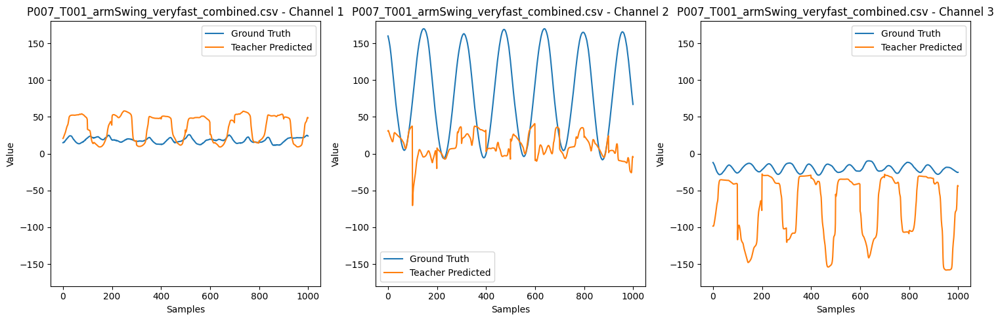

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_slow_combined.csv


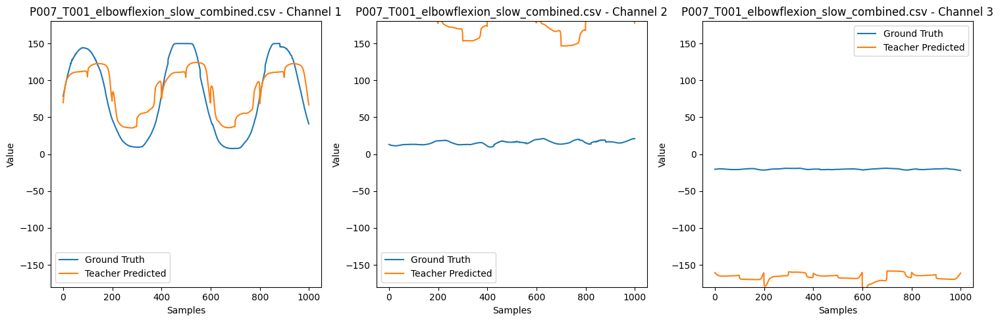

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_normal_combined.csv


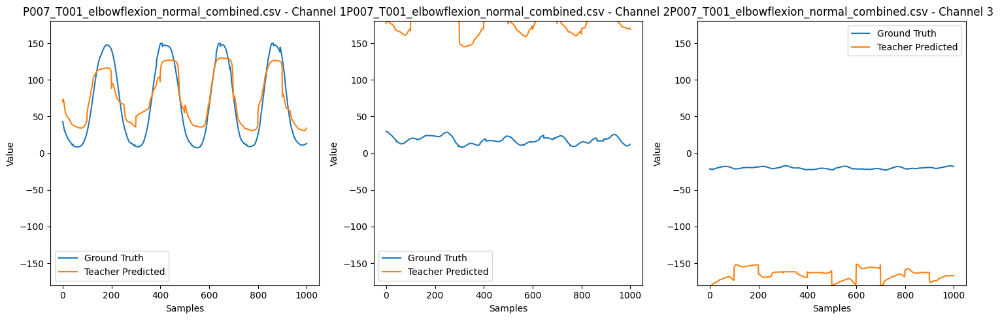

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_elbowflexion_fast_combined.csv


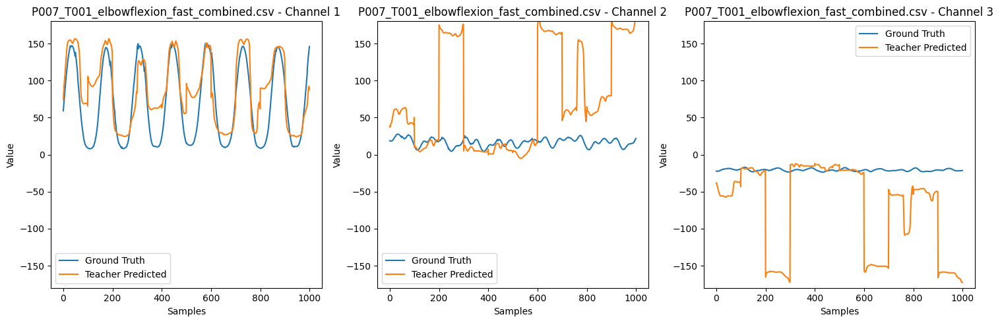

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_slow_combined.csv


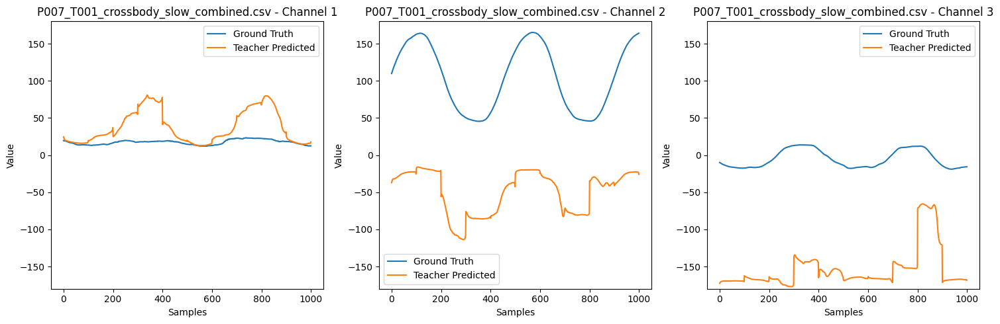

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_fast_combined.csv


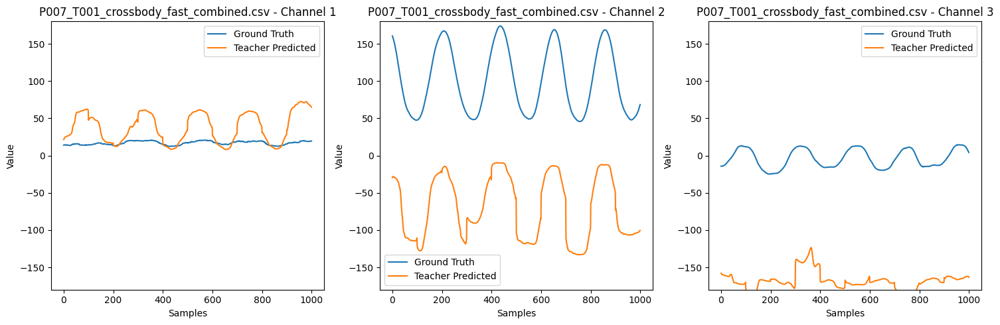

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_7/combined/P007_T001_crossbody_normal_combined.csv


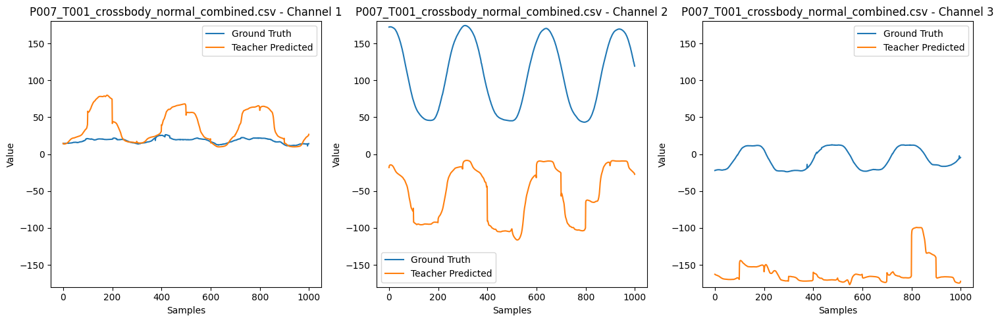

End of iteration
_________________________________________________________
Training subjects: ['subject_6']
Testing subject: subject_9
Dataset name: dataset_wl100_ol75_train['subject_6']_test['subject_9']
Training subjects: ['subject_6']
Testing subjects: ['subject_9']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_6:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_slow_combined:   0%|          | 0/112 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_veryfast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_armSwing_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_slow_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T001_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_6_P006_T002_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_9:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_normal_combined:   0%|          | 0/122 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_armswing_veryfast_combined:   0%|          | 0/123 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_elbowflexion_slow_combined:   0%|          | 0/125 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T001_elbowflexion_normal_combined:   0%|          | 0/127 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_crossbody_normal_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_9_P009_T002_crossbody_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Epoch: 1, time: 1.3765, Training Loss: 8844.3619, Validation Loss: 5542.1910
Epoch: 2, time: 1.2568, Training Loss: 4965.2076, Validation Loss: 4311.9874
Epoch: 3, time: 1.2787, Training Loss: 3833.3473, Validation Loss: 3175.8805
Epoch: 4, time: 1.2881, Training Loss: 1763.9883, Validation Loss: 961.9062
Epoch: 5, time: 1.2872, Training Loss: 753.6969, Validation Loss: 711.6570
Epoch: 6, time: 1.3140, Training Loss: 583.5170, Validation Loss: 534.8398
Epoch: 7, time: 1.3255, Training Loss: 463.3373, Validation Loss: 419.6906
Epoch: 8, time: 1.3050, Training Loss: 321.8341, Validation Loss: 280.9503
Epoch: 9, time: 1.3285, Training Loss: 236.2429, Validation Loss: 228.7226
Epoch: 10, time: 1.3010, Training Loss: 194.9193, Validation Loss: 171.9178
Training time: 13.968279361724854 seconds
________________________________
Training set metrics
RMSE per channel: [10.1222477  15.05987453  7.1138382 ]
10.122248
15.059875
7.1138377


0.9627719605414994
0.9901803804276549
0.996314745958069
Me

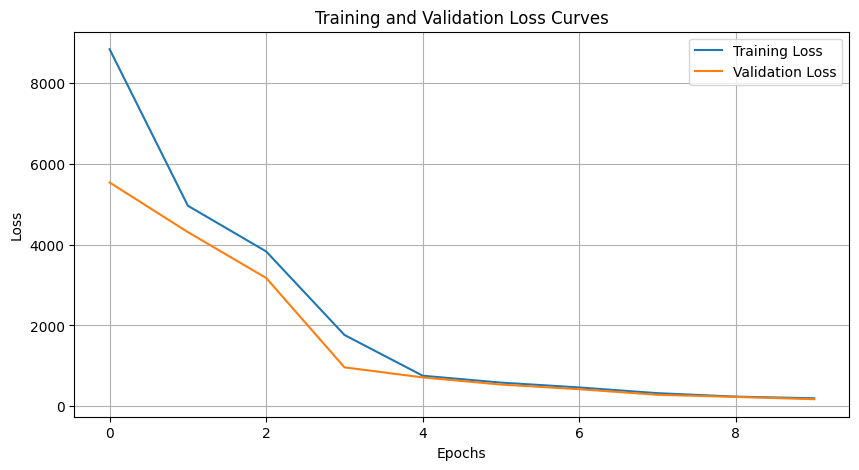

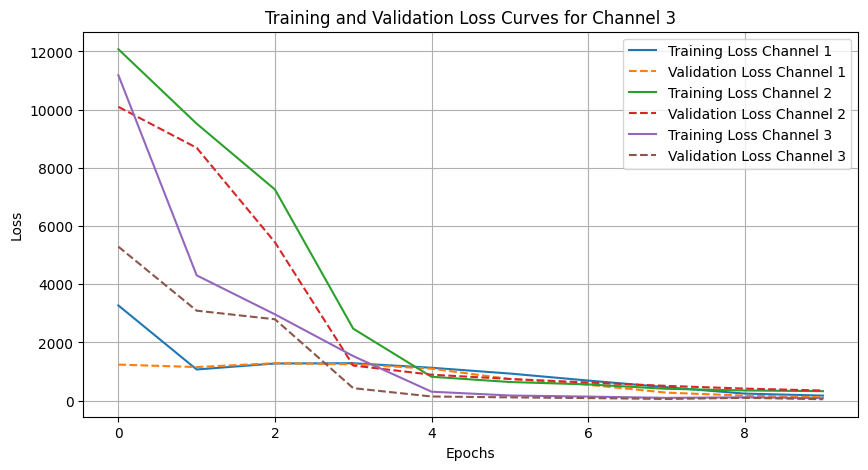

Found 10 files for processing.
Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_slow_combined.csv


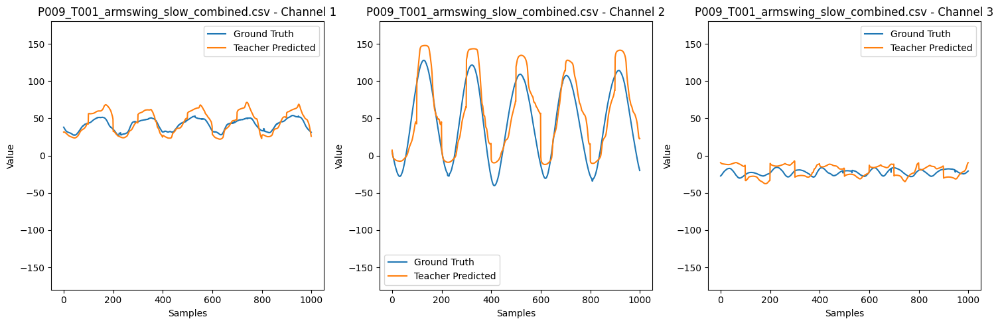

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_normal_combined.csv


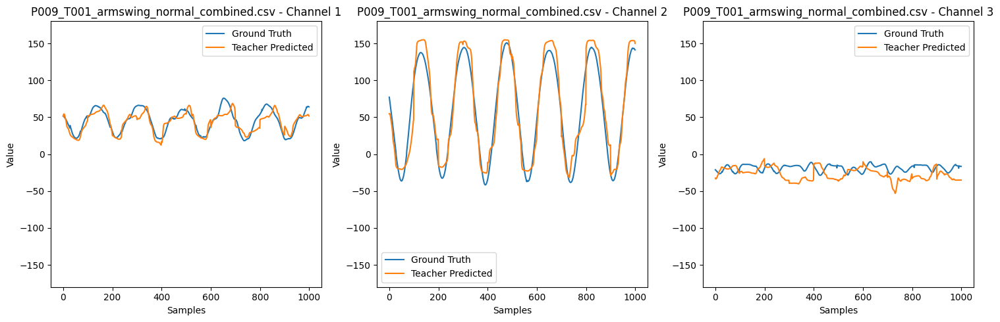

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_fast_combined.csv


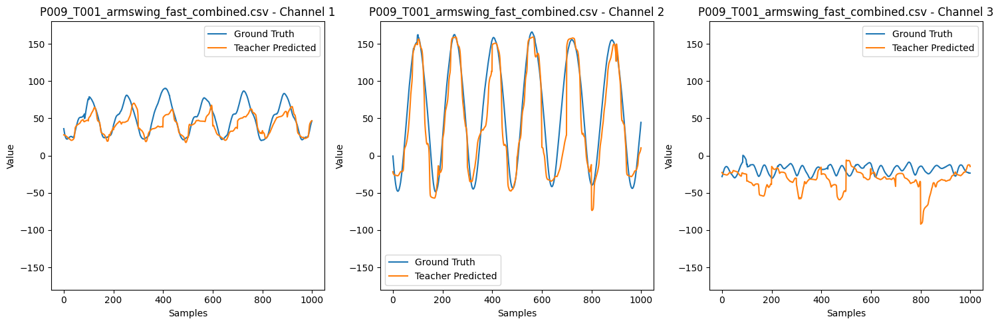

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_veryfast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_armswing_veryfast_combined.csv


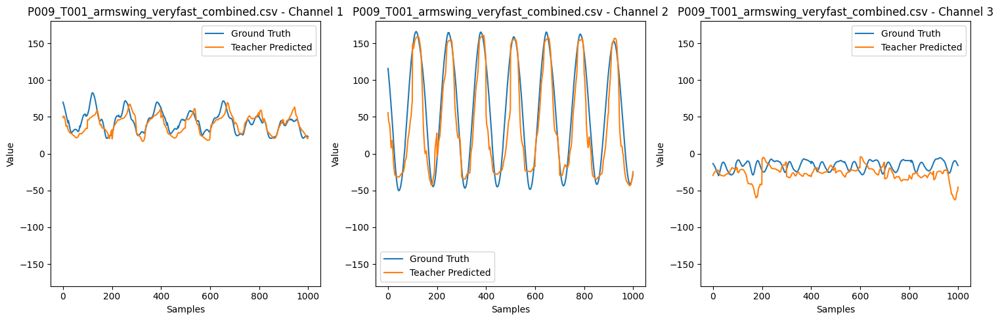

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_slow_combined.csv


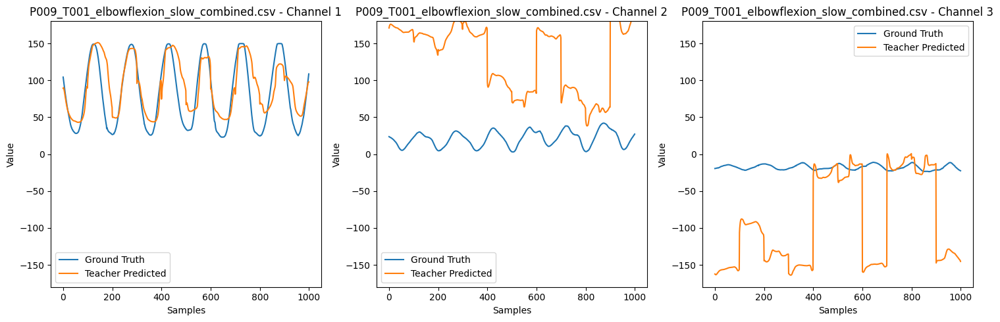

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T001_elbowflexion_normal_combined.csv


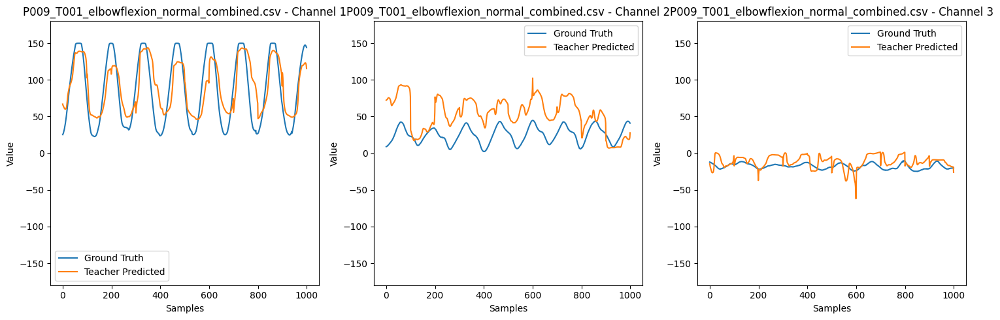

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_elbowflexion_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_elbowflexion_fast_combined.csv


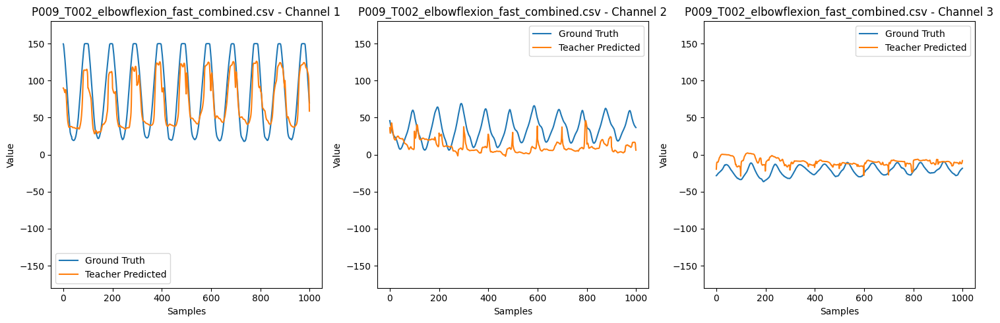

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_slow_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_slow_combined.csv


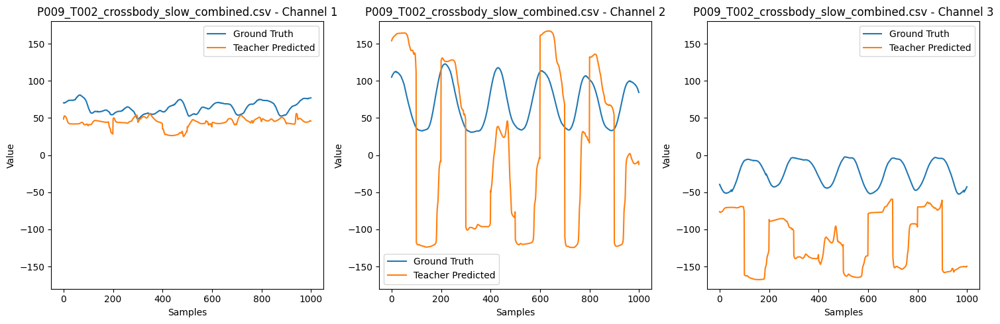

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_normal_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_normal_combined.csv


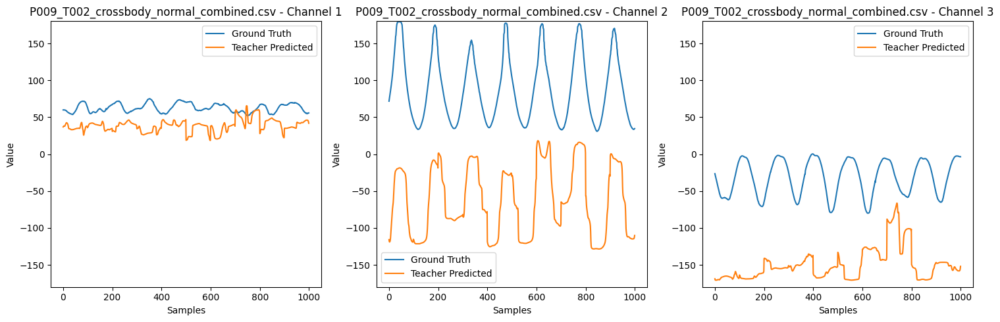

Processing file: /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_fast_combined.csv
processing file /content/MyDrive/MyDrive/sd_datacollection_v2/subject_9/combined/P009_T002_crossbody_fast_combined.csv


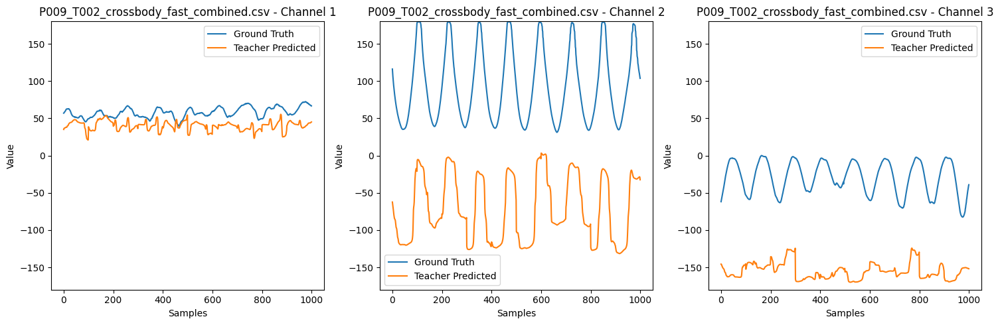

End of iteration
_________________________________________________________
Training subjects: ['subject_7']
Testing subject: subject_1
Dataset name: dataset_wl100_ol75_train['subject_7']_test['subject_1']
Training subjects: ['subject_7']
Testing subjects: ['subject_1']


Processing train patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_7:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T002_armSwing_slow_combined:   0%|          | 0/121 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_normal_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_armSwing_veryfast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_slow_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_elbowflexion_fast_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_slow_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_fast_combined:   0%|          | 0/120 [00:00<?, ?it/s]

Windowing data for subject_7_P007_T001_crossbody_normal_combined:   0%|          | 0/119 [00:00<?, ?it/s]

Processing test patients:   0%|          | 0/1 [00:00<?, ?it/s]

Processing sessions for subject_1:   0%|          | 0/10 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_fast_combined:   0%|          | 0/130 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_slow_combined:   0%|          | 0/129 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_fast_combined:   0%|          | 0/124 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_elbowflexion_normal_combined:   0%|          | 0/127 [00:00<?, ?it/s]

Windowing data for subject_1_P001_T001_crossbody_normal_combined:   0%|          | 0/131 [00:00<?, ?it/s]

In [ ]:
import itertools
import os
import glob
import torch
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

def load_or_reshard_data(config):
    dataset_name = config.generate_dataset_name()
    dataset_path = os.path.join(config.dataset_root, dataset_name)
    if not os.path.exists(dataset_path):
        data_sharder = DataSharder(config)
        data_sharder.load_data()
    else:
        print(f"Dataset {dataset_name} already exists. Skipping resharding.")

def evaluate_and_save_rmse_per_channel(model, loader):
    model.eval()
    yhat_5 = []
    test_target = []

    with torch.no_grad():
        for i, (data_acc, data_gyr, target, data_EMG) in enumerate(loader):
            output, x_1 = model(data_acc.to(device).float(), data_gyr.to(device).float(), data_EMG.to(device).float())
            yhat_5.append(output)
            test_target.append(target)

            # Clear memory
            del data_acc, data_gyr, data_EMG, target, output
            torch.cuda.empty_cache()

    yhat_4 = torch.cat(yhat_5, dim=0).detach().cpu().numpy()
    test_target = torch.cat(test_target, dim=0).detach().cpu().numpy()

    num_channels = yhat_4.shape[2]
    rmse_per_channel = np.zeros(num_channels)
    for channel in range(num_channels):
        rmse_per_channel[channel] = np.sqrt(mean_squared_error(test_target[:, :, channel], yhat_4[:, :, channel]))

    print(f'RMSE per channel: {rmse_per_channel}')

    rmse, p, Z_1, Z_2, Z_3 = RMSE_prediction(yhat_4, test_target, output_dim=3)
    return rmse_per_channel, rmse, p

subjects = ['subject_1', 'subject_2', 'subject_3', 'subject_6', 'subject_7', 'subject_9']

# Create directories for saving results and models
results_dir = '/content/MyDrive/MyDrive/models/Vanilla_SD_csv_RMSE_gridsearchtraining_smalldataset'
os.makedirs(results_dir, exist_ok=True)

def plot_and_display_loss_curves(train_losses, val_losses, num_channels):
    plt.figure(figsize=(10, 5))
    plt.plot([np.mean(epoch) for epoch in train_losses], label='Training Loss')
    plt.plot([np.mean(epoch) for epoch in val_losses], label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Curves')
    plt.legend()
    plt.grid(True)
    plt.show()

    plt.figure(figsize=(10, 5))

    # Plot individual channel losses
    for channel in range(num_channels):
        plt.plot([epoch[channel] for epoch in train_losses], label=f'Training Loss Channel {channel + 1}')
        plt.plot([epoch[channel] for epoch in val_losses], label=f'Validation Loss Channel {channel + 1}',linestyle="dashed")

    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'Training and Validation Loss Curves for Channel {channel + 1}')
    plt.legend()
    plt.grid(True)
    plt.show()

# Grid search over all combinations of training and testing subjects
results = []

# Generate all unique combinations of subjects
for subset_size in range(1, len(subjects)):
    for combo in itertools.combinations(subjects, subset_size):
        train_subjects = list(combo)
        for test_subject in subjects:
            if test_subject not in train_subjects:
                config.train_subjects = train_subjects
                config.test_subjects = [test_subject]

                # Change dataset name in config
                config.dataset_name = config.generate_dataset_name()

                print(f'Training subjects: {train_subjects}')
                print(f'Testing subject: {test_subject}')
                print(f'Dataset name: {config.dataset_name}')
                # Data Sharding
                load_or_reshard_data(config)

                # Create datasets
                train_dataset = ImuJointPairDataset(config, split='train')
                test_dataset = ImuJointPairDataset(config, split='test')

                # Setup validation dataset
                train_dataset, val_dataset = train_test_split(train_dataset, test_size=0.1, random_state=42)

                # Setup dataloaders
                train_loader = DataLoader(train_dataset, batch_size=config.batch_size, shuffle=True)
                val_loader = DataLoader(val_dataset, batch_size=config.batch_size, shuffle=False)
                test_loader = DataLoader(test_dataset, batch_size=config.batch_size, shuffle=False)

                # Train the model
                model = teacher(
                    input_acc=len(config.channels_imu_acc),
                    input_gyr=len(config.channels_imu_gyr),
                    input_emg=len(config.channels_emg)
                )
                model_path = os.path.join(results_dir, f'teacher_model_train_{train_subjects}_test_{test_subject}.pth')
                trained_model, train_losses, val_losses = train_teacher(device, train_loader, val_loader, config.lr, config.epochs, model, filename=model_path)

                # Load the trained model
                trained_model.load_state_dict(torch.load(model_path))
                trained_model.to(device)
                trained_model.eval()

                # Evaluate the model
                print("________________________________\nTraining set metrics")
                train_results = evaluate_and_save_rmse_per_channel(trained_model, train_loader)
                print("________________________________\nValidation set metrics")
                val_results = evaluate_and_save_rmse_per_channel(trained_model, val_loader)
                print("________________________________\nTest set metrics")
                test_results = evaluate_and_save_rmse_per_channel(trained_model, test_loader)

                # Save individual CSVs for model performance
                train_results_df = pd.DataFrame({
                    'rmse_per_channel': train_results[0],
                    'train_rmse': train_results[1],
                    'train_p': train_results[2]
                })
                train_results_df.to_csv(os.path.join(results_dir, f'train_results_{train_subjects}_test_{test_subject}.csv'), index=False)

                val_results_df = pd.DataFrame({
                    'rmse_per_channel': val_results[0],
                    'val_rmse': val_results[1],
                    'val_p': val_results[2]
                })
                val_results_df.to_csv(os.path.join(results_dir, f'val_results_{train_subjects}_test_{test_subject}.csv'), index=False)

                test_results_df = pd.DataFrame({
                    'rmse_per_channel': test_results[0],
                    'test_rmse': test_results[1],
                    'test_p': test_results[2]
                })
                test_results_df.to_csv(os.path.join(results_dir, f'test_results_{train_subjects}_test_{test_subject}.csv'), index=False)

                # Display loss curves
                plot_and_display_loss_curves(train_losses, val_losses, len(config.channels_joints))

                # Process files for the current test subject
                combined_folder_path = f'/content/MyDrive/MyDrive/sd_datacollection_v2/{test_subject}/combined/'
                file_paths = glob.glob(os.path.join(combined_folder_path, '*.csv'))
                print(f'Found {len(file_paths)} files for processing.')

                for file_path in file_paths:
                    print(f'Processing file: {file_path}')
                    process_file(file_path, trained_model)

                results.append({
                    'train_subjects': train_subjects,
                    'test_subject': test_subject,
                    'train_rmse_per_channel': train_results[0],
                    'train_results': train_results[1:],
                    'val_rmse_per_channel': val_results[0],
                    'val_results': val_results[1:],
                    'test_rmse_per_channel': test_results[0],
                    'test_results': test_results[1:]
                })

                print("End of iteration\n_________________________________________________________")

# Save the overall results
results_df = pd.DataFrame(results)
save_path = os.path.join(results_dir, 'grid_search_results.csv')
results_df.to_csv(save_path, index=False)
